In [44]:
cd ~/MultiFidelity-ProcessOpt/Perovskites/

/cephfs/volumes/hpc_home/k23070952/a774a32b-b8f8-42f8-b661-406a5dd49fd8/MultiFidelity-ProcessOpt/Perovskites


In [45]:
import torch

if torch.cuda.is_available():
    print("CUDA(GPU) 사용 가능합니다.")
    device = torch.device("cuda")
else:
    print("CUDA(GPU) 사용 불가, CPU 사용합니다.")
    device = torch.device("cpu")


CUDA(GPU) 사용 가능합니다.


In [46]:
#!/usr/bin/env python

import json
import pickle
import numpy as np
import pandas as pd
from copy import deepcopy

from olympus.datasets import Dataset
from olympus.objects import (
	ParameterContinuous,
	ParameterDiscrete, 
	ParameterCategorical, 
	ParameterVector
)
from olympus.campaigns import ParameterSpace, Campaign

from atlas.planners.multi_fidelity.planner import MultiFidelityPlanner



In [47]:
# config
dataset = Dataset(kind='perovskites')
NUM_RUNS = 1
# BUDGET = 30
COST_BUDGET = 50 # 200.
NUM_INIT_DESIGN = 10
NUM_CHEAP = 8

# lookup table
# organic --> cation --> anion --> bandgap_hse06/bandgap_gga
LOOKUP = pickle.load(open('0.Data/lookup_table.pkl', 'rb'))
# print(lookup.keys())
# print(lookup['Ethylammonium']['Ge']['F'].keys())



In [48]:
def measure_from_label(label_arr, s, label_maps, LOOKUP):
    """
    label_arr: [organic_label, cation_label, anion_label]
    s: 0.1 or 1.0 (fidelity)
    label_maps: {'organic': {...}, 'cation': {...}, 'anion': {...}}
    LOOKUP: 전체 lookup table
    """
    # 1. label_maps 역변환 사전 생성
    reverse_maps = {
        "organic": {v: k for k, v in label_maps["organic"].items()},
        "cation": {v: k for k, v in label_maps["cation"].items()},
        "anion": {v: k for k, v in label_maps["anion"].items()},
    }
    # 2. label에서 원래 카테고리명으로 변환
    organic = reverse_maps["organic"][int(label_arr[0])]
    cation = reverse_maps["cation"][int(label_arr[1])]
    anion = reverse_maps["anion"][int(label_arr[2])]

    # 3. 기존 measure 함수와 동일
    if s == 1.0:
        measurement = np.amin(
            LOOKUP[organic.capitalize()][cation][anion]['bandgap_hse06']
        )
    elif s == 0.1:
        measurement = np.amin(
            LOOKUP[organic.capitalize()][cation][anion]['bandgap_gga']
        )
    else:
        raise ValueError("s(fidelity)는 0.1 또는 1.0만 가능합니다.")
    return measurement

def get_min_hse06_bandgap(param_space):
	organic_options = [o.capitalize() for o in param_space[1].options]
	cation_options = [o.capitalize() for o in param_space[2].options]
	anion_options = [o.capitalize() for o in param_space[3].options]

	hse06_bandgaps = []
	for organic_option in organic_options:
		for cation_option in cation_options:
			for anion_option in anion_options:
				hse06_bandgaps.append(
					np.amin(
						LOOKUP[organic_option][cation_option][anion_option]['bandgap_hse06']
					)
				)
	min_hse06_bandgap = np.amin(hse06_bandgaps)
	return min_hse06_bandgap

def compute_cost(params):
	costs = params[:,0].astype(float)
	return np.sum(costs)



In [49]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

class TransferLearningDNN:
    def __init__(self, input_dim, hidden_dim=64, device='cpu'):
        self.input_dim = input_dim
        self.device = device
        self.hidden_dim = hidden_dim
        self.pretrain_losses = []
        self.finetune_losses = []

        # feature extractor (hidden layers)
        self.feature_net = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
        ).to(device)
        # 임시 선형 출력층 (bias=False는 선택)
        self.out_layer = nn.Linear(hidden_dim, 1, bias=False).to(device)

        # 최종 전체 모델
        self.model = nn.Sequential(self.feature_net, self.out_layer)

        self.feature_net = self.feature_net.float()
        self.out_layer = self.out_layer.float()
        self.model = self.model.float()

    def pretrain(self, X_low, y_low, epochs=50, lr=1e-3, verbose=False):
        # low-fidelity 데이터로 선학습
        self.pretrain_losses = []
        X_low = np.asarray(X_low, dtype=np.float32)  # ★ float32로 강제 변환
        y_low = np.asarray(y_low, dtype=np.float32).flatten()  # ★ float32로 강제 변환
        X_tensor = torch.tensor(X_low, dtype=torch.float32).to(self.device)
        y_tensor = torch.tensor(y_low, dtype=torch.float32).view(-1, 1).to(self.device)
        optimizer = optim.Adam(list(self.feature_net.parameters()) + list(self.out_layer.parameters()), lr=lr)
        loss_fn = nn.MSELoss()

        self.model.train()
        for epoch in range(epochs):
            optimizer.zero_grad()
            features = self.feature_net(X_tensor)
            pred = self.out_layer(features)
            loss = loss_fn(pred, y_tensor)
            loss.backward()
            optimizer.step()
            self.pretrain_losses.append(loss.item())
            if verbose and (epoch+1) % 50 == 0:
                print(f'[Pretrain] Epoch {epoch+1}: Loss {loss.item():.4f}')

    def finetune(self, X_high, y_high, epochs=50, lr=1e-4, verbose=False):
        self.finetune_losses = []
        X_high = np.asarray(X_high, dtype=np.float32)  # ★ float32로 강제 변환
        y_high = np.asarray(y_high, dtype=np.float32).flatten()  # ★ float32로 강제 변환
        X_tensor = torch.tensor(X_high, dtype=torch.float32).to(self.device)
        y_tensor = torch.tensor(y_high, dtype=torch.float32).view(-1, 1).to(self.device)
        optimizer = optim.Adam(list(self.feature_net.parameters()) + list(self.out_layer.parameters()), lr=lr)
        loss_fn = nn.MSELoss()
        self.model.train()
        for epoch in range(epochs):
            optimizer.zero_grad()
            features = self.feature_net(X_tensor)
            pred = self.out_layer(features)
            loss = loss_fn(pred, y_tensor)
            loss.backward()
            optimizer.step()
            self.finetune_losses.append(loss.item())
            if verbose and (epoch+1) % 20 == 0:
                print(f'[Finetune] Epoch {epoch+1}: Loss {loss.item():.4f}')

    def predict(self, X):
        X = np.asarray(X, dtype=np.float32)  # ★ float32로 강제 변환
        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        self.model.eval()
        with torch.no_grad():
            features = self.feature_net(X_tensor)
            y_pred = self.out_layer(features).cpu().numpy().flatten()
        return y_pred

    def extract_features(self, X):
        X = np.asarray(X, dtype=np.float32)  # ★ float32로 강제 변환
        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        self.model.eval()
        with torch.no_grad():
            features = self.feature_net(X_tensor).cpu().numpy()
        return features


    def get_fitness_func(self, y_best=None, xi=0.01):
        def fitness(x):
            mu = self.predict(np.array([x]))[0]
            if y_best is not None:
                return -(y_best - mu - xi)  # maximize EI → minimize -EI
            else:
                return mu
        return fitness


In [50]:
param_space = {
    "organic": [
        "ethylammonium", "propylammonium", "butylammonium", "isopropylammonium",
        "dimethylammonium", "acetamidinium", "methylammonium", "guanidinium",
        "hydroxylammonium", "formamidinium", "tetramethylammonium", "hydrazinium",
        "ammonium", "trimethylammonium", "azetidinium", "imidazolium"
    ],
    "cation": ["Ge", "Sn", "Pb"],
    "anion": ["F", "Cl", "Br", "I"]
}
label_maps = {
    key: {val: idx for idx, val in enumerate(vals, 1)}   # 1부터 시작하고 싶으면 enumerate(..., 1)
    for key, vals in param_space.items()
}
label_maps

{'organic': {'ethylammonium': 1,
  'propylammonium': 2,
  'butylammonium': 3,
  'isopropylammonium': 4,
  'dimethylammonium': 5,
  'acetamidinium': 6,
  'methylammonium': 7,
  'guanidinium': 8,
  'hydroxylammonium': 9,
  'formamidinium': 10,
  'tetramethylammonium': 11,
  'hydrazinium': 12,
  'ammonium': 13,
  'trimethylammonium': 14,
  'azetidinium': 15,
  'imidazolium': 16},
 'cation': {'Ge': 1, 'Sn': 2, 'Pb': 3},
 'anion': {'F': 1, 'Cl': 2, 'Br': 3, 'I': 4}}

In [51]:
import numpy as np

def sample_param_space(param_space, n_samples, random_state=None):
    rng = np.random.default_rng(random_state)
    param_names = list(param_space.keys())
    samples = []
    for _ in range(n_samples):
        sample = {}
        for key, opts in param_space.items():
            if isinstance(opts, (list, tuple)) and len(opts) > 0 and isinstance(opts[0], (str, int)):  # 범주형
                sample[key] = rng.choice(opts)
            elif isinstance(opts, tuple) and len(opts) == 2 and all(isinstance(x, (int, float)) for x in opts):  # 연속형
                low, high = opts
                sample[key] = float(rng.uniform(low, high))
            else:
                raise ValueError(f"Unknown parameter type for {key}: {opts}")
        samples.append(sample)
    return samples


In [52]:
# NUM_INIT_DESIGN = 10  # 원하는 개수로 지정

# param_space는 이전 단계에서 정의한 딕셔너리 그대로 사용

init_samples = sample_param_space(param_space, NUM_INIT_DESIGN, random_state=42)
for s in init_samples:
    print(s)


{'organic': 'propylammonium', 'cation': 'Pb', 'anion': 'Br'}
{'organic': 'guanidinium', 'cation': 'Sn', 'anion': 'I'}
{'organic': 'propylammonium', 'cation': 'Pb', 'anion': 'F'}
{'organic': 'propylammonium', 'cation': 'Sn', 'anion': 'I'}
{'organic': 'hydrazinium', 'cation': 'Pb', 'anion': 'Br'}
{'organic': 'ammonium', 'cation': 'Sn', 'anion': 'F'}
{'organic': 'trimethylammonium', 'cation': 'Sn', 'anion': 'Br'}
{'organic': 'acetamidinium', 'cation': 'Ge', 'anion': 'I'}
{'organic': 'ammonium', 'cation': 'Sn', 'anion': 'Cl'}
{'organic': 'trimethylammonium', 'cation': 'Sn', 'anion': 'Cl'}


In [53]:
init_samples

[{'organic': 'propylammonium', 'cation': 'Pb', 'anion': 'Br'},
 {'organic': 'guanidinium', 'cation': 'Sn', 'anion': 'I'},
 {'organic': 'propylammonium', 'cation': 'Pb', 'anion': 'F'},
 {'organic': 'propylammonium', 'cation': 'Sn', 'anion': 'I'},
 {'organic': 'hydrazinium', 'cation': 'Pb', 'anion': 'Br'},
 {'organic': 'ammonium', 'cation': 'Sn', 'anion': 'F'},
 {'organic': 'trimethylammonium', 'cation': 'Sn', 'anion': 'Br'},
 {'organic': 'acetamidinium', 'cation': 'Ge', 'anion': 'I'},
 {'organic': 'ammonium', 'cation': 'Sn', 'anion': 'Cl'},
 {'organic': 'trimethylammonium', 'cation': 'Sn', 'anion': 'Cl'}]

In [54]:
def assign_fidelities(n_samples, high_ratio=0.11111, random_state=None):
    """
    전체 n_samples 중 high_ratio 만큼만 high-fidelity(1.0), 나머지는 low-fidelity(0.1)로 할당
    """
    rng = np.random.default_rng(random_state)
    n_high = max(1, int(round(n_samples * high_ratio)))
    n_low = n_samples - n_high
    fids = [1.0]*n_high + [0.1]*n_low
    rng.shuffle(fids)
    return fids

measurements = []
for params, s in zip(init_samples, assign_fidelities(NUM_INIT_DESIGN, high_ratio=0.11111, random_state=42)):
    if s == 1.0:
        measurement = np.amin(
            LOOKUP[params['organic'].capitalize()][params['cation']][params['anion']]['bandgap_hse06']
        )
    else:
        measurement = np.amin(
            LOOKUP[params['organic'].capitalize()][params['cation']][params['anion']]['bandgap_gga']
        )
    # 관측값 저장
    measurements.append({"params": params, "s": s, "measurement": measurement})
measurements

[{'params': {'organic': 'propylammonium', 'cation': 'Pb', 'anion': 'Br'},
  's': 0.1,
  'measurement': 2.1145},
 {'params': {'organic': 'guanidinium', 'cation': 'Sn', 'anion': 'I'},
  's': 0.1,
  'measurement': 1.0856},
 {'params': {'organic': 'propylammonium', 'cation': 'Pb', 'anion': 'F'},
  's': 1.0,
  'measurement': 5.2155},
 {'params': {'organic': 'propylammonium', 'cation': 'Sn', 'anion': 'I'},
  's': 0.1,
  'measurement': 1.3516},
 {'params': {'organic': 'hydrazinium', 'cation': 'Pb', 'anion': 'Br'},
  's': 0.1,
  'measurement': 2.3859},
 {'params': {'organic': 'ammonium', 'cation': 'Sn', 'anion': 'F'},
  's': 0.1,
  'measurement': 3.8068},
 {'params': {'organic': 'trimethylammonium', 'cation': 'Sn', 'anion': 'Br'},
  's': 0.1,
  'measurement': 1.7405},
 {'params': {'organic': 'acetamidinium', 'cation': 'Ge', 'anion': 'I'},
  's': 0.1,
  'measurement': 1.6986},
 {'params': {'organic': 'ammonium', 'cation': 'Sn', 'anion': 'Cl'},
  's': 0.1,
  'measurement': 1.8983},
 {'params': {

In [55]:
assign_fidelities(NUM_INIT_DESIGN, high_ratio=0.11111, random_state=42)

[0.1, 0.1, 1.0, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]

In [56]:

# 1. 라벨맵 생성
label_maps = {
    key: {val: idx for idx, val in enumerate(vals, 1)}   # 1부터 시작
    for key, vals in param_space.items()
}

# 2. df 변환 및 라벨 적용
df = pd.DataFrame([
    {**obs['params'], 's': obs['s'], 'measurement': obs['measurement']}
    for obs in measurements
])
for col in ['organic', 'cation', 'anion']:
    df[col + '_label'] = df[col].map(label_maps[col])

# 3. 모델 입력/출력 분리
ini_X = df[['organic_label', 'cation_label', 'anion_label', 's']].values
ini_y = df['measurement'].values

print(ini_X[:5])
print(ini_y[:5])

# s 값에 따라 분할
ini_X_low = ini_X[df['s'] == 0.1]
ini_y_low = ini_y[df['s'] == 0.1]

ini_X_high = ini_X[df['s'] == 1.0]
ini_y_high = ini_y[df['s'] == 1.0]


[[ 2.   3.   3.   0.1]
 [ 8.   2.   4.   0.1]
 [ 2.   3.   1.   1. ]
 [ 2.   2.   4.   0.1]
 [12.   3.   3.   0.1]]
[2.1145 1.0856 5.2155 1.3516 2.3859]


In [57]:

# ini_X_low, ini_X_high에서 s를 제외한 3개 컬럼만 남기기
ini_X_low = ini_X_low[:, :3]   # (N_low, 3)
ini_X_high = ini_X_high[:, :3] # (N_high, 3)
ini_X_low = np.asarray(ini_X_low, dtype=np.float32)
ini_X_high = np.asarray(ini_X_high, dtype=np.float32)
ini_y_low = np.asarray(ini_y_low, dtype=np.float32).flatten()
ini_y_high = np.asarray(ini_y_high, dtype=np.float32).flatten()

# 모델 학습
model = TransferLearningDNN(input_dim=ini_X_low.shape[1], hidden_dim=64, device='cpu')

if len(ini_X_low) > 0:
    model.pretrain(ini_X_low, ini_y_low, epochs=100, lr=1e-3, verbose=True)

if len(ini_X_high) > 0:
    model.finetune(ini_X_high, ini_y_high, epochs=50, lr=1e-3, verbose=True)


[Pretrain] Epoch 50: Loss 0.3969
[Pretrain] Epoch 100: Loss 0.3200
[Finetune] Epoch 20: Loss 1.7916
[Finetune] Epoch 40: Loss 0.2093


In [58]:
from pymoo.core.problem import Problem
from pymoo.algorithms.soo.nonconvex.ga import GA
from pymoo.optimize import minimize
import numpy as np

# 1. 최적화 대상 DNN을 objective로 쓰는 Problem 정의
class DNNProblem(Problem):
    def __init__(self, dnn, param_bounds):
        super().__init__(n_var=len(param_bounds), n_obj=1, xl=[b[0] for b in param_bounds], xu=[b[1] for b in param_bounds])
        self.dnn = dnn

    def _evaluate(self, X, out, *args, **kwargs):
        # DNN의 predict에 여러 샘플 X를 넣으면 shape=(n_pop, n_dim)
        y_pred = self.dnn.predict(X)
        out["F"] = y_pred

# # 2. 입력 범위 정의 (각 feature별 min/max)
# # (예: [organic_label, cation_label, anion_label, s])
# param_bounds = [
#     [1, 16],   # organic_label
#     [1, 3],    # cation_label
#     [1, 4],    # anion_label
# ]

# problem = DNNProblem(model, param_bounds)
# algorithm = GA(pop_size=32)

# # 3. GA로 최적화 실행
# res = minimize(
#     problem,
#     algorithm,
#     ('n_gen', 40), # 세대수/반복수, 늘릴수록 탐색 강함
#     verbose=True
# )

# # 4. 최적화된 추천점
# next_x = res.X
# print("추천점(입력):", next_x)
# print("모델 예측값:", model.predict([next_x]))

# # 실험적 추천을 위한 s(fidelity) 값도 next_x[-1]로 구분 가능
# # 정수 label로 변환 (round)
# next_x_label = [int(round(val)) for val in next_x]
# print("정수 label 추천점:", next_x_label)

In [59]:
def append_measurement_to_data(existing_X_low, existing_y_low,
                               existing_X_high, existing_y_high,
                               label_arr, s, label_maps, LOOKUP):
    """
    label_arr: [organic_label, cation_label, anion_label]
    s: 0.1 or 1.0 (fidelity)
    기존 데이터에 label_arr을 s에 따라 붙여주는 함수
    """
    # 1. 측정값 구하기
    measurement = measure_from_label(label_arr, s, label_maps, LOOKUP)
    
    # 2. 데이터 추가 (s는 X에 넣지 않으므로 3개만!)
    label_arr = np.array(label_arr, dtype=np.float32).reshape(1, -1)
    measurement = np.array([measurement], dtype=np.float32)

    if s == 0.1:
        existing_X_low = np.vstack([existing_X_low, label_arr]) if existing_X_low.size else label_arr
        existing_y_low = np.concatenate([existing_y_low, measurement]) if existing_y_low.size else measurement
    elif s == 1.0:
        existing_X_high = np.vstack([existing_X_high, label_arr]) if existing_X_high.size else label_arr
        existing_y_high = np.concatenate([existing_y_high, measurement]) if existing_y_high.size else measurement
    else:
        raise ValueError("s(fidelity)는 0.1 또는 1.0만 가능합니다.")

    return existing_X_low, existing_y_low, existing_X_high, existing_y_high

# # 추천 label이 [2, 3, 3], s=1.0이라고 가정
# ini_X_low, ini_y_low, ini_X_high, ini_y_high = append_measurement_to_data(
#     ini_X_low, ini_y_low, ini_X_high, ini_y_high,
#     next_x_label, 1.0, label_maps, LOOKUP
# )

In [21]:
import time
import itertools
### 1. 필수 함수 및 설정
# (여기 measure_from_label, append_measurement_to_data 등 위에서 만든 함수 모두 선언)

### 2. 초기 데이터 생성
NUM_INIT_DESIGN = 10
init_samples = sample_param_space(param_space, NUM_INIT_DESIGN, random_state=42)
init_fids = assign_fidelities(NUM_INIT_DESIGN, high_ratio=0.2, random_state=42)

measurements = []
for params, s in zip(init_samples, init_fids):
    measurement = measure_from_label(
        [label_maps['organic'][params['organic']],
         label_maps['cation'][params['cation']],
         label_maps['anion'][params['anion']]],
        s, label_maps, LOOKUP
    )
    measurements.append({"params": params, "s": s, "measurement": measurement})

# 데이터프레임 변환 및 라벨 적용
df = pd.DataFrame([
    {**obs['params'], 's': obs['s'], 'measurement': obs['measurement']}
    for obs in measurements
])
for col in ['organic', 'cation', 'anion']:
    df[col + '_label'] = df[col].map(label_maps[col])

ini_X = df[['organic_label', 'cation_label', 'anion_label', 's']].values
ini_y = df['measurement'].values

# s 값에 따라 분할 (X에서 s를 제거)
ini_X_low = ini_X[df['s'] == 0.1][:, :3]
ini_y_low = ini_y[df['s'] == 0.1]
ini_X_high = ini_X[df['s'] == 1.0][:, :3]
ini_y_high = ini_y[df['s'] == 1.0]


param_ranges = [
    range(1, 17),  # organic_label: 1~16
    range(1, 4),   # cation_label: 1~3
    range(1, 5),   # anion_label: 1~4
]


### 3. 루프 시작
timing_data = []
N_ITER = 10 # 원하는 반복 횟수
for iter_ in range(N_ITER):
    print(f"\n==== Iteration {iter_+1} ====")
    iter_start = time.time()   # ★★★ 타이밍 시작

    # (1) 모델 학습/업데이트
    model = TransferLearningDNN(input_dim=3, hidden_dim=64, device='cuda')
    if len(ini_X_low) > 0:
        model.pretrain(ini_X_low, ini_y_low, epochs=100, lr=1e-3, verbose=False)
    if len(ini_X_high) > 0:
        model.finetune(ini_X_high, ini_y_high, epochs=50, lr=1e-3, verbose=False)

    # (2) 그리드 서치로 추천점 찾기
    all_combinations = list(itertools.product(*param_ranges))  # 192개 조합

    X_grid = np.array(all_combinations, dtype=np.float32)  # shape: (192, 3)
    with torch.no_grad():
        X_tensor = torch.tensor(X_grid, dtype=torch.float32, device=model.device)
        y_pred = model.model(X_tensor).cpu().numpy().flatten()
        
    # 목적에 따라 min/max 선택 (예: 최소화면 argmin, 최대화면 argmax)
    best_idx = np.argmin(y_pred)  # 또는 np.argmax(y_pred)
    next_x_label = list(X_grid[best_idx].astype(int))
    print("추천 label:", next_x_label)

    # (3) Fidelity 할당 (예시: 8:1 비율로 선택)
    s = 0.1 if (iter_ % 9 != 0) else 1.0

    # (4) 실제 실험값(측정값) 얻기 및 데이터에 추가
    ini_X_low, ini_y_low, ini_X_high, ini_y_high = append_measurement_to_data(
        ini_X_low, ini_y_low, ini_X_high, ini_y_high,
        next_x_label, s, label_maps, LOOKUP
    )
    
    print(f"측정값: {measure_from_label(next_x_label, s, label_maps, LOOKUP):.4f} (fidelity={s})")

    iter_end = time.time()   # ★★★ 타이밍 끝
    time_taken = iter_end - iter_start
    print(f"Iteration {iter_+1} 소요 시간: {time_taken:.2f} 초")
    timing_data.append([0, iter_+1, time_taken])  # 0은 run_ix (실험 반복 번호)

# 전체 타이밍 데이터 저장
timing_df = pd.DataFrame(timing_data, columns=['run_ix', 'iter', 'time_taken'])
timing_df.to_csv('TL_timing_results_GridSearch.csv', index=False)



==== Iteration 1 ====
추천 label: [16, 1, 3]
측정값: 2.8815 (fidelity=1.0)
Iteration 1 소요 시간: 0.11 초

==== Iteration 2 ====
추천 label: [7, 1, 1]
측정값: 3.5371 (fidelity=0.1)
Iteration 2 소요 시간: 0.11 초

==== Iteration 3 ====
추천 label: [6, 1, 2]
측정값: 2.8878 (fidelity=0.1)
Iteration 3 소요 시간: 0.11 초

==== Iteration 4 ====
추천 label: [7, 1, 1]
측정값: 3.5371 (fidelity=0.1)
Iteration 4 소요 시간: 0.11 초

==== Iteration 5 ====
추천 label: [6, 1, 1]
측정값: 3.8145 (fidelity=0.1)
Iteration 5 소요 시간: 0.11 초

==== Iteration 6 ====
추천 label: [6, 1, 1]
측정값: 3.8145 (fidelity=0.1)
Iteration 6 소요 시간: 0.11 초

==== Iteration 7 ====
추천 label: [6, 1, 1]
측정값: 3.8145 (fidelity=0.1)
Iteration 7 소요 시간: 0.11 초

==== Iteration 8 ====
추천 label: [5, 1, 1]
측정값: 4.3686 (fidelity=0.1)
Iteration 8 소요 시간: 0.11 초

==== Iteration 9 ====
추천 label: [8, 1, 3]
측정값: 2.0910 (fidelity=0.1)
Iteration 9 소요 시간: 0.11 초

==== Iteration 10 ====
추천 label: [8, 1, 3]
측정값: 2.8760 (fidelity=1.0)
Iteration 10 소요 시간: 0.11 초


## DNN4GP

In [ ]:
import time

### 1. 필수 함수 및 설정
# (여기 measure_from_label, append_measurement_to_data 등 위에서 만든 함수 모두 선언)

### 2. 초기 데이터 생성
NUM_INIT_DESIGN = 10
init_samples = sample_param_space(param_space, NUM_INIT_DESIGN, random_state=42)
init_fids = assign_fidelities(NUM_INIT_DESIGN, high_ratio=0.2, random_state=42)

measurements = []
for params, s in zip(init_samples, init_fids):
    measurement = measure_from_label(
        [label_maps['organic'][params['organic']],
         label_maps['cation'][params['cation']],
         label_maps['anion'][params['anion']]],
        s, label_maps, LOOKUP
    )
    measurements.append({"params": params, "s": s, "measurement": measurement})

# 데이터프레임 변환 및 라벨 적용
df = pd.DataFrame([
    {**obs['params'], 's': obs['s'], 'measurement': obs['measurement']}
    for obs in measurements
])
for col in ['organic', 'cation', 'anion']:
    df[col + '_label'] = df[col].map(label_maps[col])

ini_X = df[['organic_label', 'cation_label', 'anion_label', 's']].values
ini_y = df['measurement'].values

# s 값에 따라 분할 (X에서 s를 제거)
ini_X_low = ini_X[df['s'] == 0.1][:, :3]
ini_y_low = ini_y[df['s'] == 0.1]
ini_X_high = ini_X[df['s'] == 1.0][:, :3]
ini_y_high = ini_y[df['s'] == 1.0]


param_ranges = [
    range(1, 17),  # organic_label: 1~16
    range(1, 4),   # cation_label: 1~3
    range(1, 5),   # anion_label: 1~4
]


### 3. 루프 시작
timing_data = []
N_ITER = 10 # 원하는 반복 횟수
for iter_ in range(N_ITER):
    print(f"\n==== Iteration {iter_+1} ====")
    iter_start = time.time()   # ★★★ 타이밍 시작

    # (1) 모델 학습/업데이트
    model = TransferLearningDNN(input_dim=3, hidden_dim=64, device='cuda')
    if len(ini_X_low) > 0:
        model.pretrain(ini_X_low, ini_y_low, epochs=100, lr=1e-3, verbose=False)
    if len(ini_X_high) > 0:
        model.finetune(ini_X_high, ini_y_high, epochs=50, lr=1e-3, verbose=False)

    # ---- [DNGO 확장] BLR 학습 ----
    # 모든 현재 데이터를 합치고 feature 추출
    X_all = np.vstack([ini_X_low, ini_X_high])
    y_all = np.concatenate([ini_y_low, ini_y_high])
    features_all = model.extract_features(X_all)
    # BLR 학습 (alpha/beta는 실험적으로 조절)
    blr = BayesianLinearRegression(alpha=1.0, beta=25.0)
    blr.fit(features_all, y_all)

    # (2) 그리드 서치로 추천점 찾기
    all_combinations = list(itertools.product(*param_ranges))  # 192개 조합
    X_grid = np.array(all_combinations, dtype=np.float32)

    # DNN 피처 추출
    features_grid = model.extract_features(X_grid)

    # BLR 예측
    y_pred = []
    y_std = []
    for phi in features_grid:
        mu, var = blr.predict(phi)
        y_pred.append(mu)
        y_std.append(np.sqrt(var))
    y_pred = np.array(y_pred)
    y_std = np.array(y_std)

    # EI 계산 (예시: 최소화 기준)
    from scipy.stats import norm
    y_best = np.min(y_all)
    def expected_improvement(mu, sigma, y_best):
        sigma = np.maximum(sigma, 1e-8)
        z = (y_best - mu) / sigma
        ei = (y_best - mu) * norm.cdf(z) + sigma * norm.pdf(z)
        return ei

    ei = expected_improvement(y_pred, y_std, y_best)
    best_idx = np.argmax(ei)  # EI가 가장 큰 점 추천
    next_x_label = list(X_grid[best_idx].astype(int))
    print("EI 기준 추천 label:", next_x_label)


    # (3) Fidelity 할당 (예시: 8:1 비율로 선택)
    s = 0.1 if (iter_ % 9 != 0) else 1.0

    # (4) 실제 실험값(측정값) 얻기 및 데이터에 추가
    ini_X_low, ini_y_low, ini_X_high, ini_y_high = append_measurement_to_data(
        ini_X_low, ini_y_low, ini_X_high, ini_y_high,
        next_x_label, s, label_maps, LOOKUP
    )
    
    print(f"측정값: {measure_from_label(next_x_label, s, label_maps, LOOKUP):.4f} (fidelity={s})")

    iter_end = time.time()   # ★★★ 타이밍 끝
    time_taken = iter_end - iter_start
    print(f"Iteration {iter_+1} 소요 시간: {time_taken:.2f} 초")
    timing_data.append([0, iter_+1, time_taken])  # 0은 run_ix (실험 반복 번호)

# 전체 타이밍 데이터 저장
timing_df = pd.DataFrame(timing_data, columns=['run_ix', 'iter', 'time_taken'])
timing_df.to_csv('TL_timing_results_GridSearch.csv', index=False)


## 정지조건추가

In [60]:
class BayesianLinearRegression:
    def __init__(self, alpha=1.0, beta=25.0):
        self.alpha = alpha
        self.beta = beta
    def fit(self, Phi, y):
        I = np.eye(Phi.shape[1])
        self.K = self.beta * Phi.T @ Phi + self.alpha * I
        self.K_inv = np.linalg.inv(self.K)
        self.m = self.beta * self.K_inv @ Phi.T @ y
    def predict(self, phi_x):
        mean = phi_x @ self.m
        var = phi_x @ self.K_inv @ phi_x.T + 1 / self.beta
        return mean, var

In [61]:
LOOKUP[organic.capitalize()][cation][anion]

{'anion': ['I', 'I', 'I', 'I', 'I', 'I'],
 'atomization_energy': [-4.7774, -4.7813, -4.7814, -4.7815, -4.784, -4.7856],
 'bandgap_gga': [1.6653, 1.5309, 1.5521, 1.6908, 2.2322, 2.302],
 'bandgap_hse06': [2.3723, 2.348, 2.3885, 2.5079, 3.0972, 3.1504],
 'cation': ['Pb', 'Pb', 'Pb', 'Pb', 'Pb', 'Pb'],
 'cation_formula': ['C3H5N2',
  'C3H5N2',
  'C3H5N2',
  'C3H5N2',
  'C3H5N2',
  'C3H5N2'],
 'cation_name': ['imidazolium',
  'imidazolium',
  'imidazolium',
  'imidazolium',
  'imidazolium',
  'imidazolium'],
 'cation_reference': ['B.Saparov et al., Chem. Rev. 116, 4558 (2016)',
  'B.Saparov et al., Chem. Rev. 116, 4558 (2016)',
  'B.Saparov et al., Chem. Rev. 116, 4558 (2016)',
  'B.Saparov et al., Chem. Rev. 116, 4558 (2016)',
  'B.Saparov et al., Chem. Rev. 116, 4558 (2016)',
  'B.Saparov et al., Chem. Rev. 116, 4558 (2016)'],
 'density': [3.7605, 3.8176, 3.817, 3.8191, 3.8868, 3.954],
 'hoip_id': ['1341', '1342', '1343', '1344', '1345', '1346'],
 'label': ['Imidazolium',
  'Imidazolium'

In [62]:
import pickle
import itertools
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from sklearn.metrics import r2_score, mean_absolute_error

LOOKUP = pickle.load(open('0.Data/lookup_table.pkl', 'rb'))

organic_options = ['ethylammonium', 'propylammonium', 'butylammonium', 'isopropylammonium', 'dimethylammonium', 'acetamidinium', 'methylammonium', 'guanidinium', 'hydroxylammonium', 'formamidinium', 'tetramethylammonium', 'hydrazinium', 'ammonium', 'trimethylammonium', 'azetidinium', 'imidazolium']
cation_options = ['Ge', 'Sn', 'Pb']
anion_options = ['F', 'Cl', 'Br', 'I']

all_results = []
for i, organic in enumerate(organic_options, 1):
    for j, cation in enumerate(cation_options, 1):
        for k, anion in enumerate(anion_options, 1):
            try:
                bandgap = np.amin(
                    LOOKUP[organic.capitalize()][cation][anion]['bandgap_hse06']
                )
                combo_label = f"{i},{j},{k}"
                all_results.append({
                    'combo': combo_label,
                    'bandgap': bandgap
                })
            except Exception as e:
                print(f"Skip: {organic}-{cation}-{anion} ({e})")
                continue

ori_gga_data = pd.DataFrame(all_results)
ori_gga_data


,combo,bandgap
0,"1,1,1",5.3704
1,"1,1,2",3.1393
2,"1,1,3",2.7138
3,"1,1,4",2.2338
4,"1,2,1",3.9789
...,...,...
187,"16,2,4",1.9179
188,"16,3,1",4.4501
189,"16,3,2",3.6158
190,"16,3,3",2.8641


In [63]:
min_idx = ori_gga_data['bandgap'].idxmin()
min_combo = ori_gga_data.loc[min_idx, 'combo']
min_bandgap = ori_gga_data.loc[min_idx, 'bandgap']
print(f"Lowest bandgap: {min_bandgap:.4f} (combo: {min_combo})")
min_combo

Lowest bandgap: 1.5249 (combo: 12,2,4)


'12,2,4'

In [69]:
def penalized_expected_improvement(mu, sigma, y_best, xi=0.01, penalty_scale=1.0, penalty_width=0.1):
    # 기본 EI 계산
    sigma = np.maximum(sigma, 1e-8)
    z = (y_best - mu - xi) / sigma
    ei = (y_best - mu - xi) * norm.cdf(z) + sigma * norm.pdf(z)
    # y_best 근처면 penalty 부여
    penalty = np.exp(-((mu - y_best)**2) / (2 * penalty_width**2))
    penalized_ei = ei - penalty_scale * penalty
    return penalized_ei

def expected_improvement(mu, sigma, y_best, xi=0.01):
            sigma = np.maximum(sigma, 1e-8)
            z = (y_best - mu - xi) / sigma
            ei = (y_best - mu - xi) * norm.cdf(z) + sigma * norm.pdf(z)
            return ei
        


==== Iteration 1 ====
EI-based recommended label: [16, 1, 4]


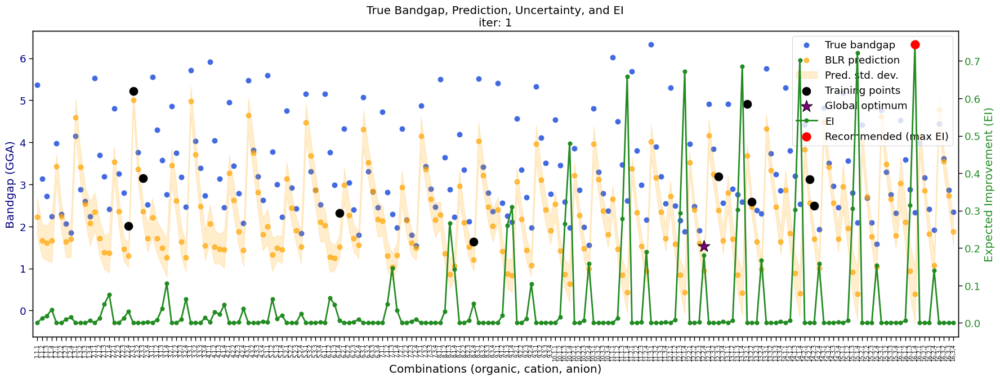

R² score: -0.5031
MAE: 1.1078


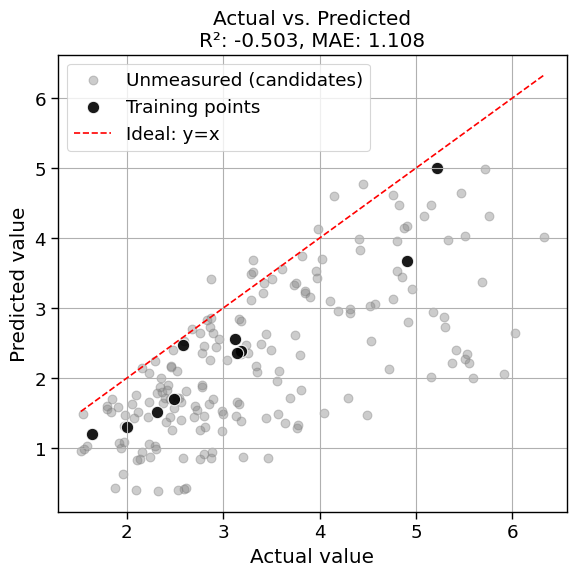

Measurement: 1.7434 (fidelity=0.1)
Cumulative cost: 0.1, best_so_far: inf

==== Iteration 2 ====
EI-based recommended label: [1, 1, 4]


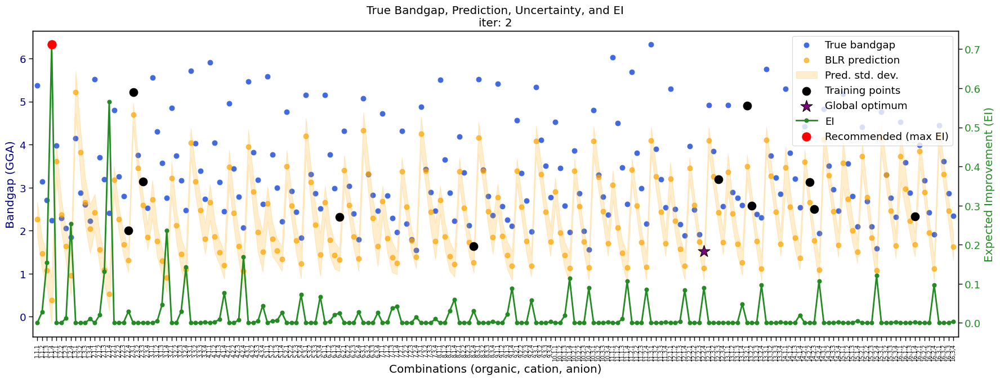

R² score: -0.1686
MAE: 1.0100


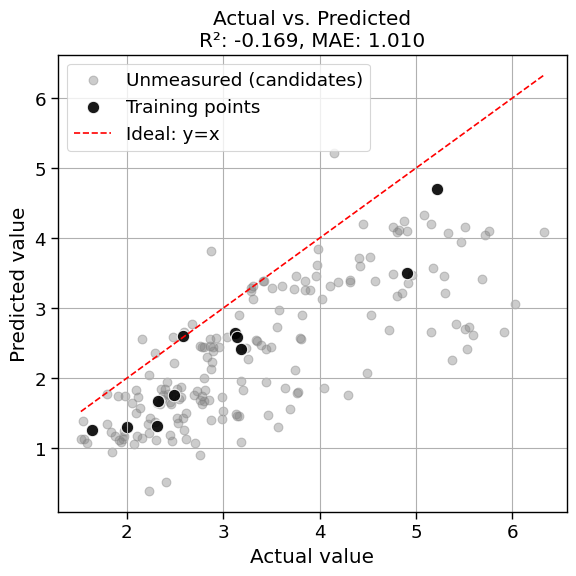

Measurement: 1.4809 (fidelity=0.1)
Cumulative cost: 0.2, best_so_far: inf

==== Iteration 3 ====
EI-based recommended label: [12, 1, 4]


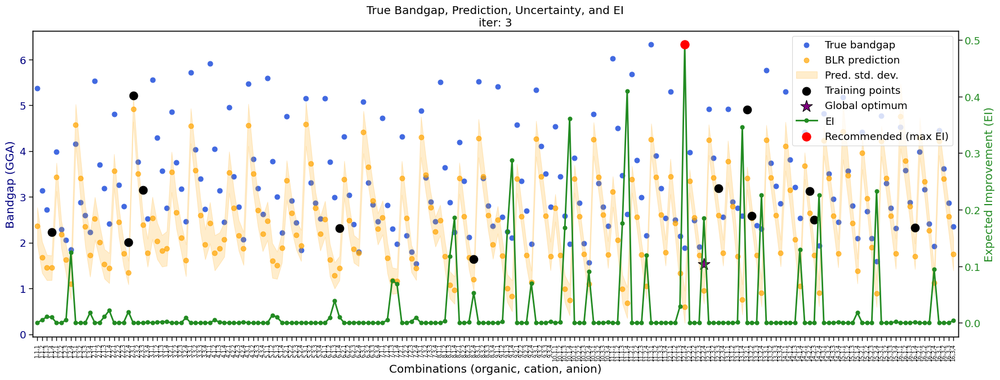

R² score: -0.0396
MAE: 0.8969


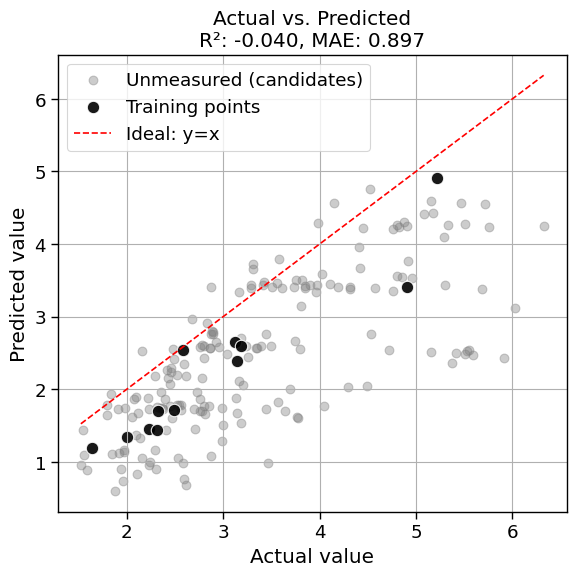

Measurement: 1.3701 (fidelity=0.1)
Cumulative cost: 0.30000000000000004, best_so_far: inf

==== Iteration 4 ====
EI-based recommended label: [10, 1, 4]


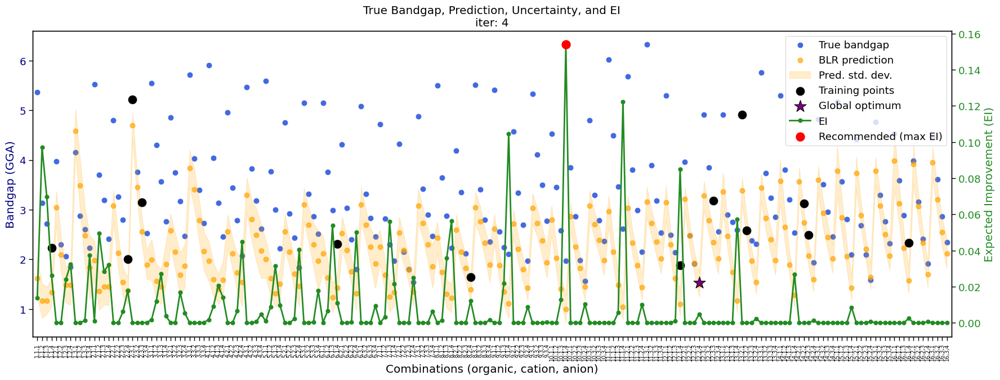

R² score: -0.4684
MAE: 1.0916


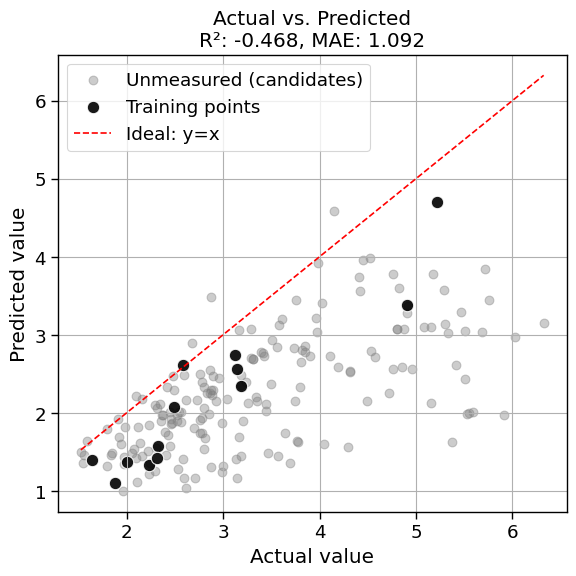

Measurement: 1.4190 (fidelity=0.1)
Cumulative cost: 0.4, best_so_far: inf

==== Iteration 5 ====
EI-based recommended label: [1, 2, 4]


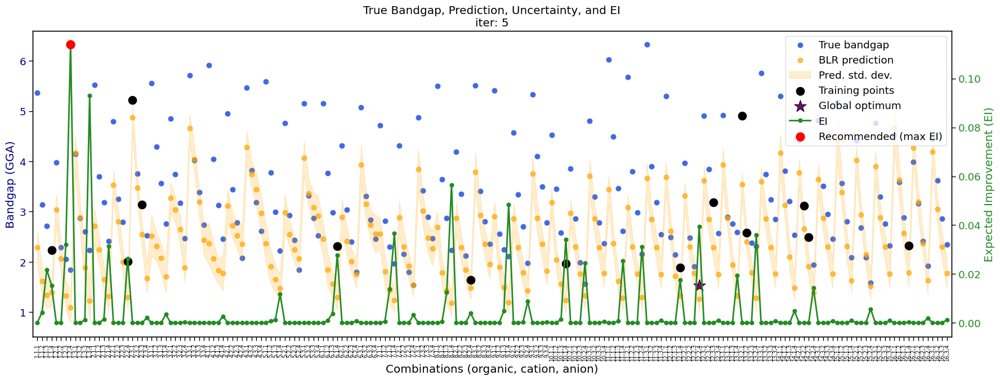

R² score: -0.0129
MAE: 0.8962


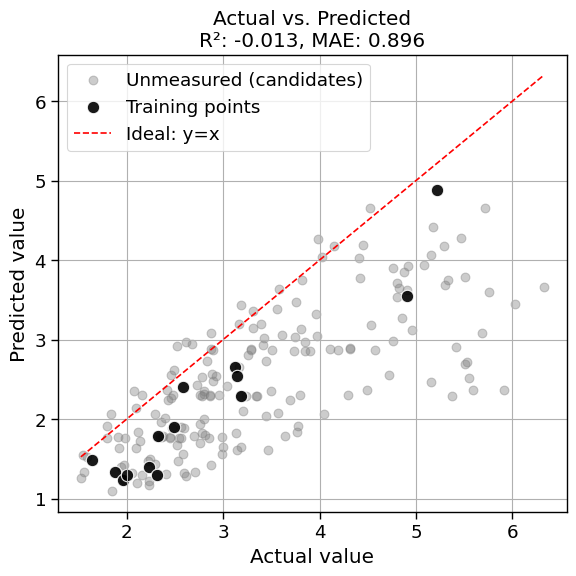

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 0.5, best_so_far: inf

==== Iteration 6 ====
EI-based recommended label: [3, 1, 4]


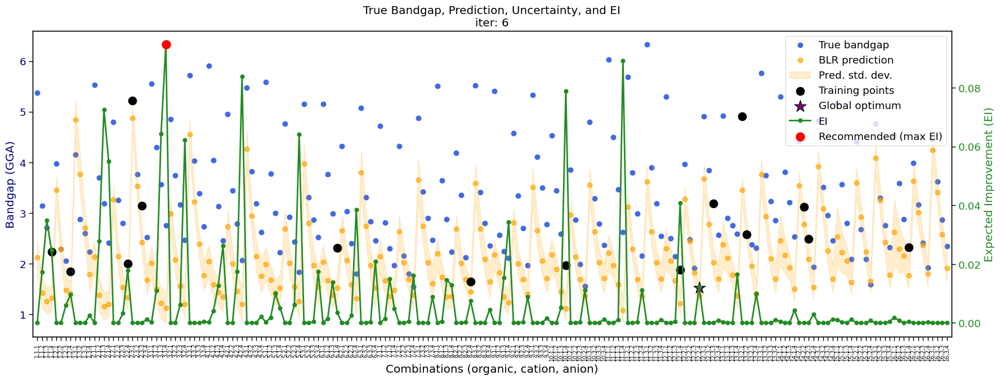

R² score: -0.5665
MAE: 1.1577


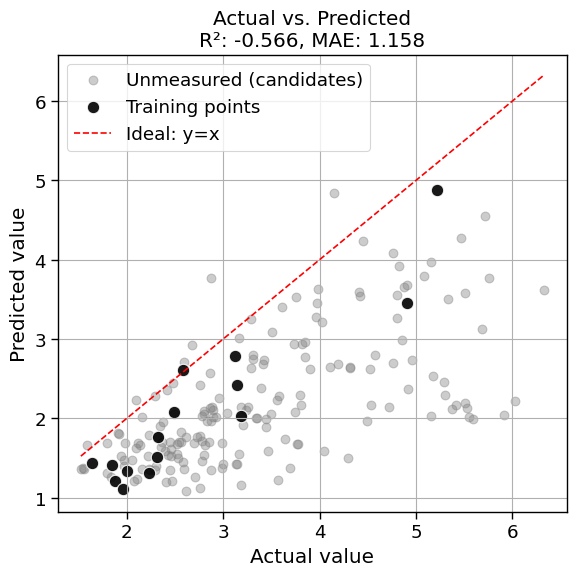

Measurement: 1.9921 (fidelity=0.1)
Cumulative cost: 0.6, best_so_far: inf

==== Iteration 7 ====
EI-based recommended label: [1, 3, 4]


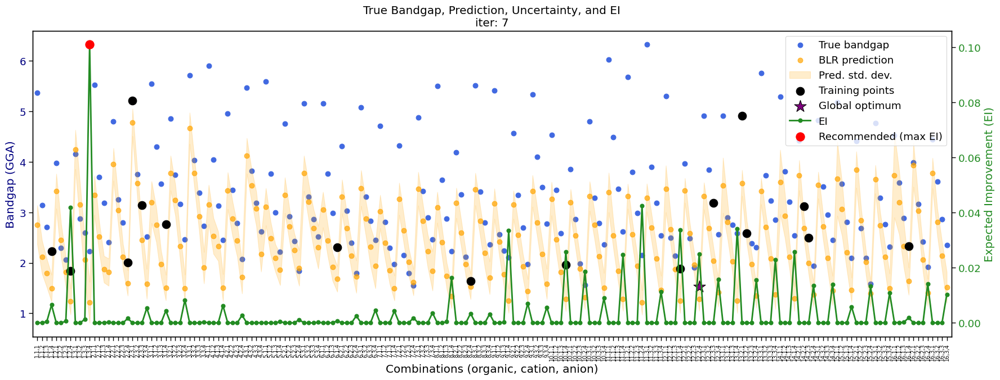

R² score: 0.1179
MAE: 0.8726


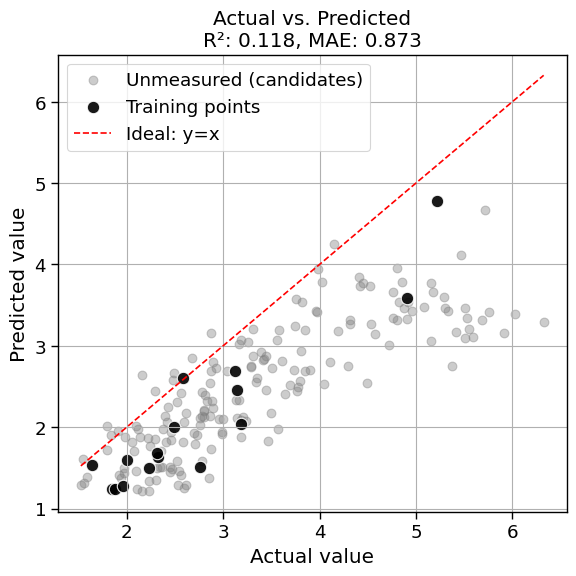

Measurement: 1.3945 (fidelity=0.1)
Cumulative cost: 0.7, best_so_far: inf

==== Iteration 8 ====
EI-based recommended label: [8, 2, 4]


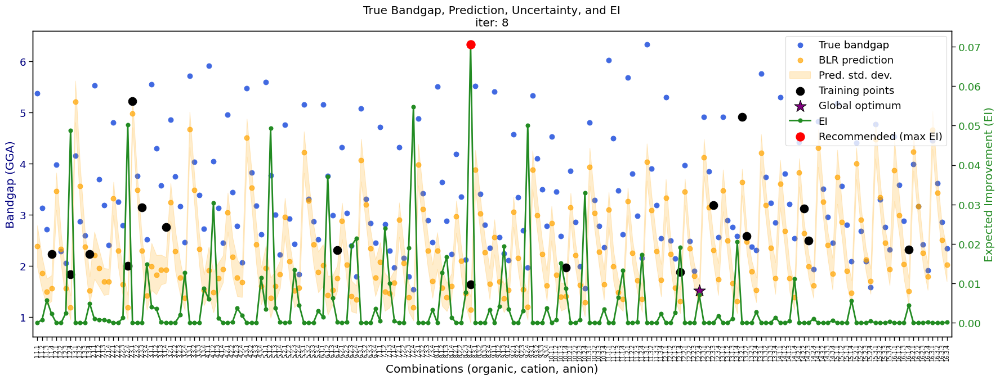

R² score: -0.2179
MAE: 0.9962


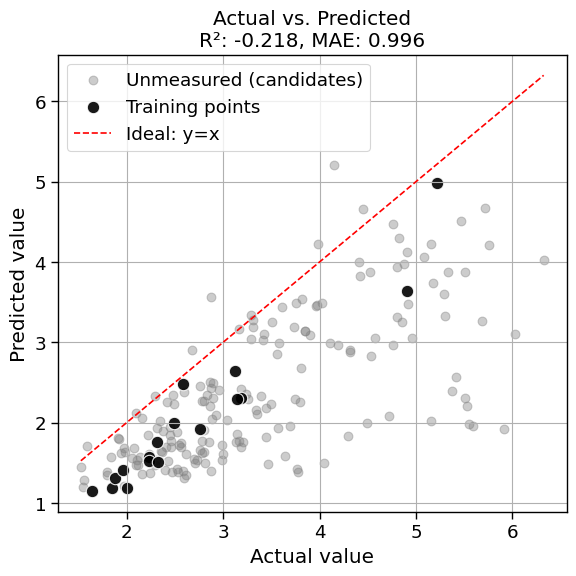

Measurement: 1.6399 (fidelity=1.0)
Cumulative cost: 1.7, best_so_far: 1.6399

==== Iteration 9 ====
EI-based recommended label: [10, 2, 4]


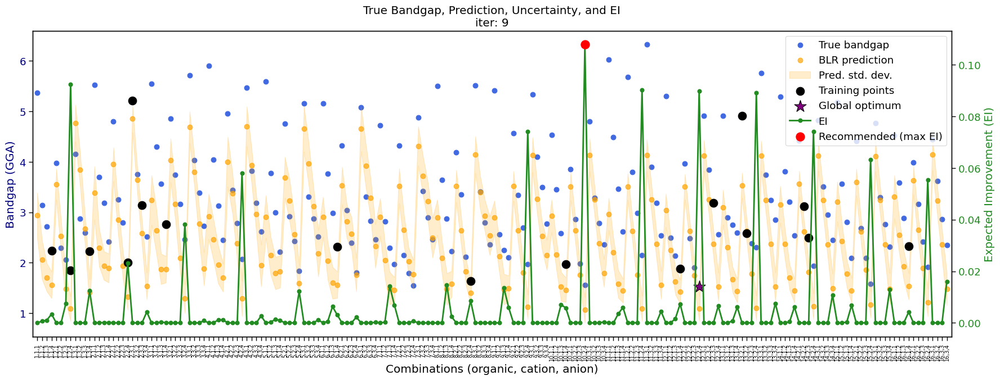

R² score: 0.1404
MAE: 0.8524


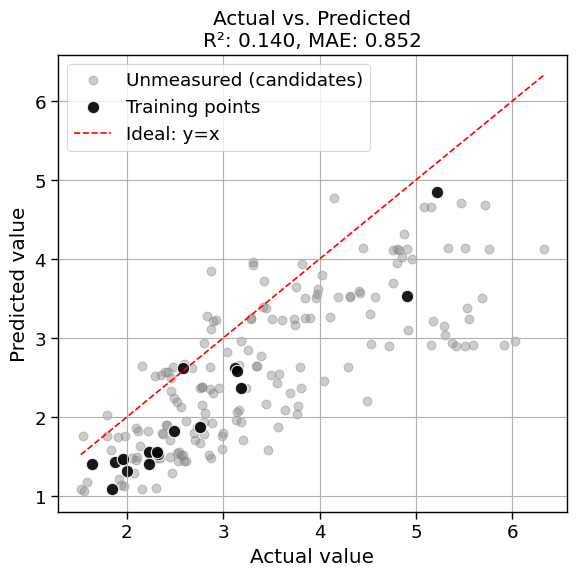

Measurement: 1.0637 (fidelity=0.1)
Cumulative cost: 1.8, best_so_far: 1.6399

==== Iteration 10 ====
EI-based recommended label: [5, 1, 2]


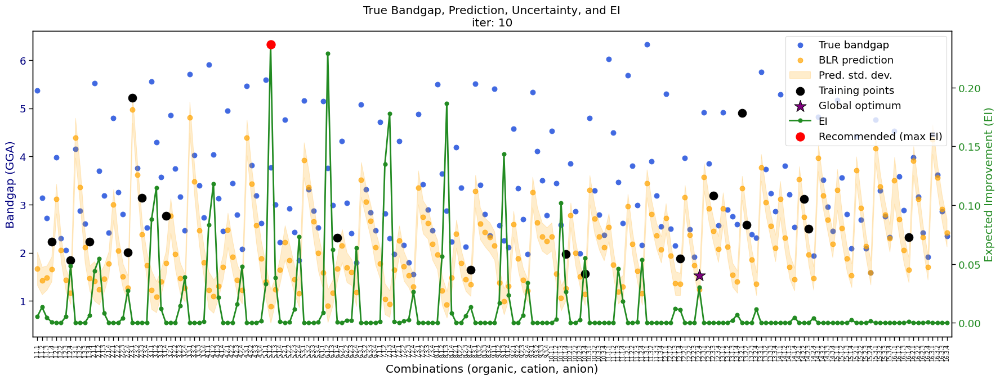

R² score: -0.7455
MAE: 1.1581


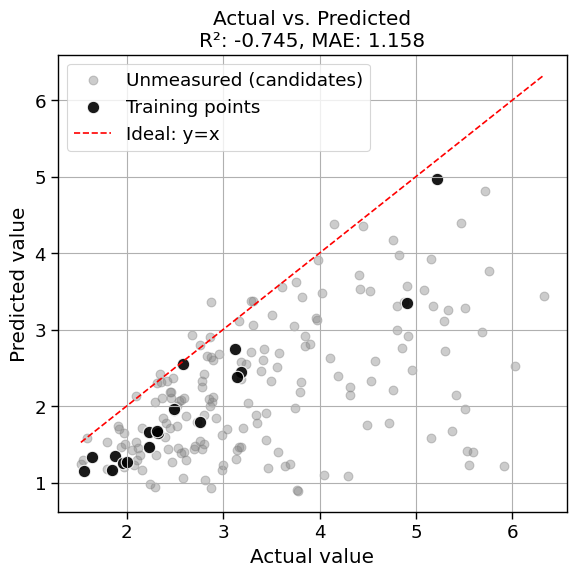

Measurement: 2.8910 (fidelity=0.1)
Cumulative cost: 1.9000000000000001, best_so_far: 1.6399

==== Iteration 11 ====
EI-based recommended label: [4, 3, 4]


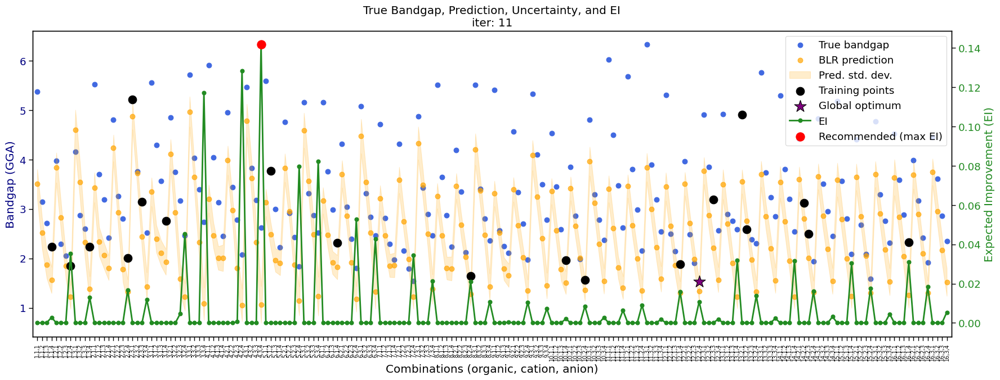

R² score: 0.2105
MAE: 0.8420


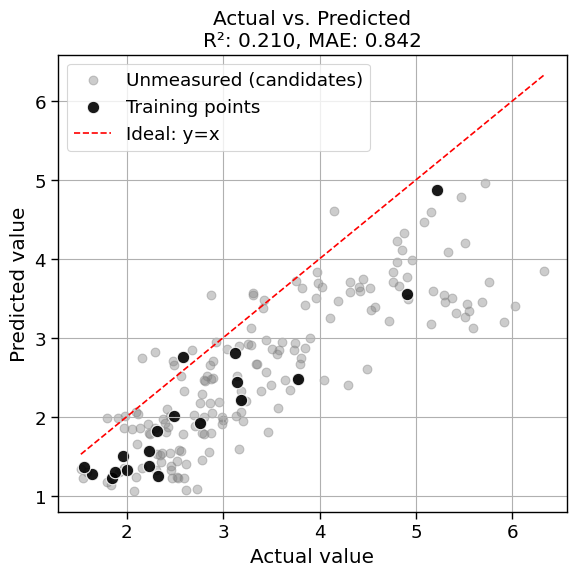

Measurement: 1.6849 (fidelity=0.1)
Cumulative cost: 2.0, best_so_far: 1.6399

==== Iteration 12 ====
EI-based recommended label: [16, 2, 4]


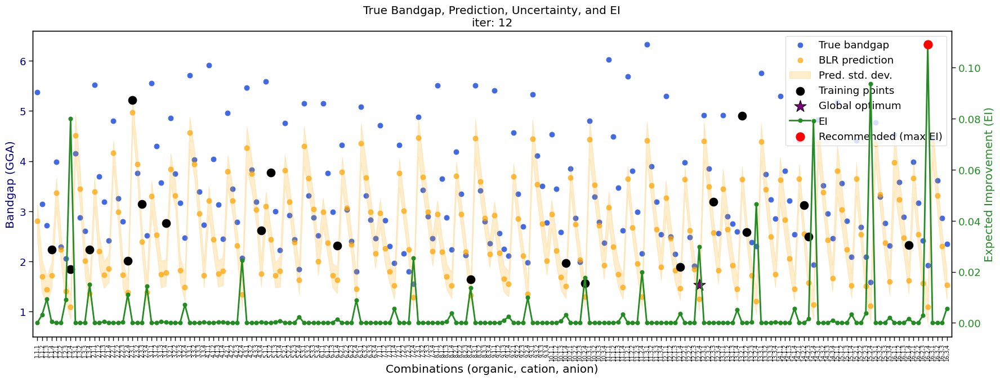

R² score: 0.2573
MAE: 0.7736


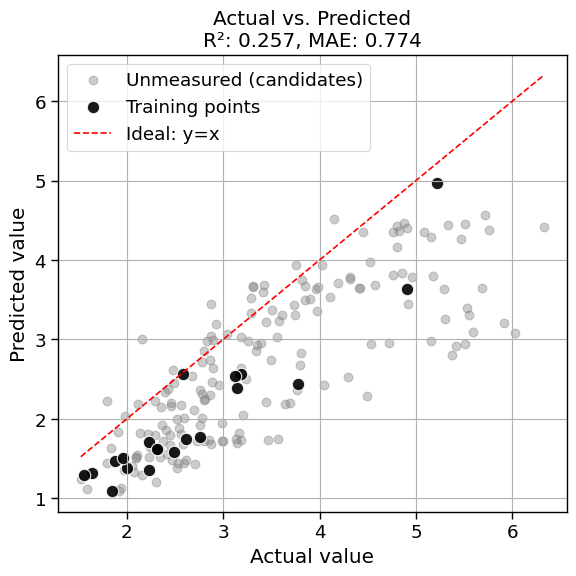

Measurement: 1.3734 (fidelity=0.1)
Cumulative cost: 2.1, best_so_far: 1.6399

==== Iteration 13 ====
EI-based recommended label: [4, 2, 4]


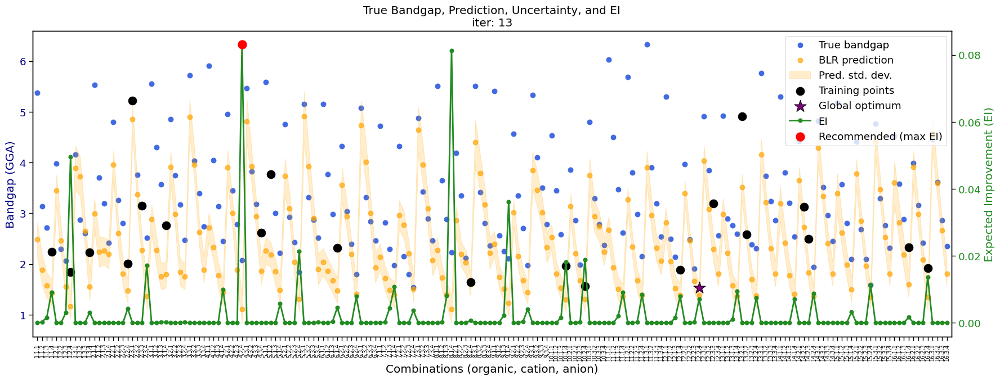

R² score: -0.0377
MAE: 0.9015


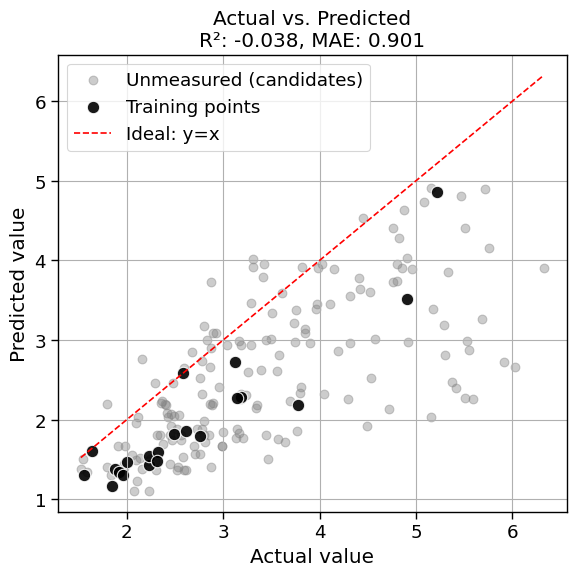

Measurement: 1.3830 (fidelity=0.1)
Cumulative cost: 2.2, best_so_far: 1.6399

==== Iteration 14 ====
EI-based recommended label: [16, 2, 4]


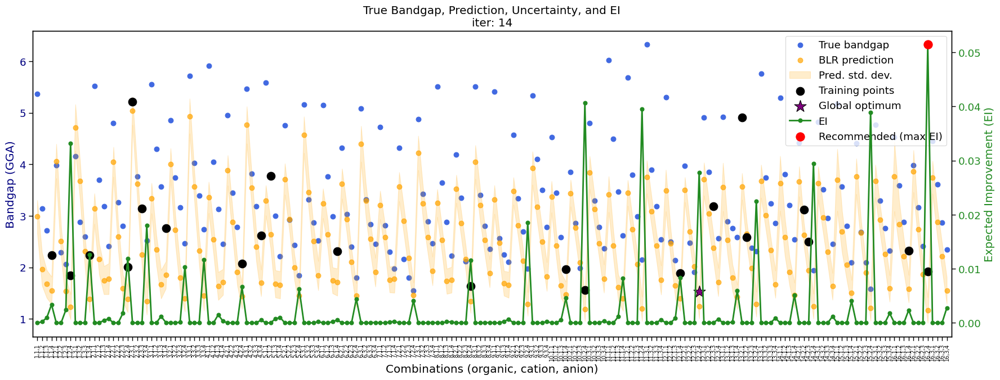

R² score: 0.2156
MAE: 0.8324


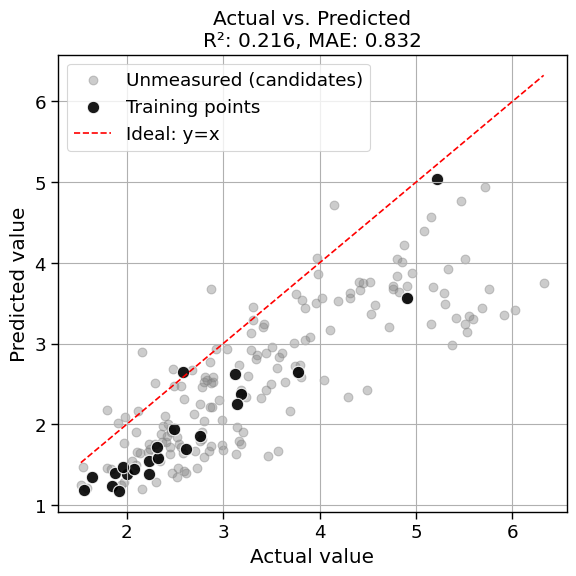

Measurement: 1.3734 (fidelity=0.1)
Cumulative cost: 2.3000000000000003, best_so_far: 1.6399

==== Iteration 15 ====
EI-based recommended label: [1, 2, 4]


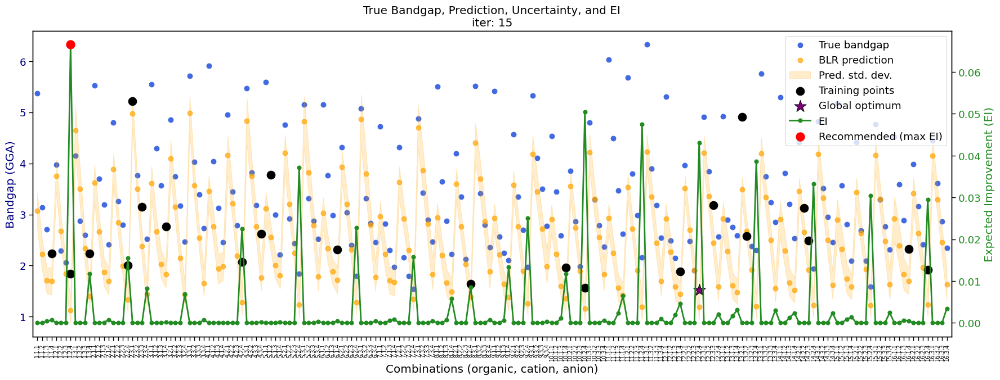

R² score: 0.2101
MAE: 0.8128


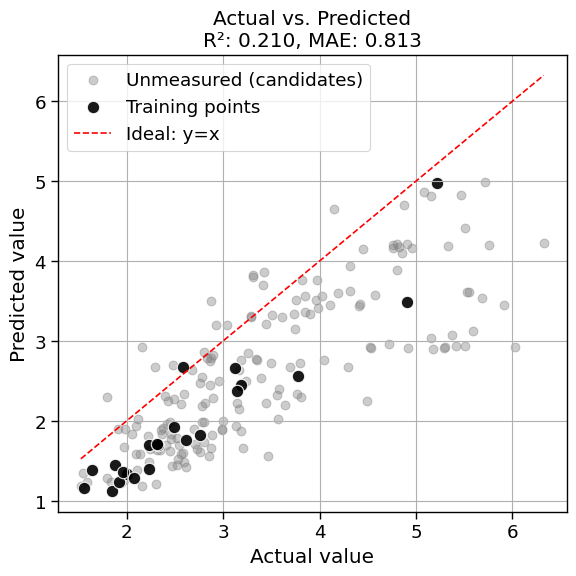

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 2.4000000000000004, best_so_far: 1.6399

==== Iteration 16 ====
EI-based recommended label: [11, 2, 4]


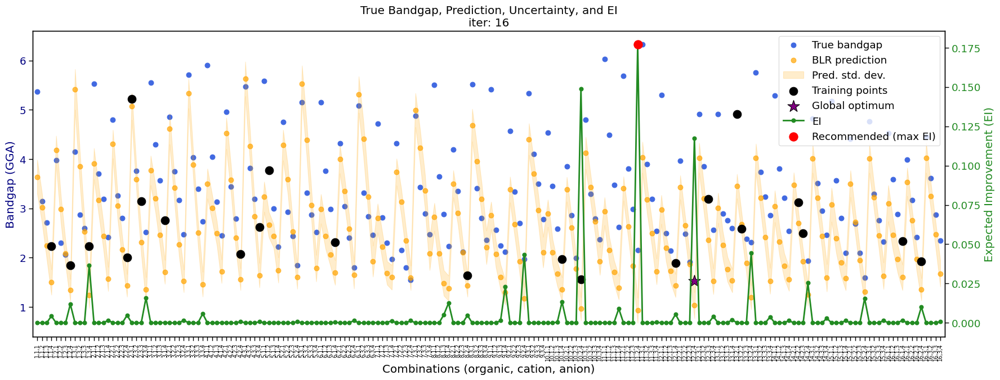

R² score: 0.2444
MAE: 0.7918


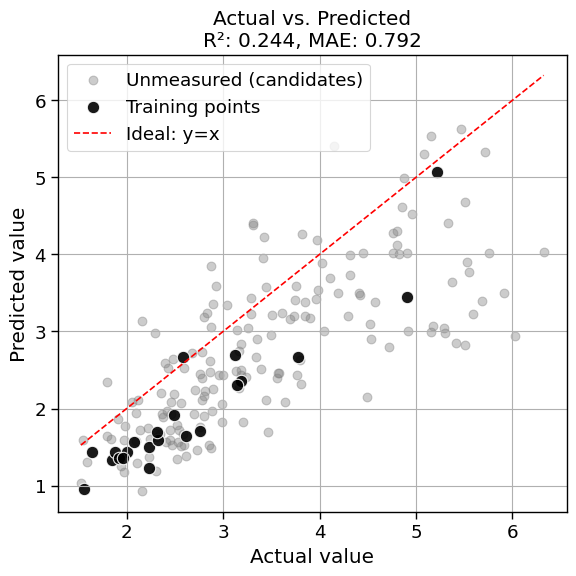

Measurement: 2.1542 (fidelity=1.0)
Cumulative cost: 3.4000000000000004, best_so_far: 1.6399

==== Iteration 17 ====
EI-based recommended label: [1, 2, 4]


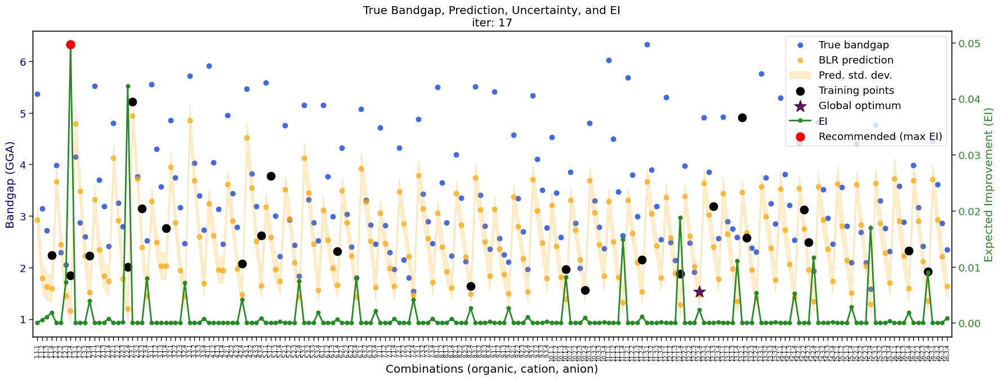

R² score: 0.1977
MAE: 0.8343


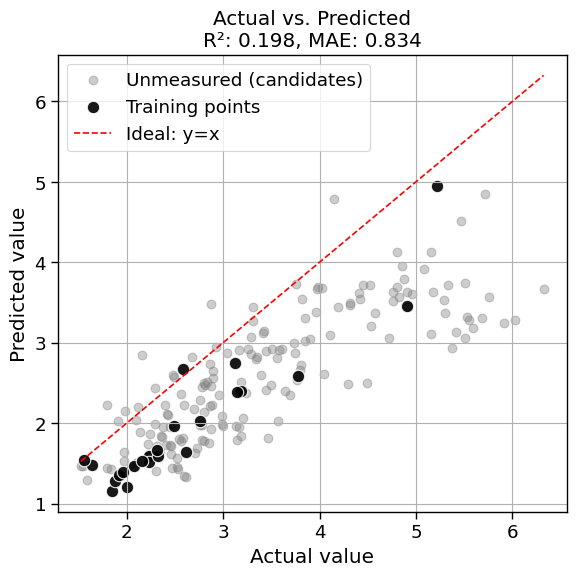

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 3.5000000000000004, best_so_far: 1.6399

==== Iteration 18 ====
EI-based recommended label: [14, 1, 4]


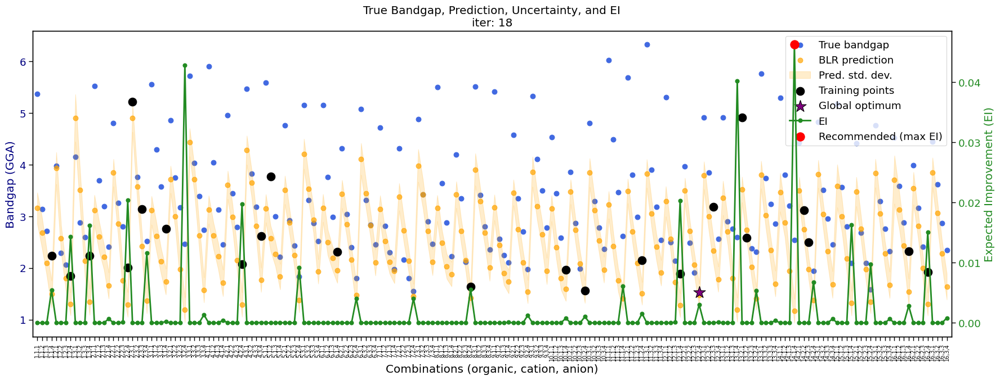

R² score: 0.2420
MAE: 0.7910


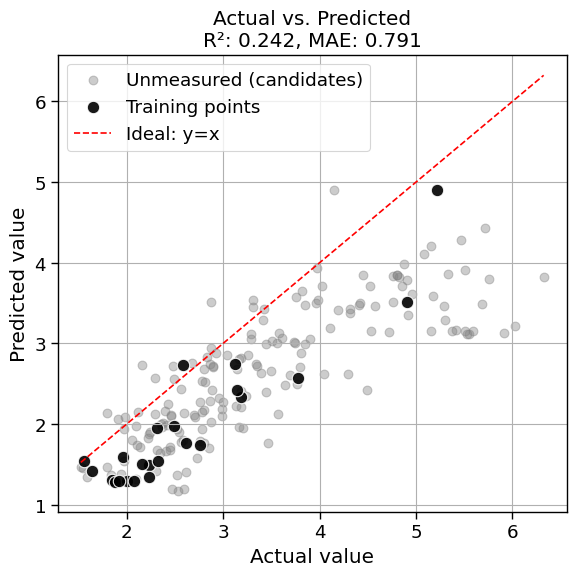

Measurement: 1.6740 (fidelity=0.1)
Cumulative cost: 3.6000000000000005, best_so_far: 1.6399

==== Iteration 19 ====
EI-based recommended label: [6, 2, 4]


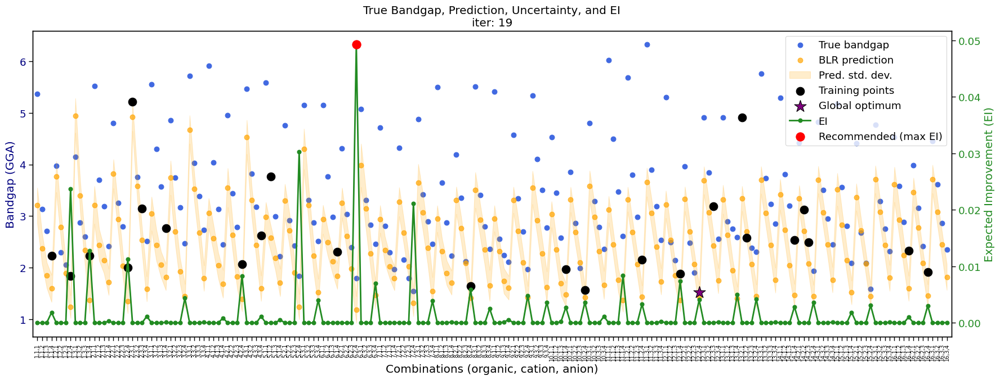

R² score: 0.1441
MAE: 0.8643


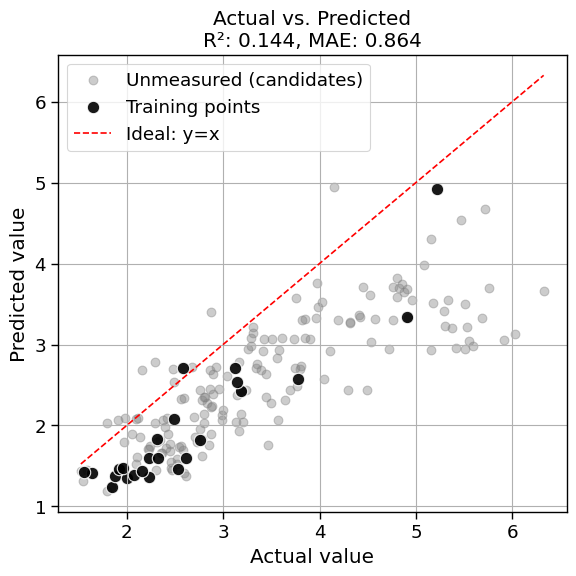

Measurement: 1.2292 (fidelity=0.1)
Cumulative cost: 3.7000000000000006, best_so_far: 1.6399

==== Iteration 20 ====
EI-based recommended label: [2, 3, 4]


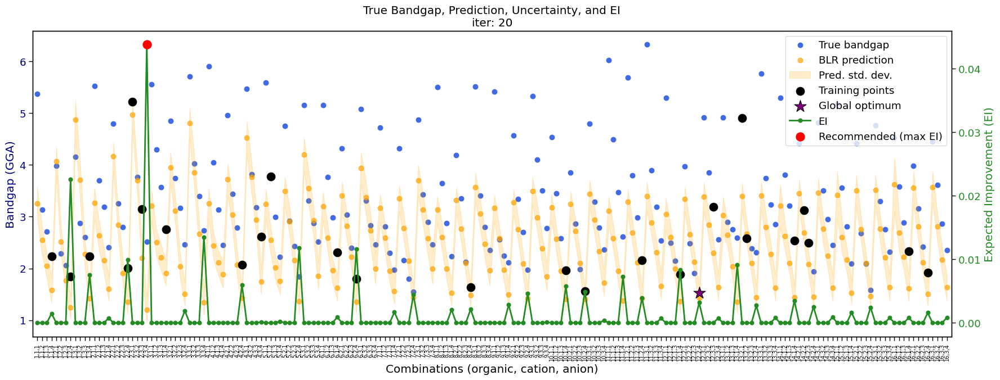

R² score: 0.1683
MAE: 0.8383


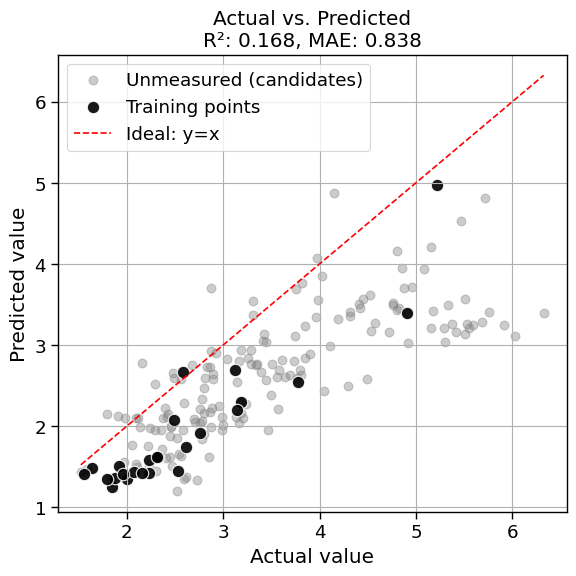

Measurement: 1.6076 (fidelity=0.1)
Cumulative cost: 3.8000000000000007, best_so_far: 1.6399

==== Iteration 21 ====
EI-based recommended label: [1, 2, 4]


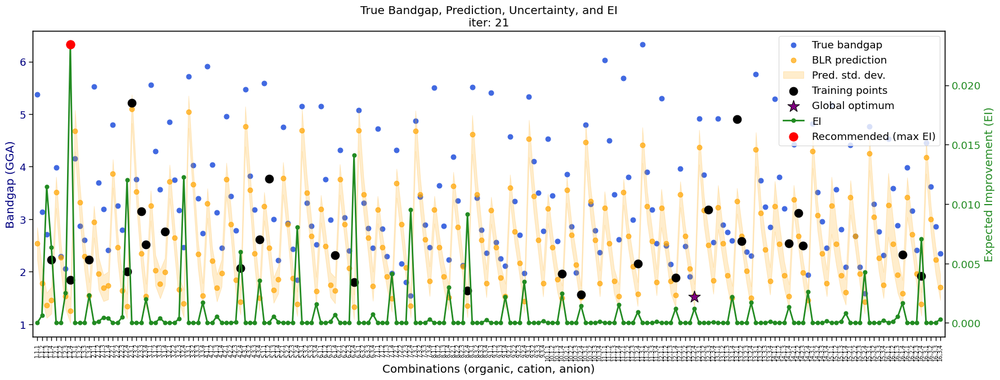

R² score: 0.2153
MAE: 0.8064


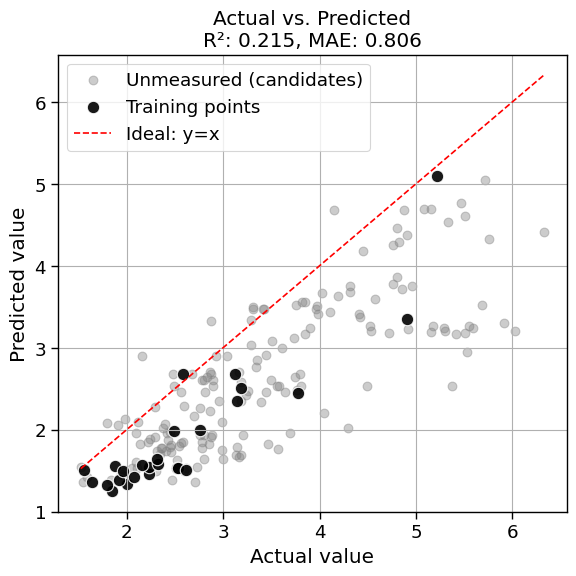

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 3.900000000000001, best_so_far: 1.6399

==== Iteration 22 ====
EI-based recommended label: [5, 2, 4]


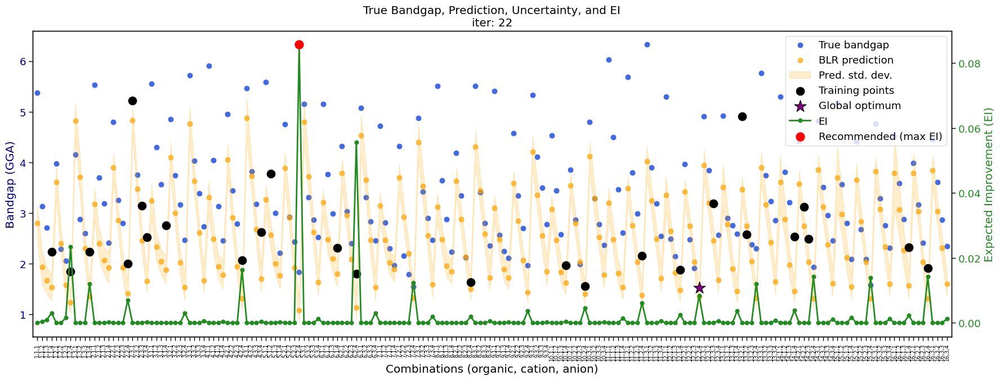

R² score: 0.2809
MAE: 0.7789


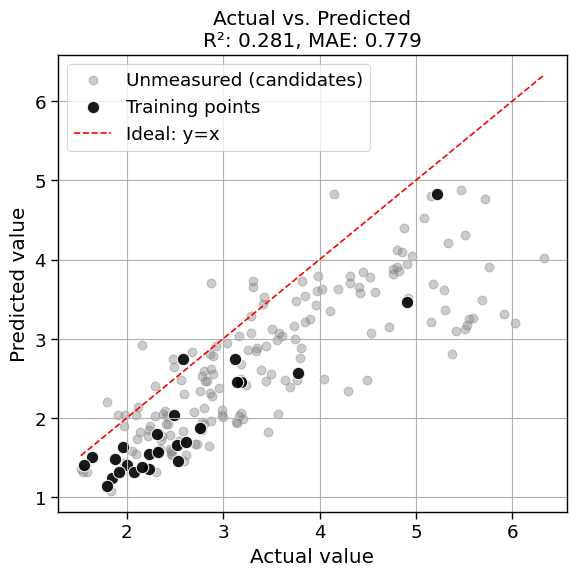

Measurement: 1.2672 (fidelity=0.1)
Cumulative cost: 4.000000000000001, best_so_far: 1.6399

==== Iteration 23 ====
EI-based recommended label: [1, 2, 4]


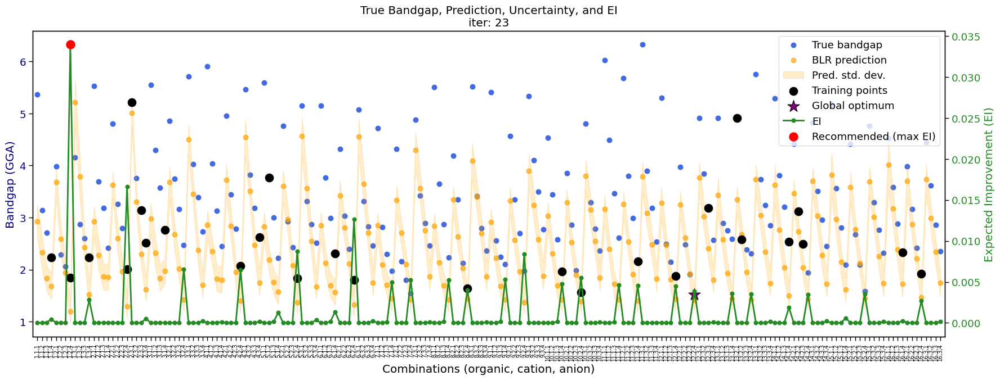

R² score: 0.1356
MAE: 0.8537


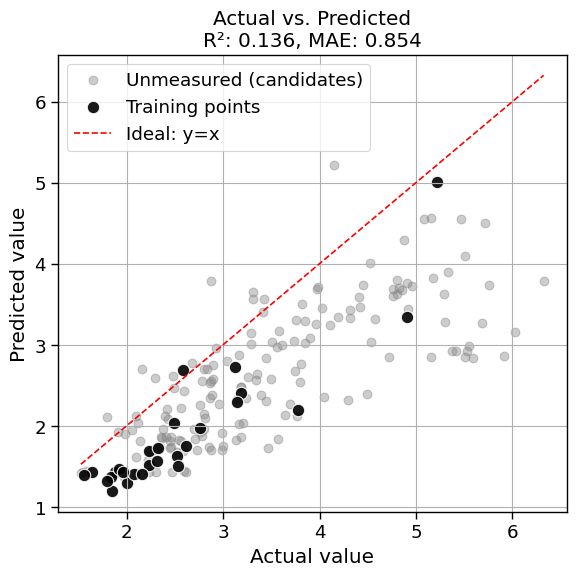

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 4.1000000000000005, best_so_far: 1.6399

==== Iteration 24 ====
EI-based recommended label: [8, 2, 4]


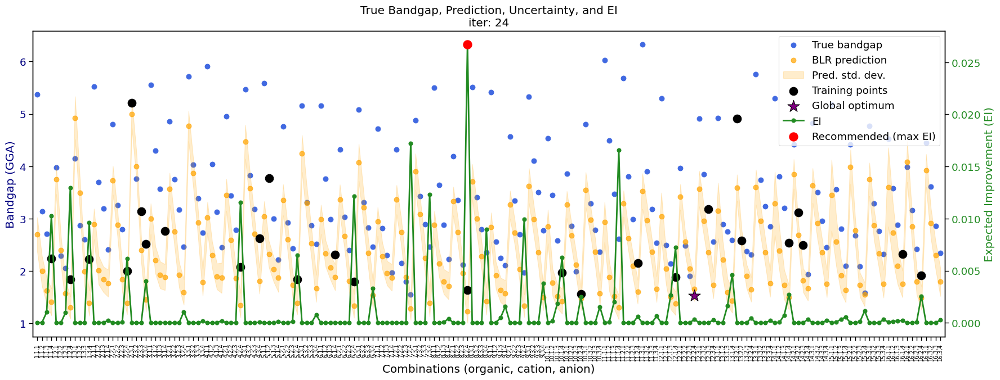

R² score: 0.0386
MAE: 0.9108


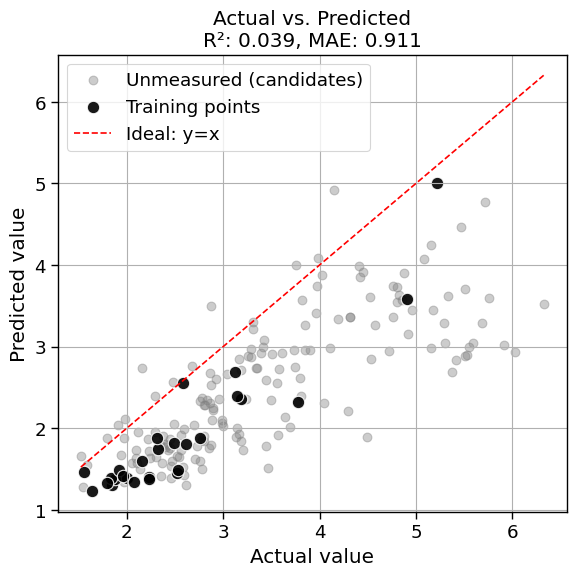

Measurement: 1.6399 (fidelity=1.0)
Cumulative cost: 5.1000000000000005, best_so_far: 1.6399

==== Iteration 25 ====
EI-based recommended label: [1, 2, 4]


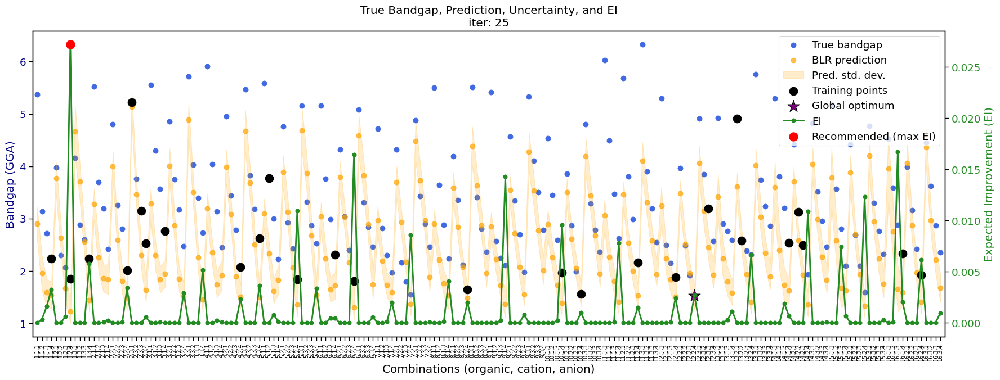

R² score: 0.2088
MAE: 0.8119


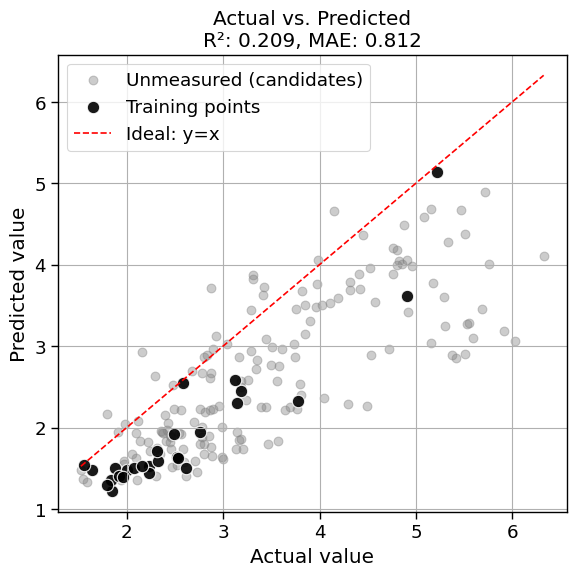

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 5.2, best_so_far: 1.6399

==== Iteration 26 ====
EI-based recommended label: [1, 2, 4]


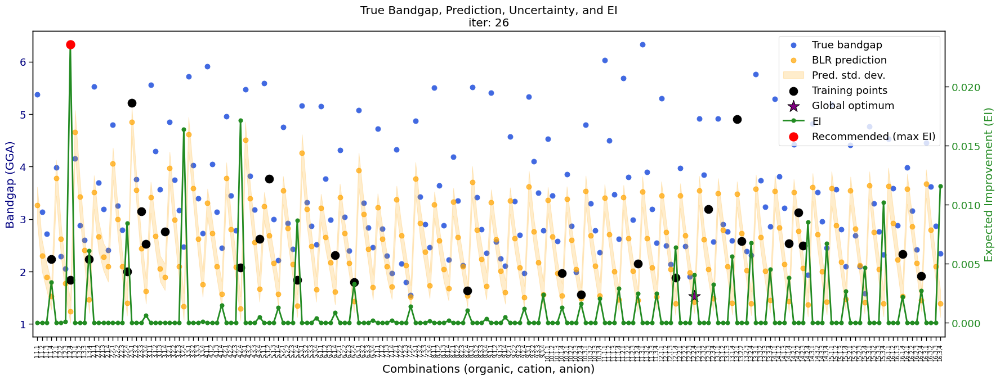

R² score: 0.2137
MAE: 0.8419


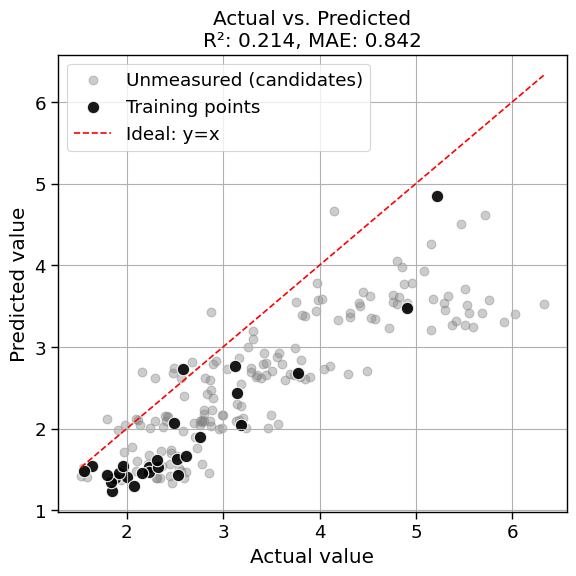

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 5.3, best_so_far: 1.6399

==== Iteration 27 ====
EI-based recommended label: [8, 3, 4]


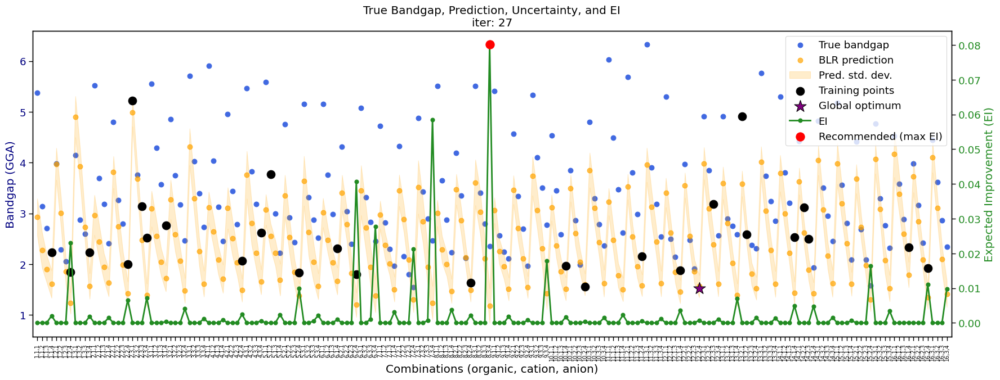

R² score: 0.1384
MAE: 0.8751


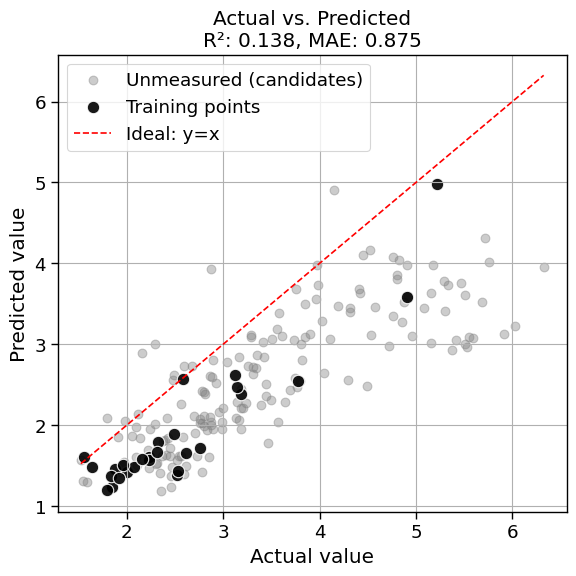

Measurement: 1.5862 (fidelity=0.1)
Cumulative cost: 5.3999999999999995, best_so_far: 1.6399

==== Iteration 28 ====
EI-based recommended label: [6, 2, 4]


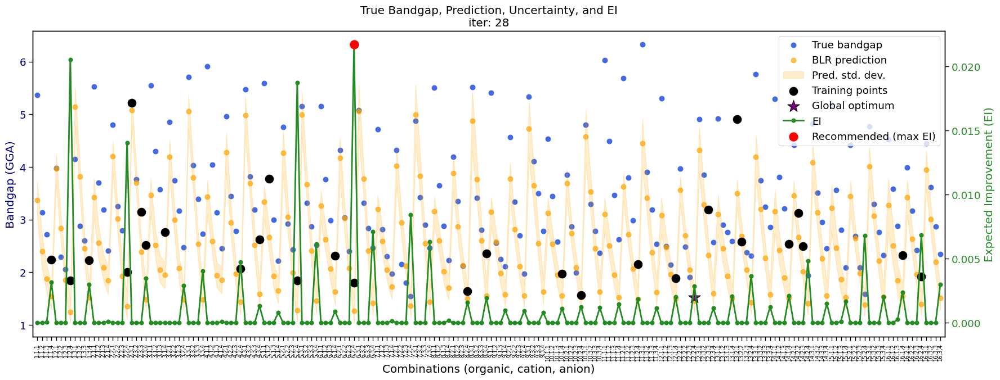

R² score: 0.3004
MAE: 0.7653


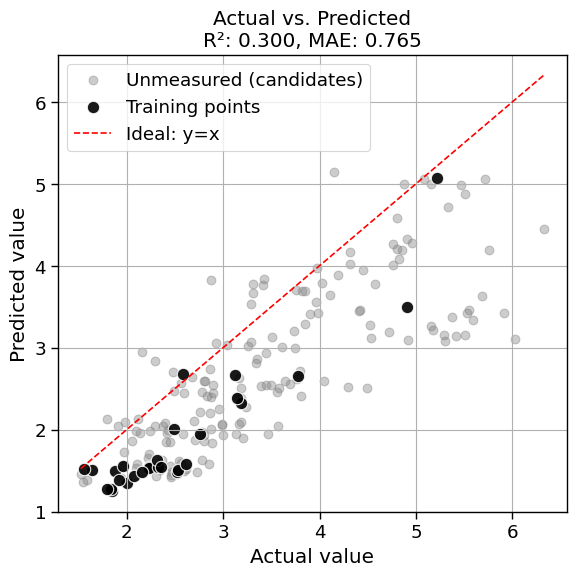

Measurement: 1.2292 (fidelity=0.1)
Cumulative cost: 5.499999999999999, best_so_far: 1.6399

==== Iteration 29 ====
EI-based recommended label: [13, 1, 4]


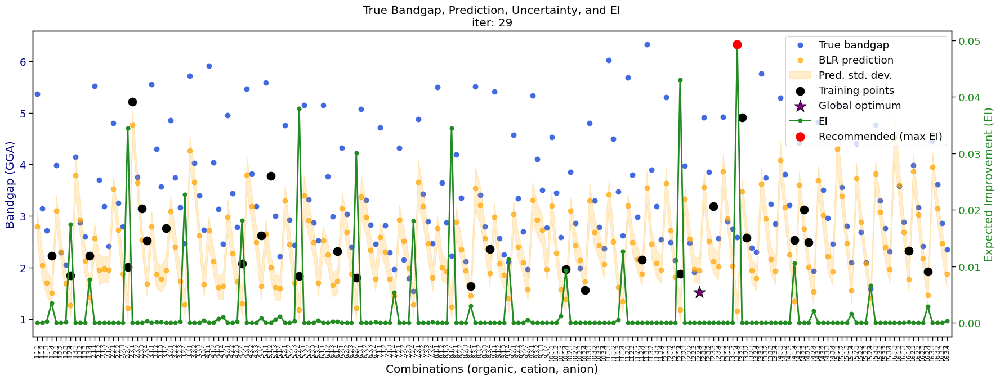

R² score: -0.0131
MAE: 0.9146


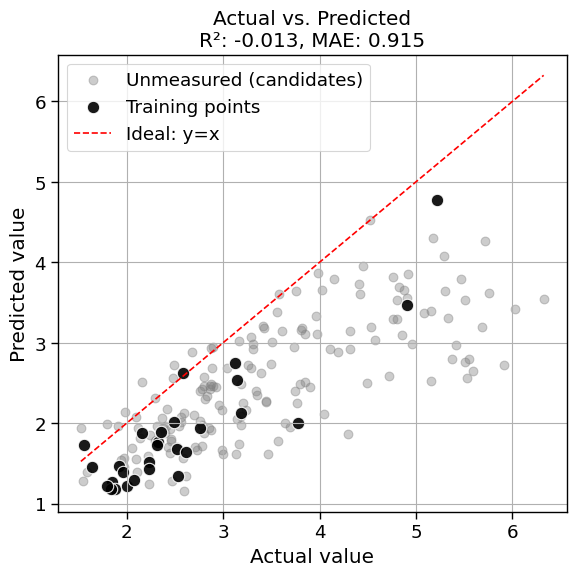

Measurement: 1.9956 (fidelity=0.1)
Cumulative cost: 5.599999999999999, best_so_far: 1.6399

==== Iteration 30 ====
EI-based recommended label: [3, 2, 4]


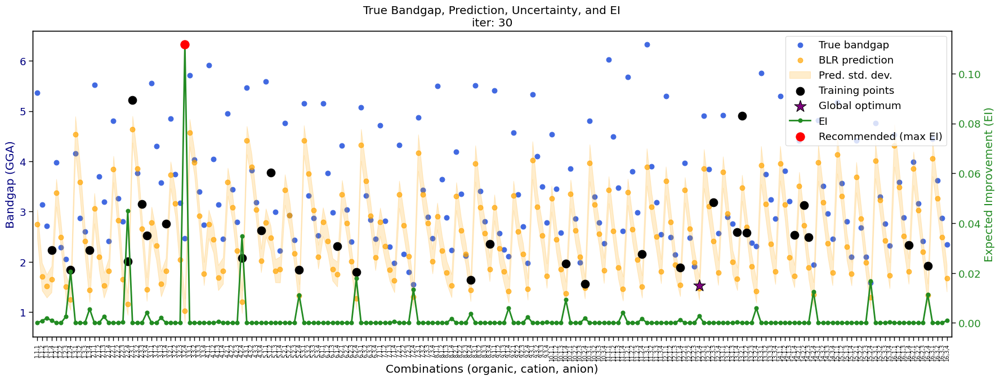

R² score: 0.2013
MAE: 0.7981


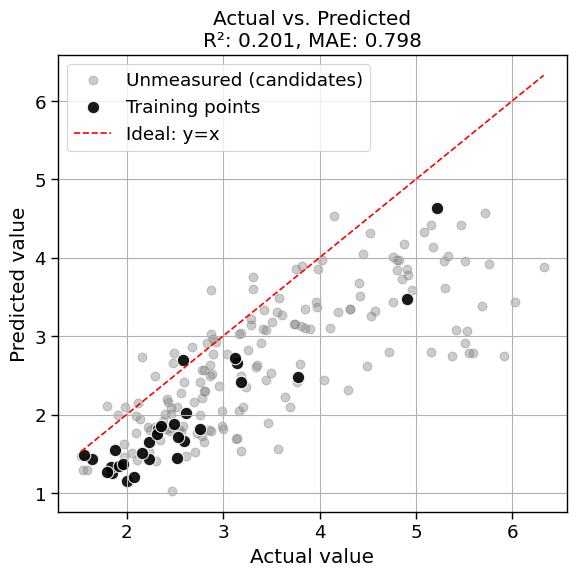

Measurement: 1.7491 (fidelity=0.1)
Cumulative cost: 5.699999999999998, best_so_far: 1.6399

==== Iteration 31 ====
EI-based recommended label: [14, 2, 4]


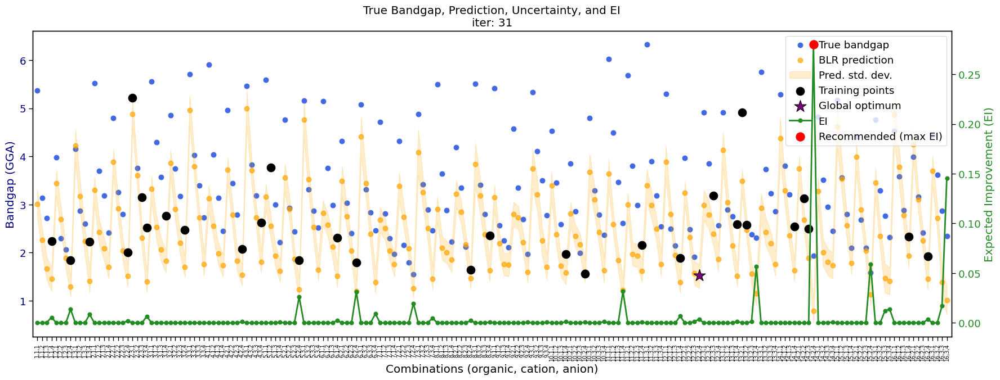

R² score: 0.1558
MAE: 0.8416


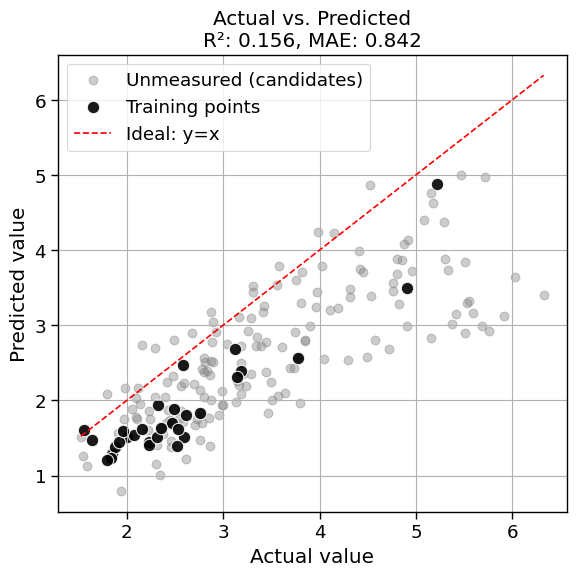

Measurement: 1.3633 (fidelity=0.1)
Cumulative cost: 5.799999999999998, best_so_far: 1.6399

==== Iteration 32 ====
EI-based recommended label: [15, 2, 4]


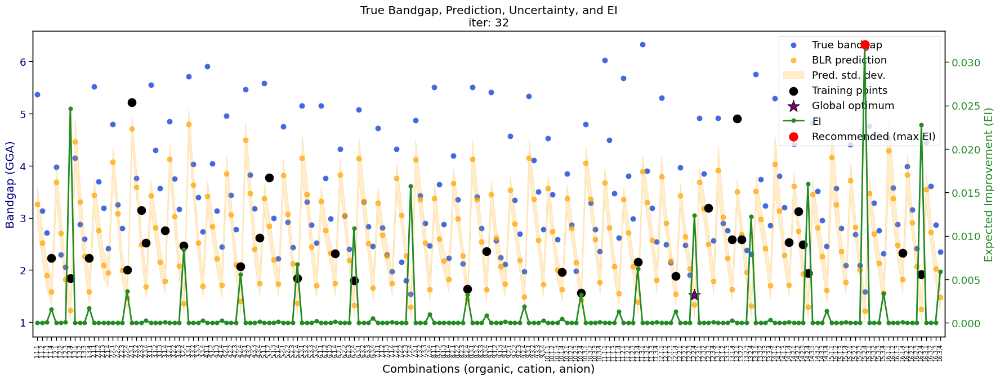

R² score: 0.3791
MAE: 0.7293


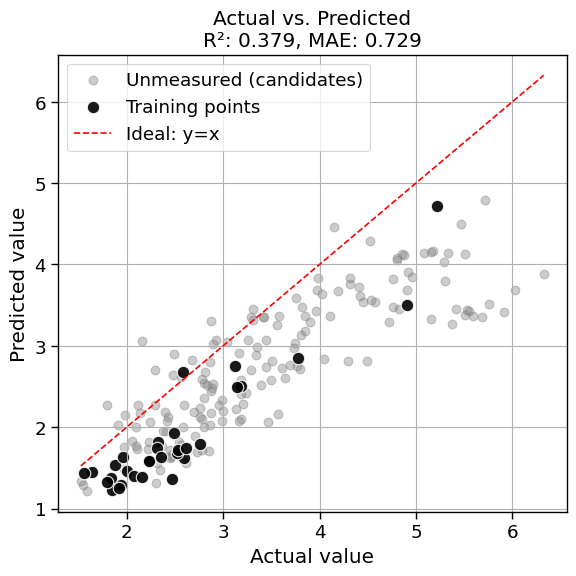

Measurement: 1.5849 (fidelity=1.0)
Cumulative cost: 6.799999999999998, best_so_far: 1.5849

==== Iteration 33 ====
EI-based recommended label: [13, 2, 4]


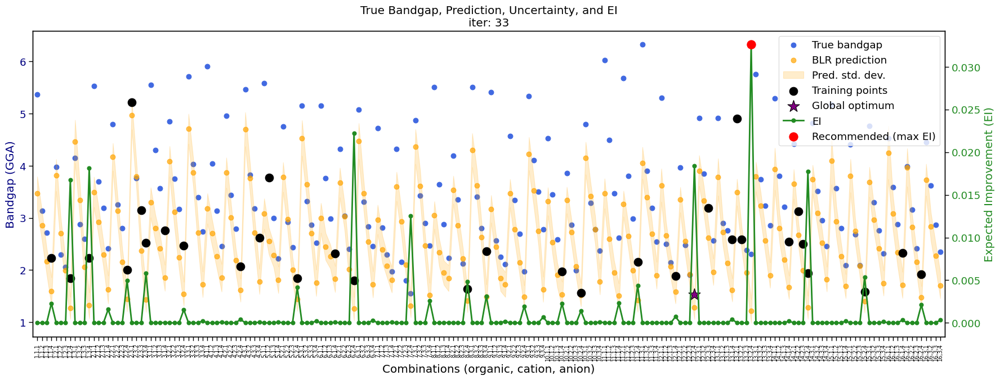

R² score: 0.3652
MAE: 0.7170


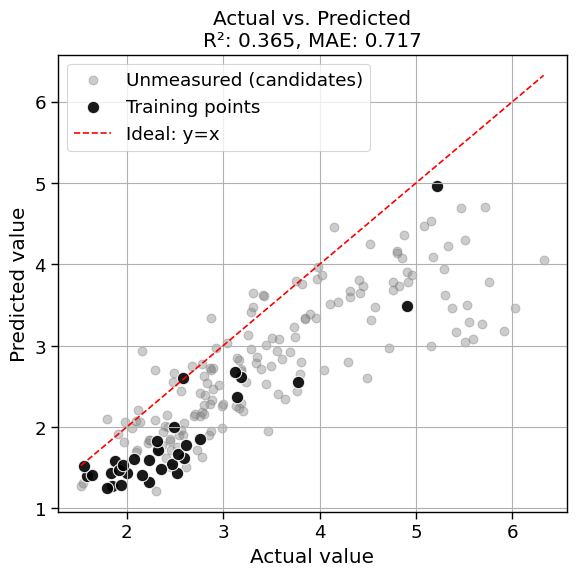

Measurement: 1.7199 (fidelity=0.1)
Cumulative cost: 6.899999999999998, best_so_far: 1.5849

==== Iteration 34 ====
EI-based recommended label: [6, 3, 4]


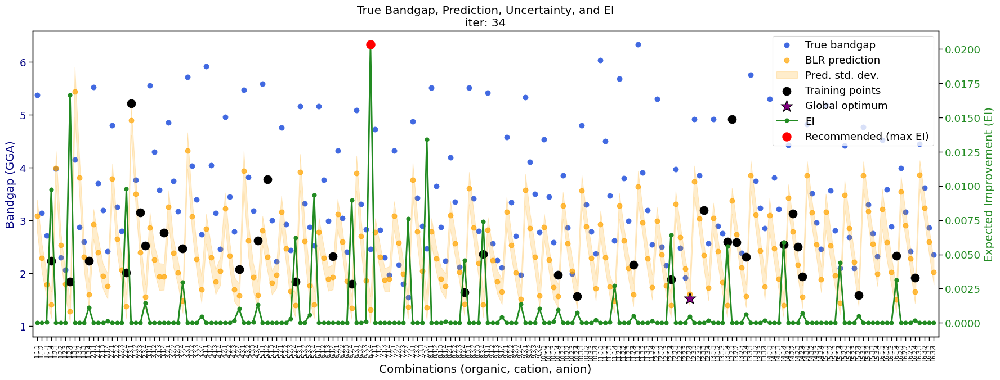

R² score: -0.0247
MAE: 0.9468


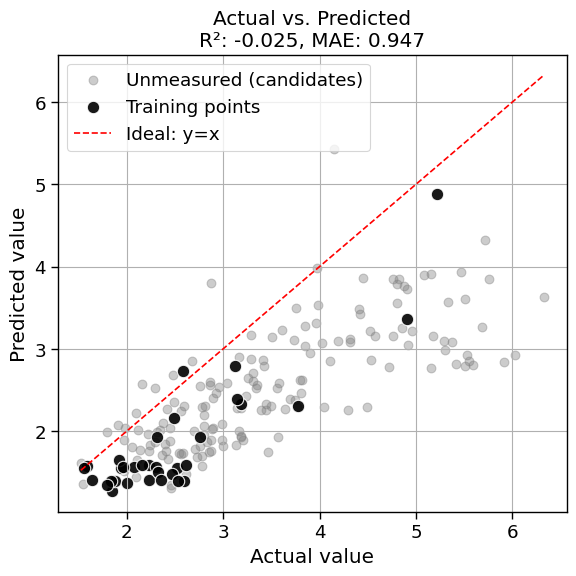

Measurement: 1.5898 (fidelity=0.1)
Cumulative cost: 6.999999999999997, best_so_far: 1.5849

==== Iteration 35 ====
EI-based recommended label: [1, 1, 4]


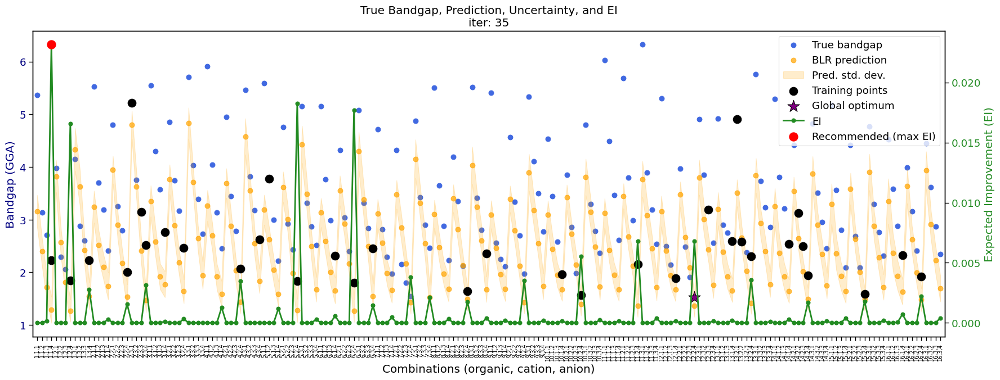

R² score: 0.2294
MAE: 0.8119


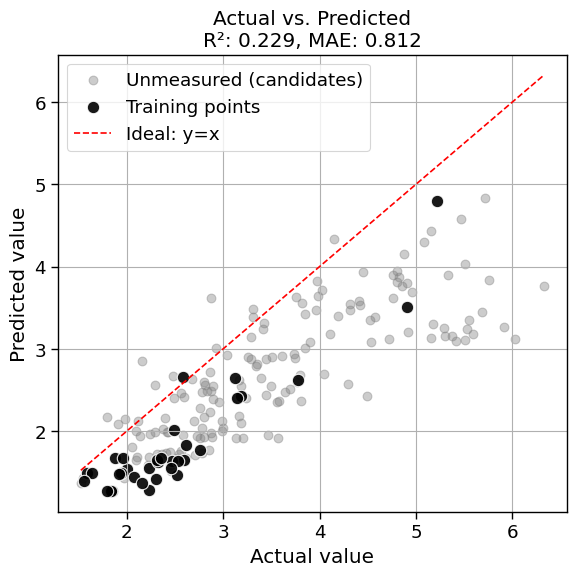

Measurement: 1.4809 (fidelity=0.1)
Cumulative cost: 7.099999999999997, best_so_far: 1.5849

==== Iteration 36 ====
EI-based recommended label: [1, 2, 4]


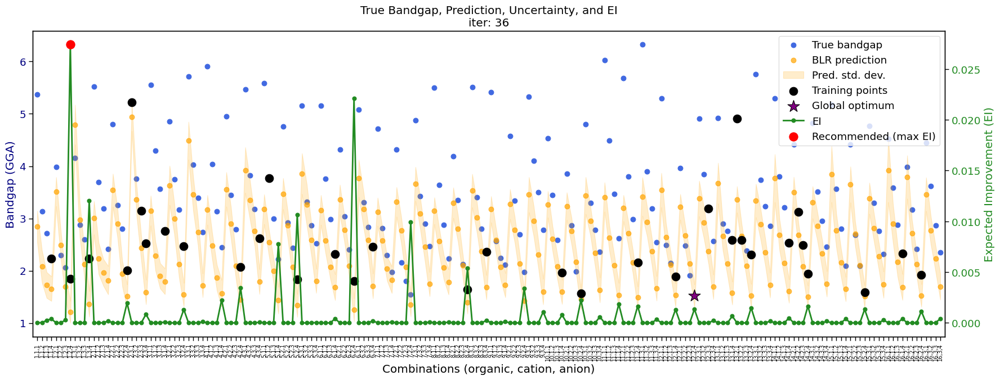

R² score: 0.1612
MAE: 0.8455


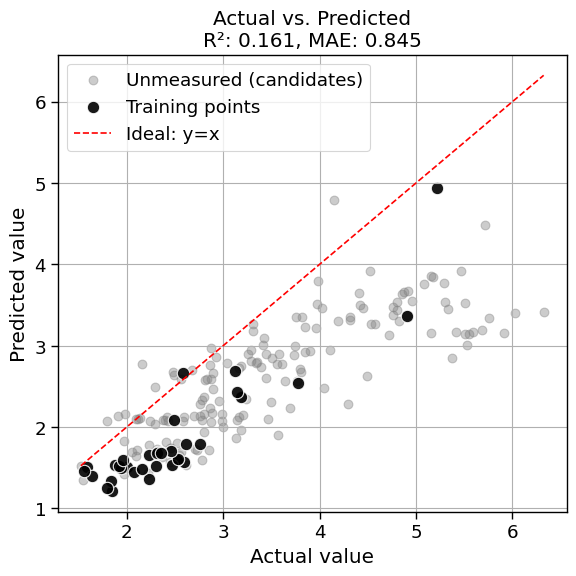

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 7.199999999999997, best_so_far: 1.5849

==== Iteration 37 ====
EI-based recommended label: [1, 2, 4]


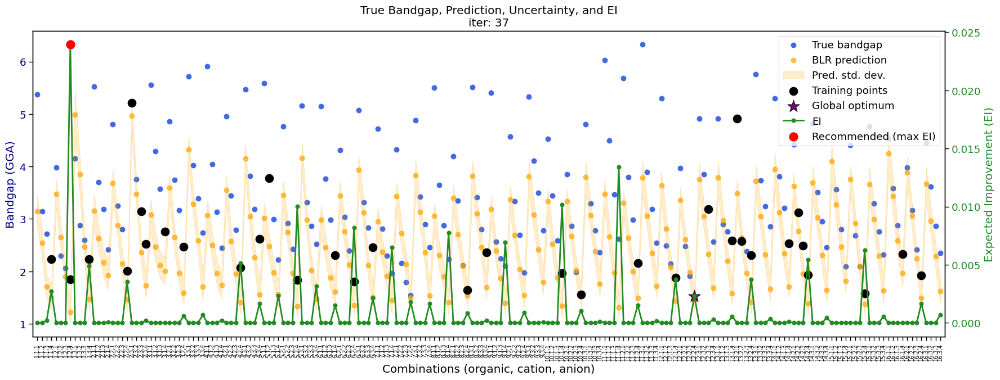

R² score: 0.2179
MAE: 0.8247


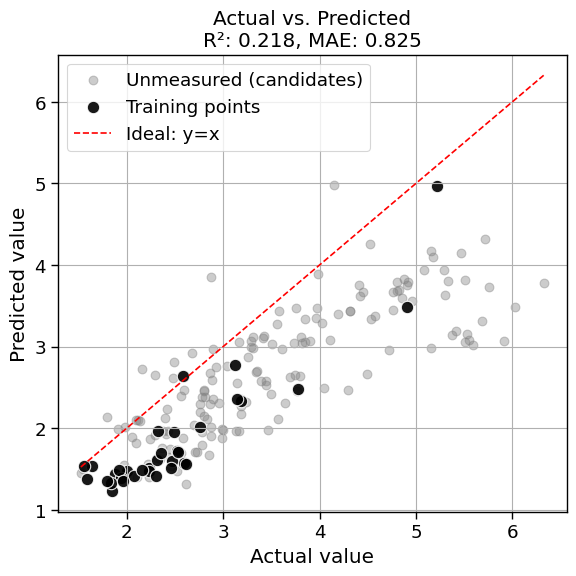

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 7.299999999999996, best_so_far: 1.5849

==== Iteration 38 ====
EI-based recommended label: [1, 2, 4]


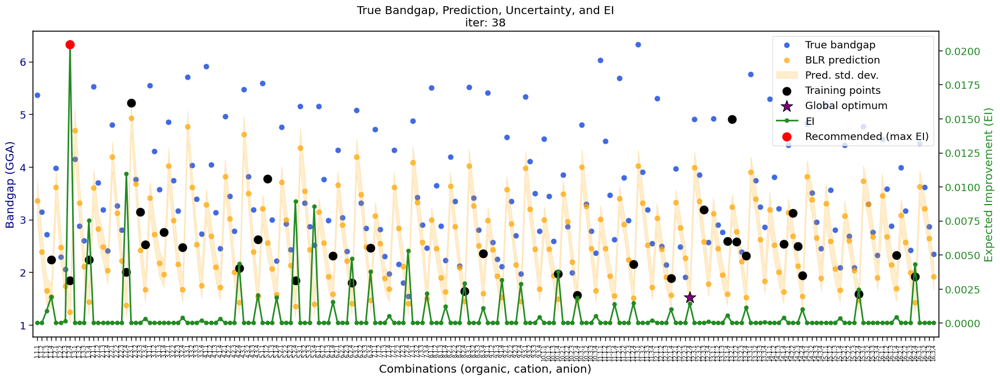

R² score: 0.2606
MAE: 0.7846


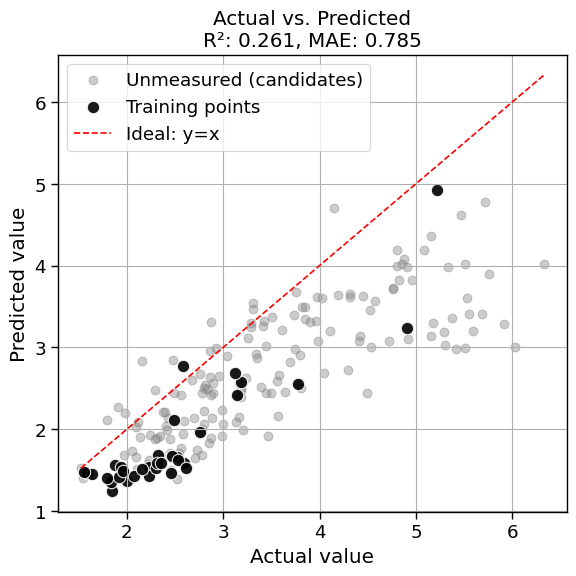

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 7.399999999999996, best_so_far: 1.5849

==== Iteration 39 ====
EI-based recommended label: [6, 2, 4]


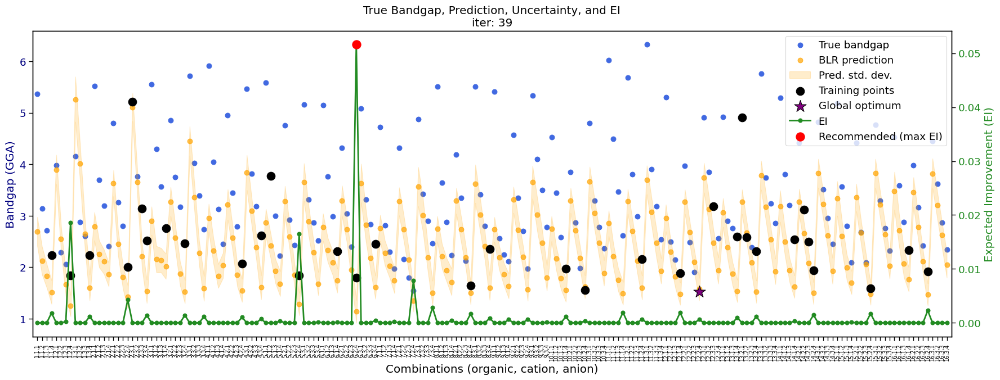

R² score: 0.0263
MAE: 0.9031


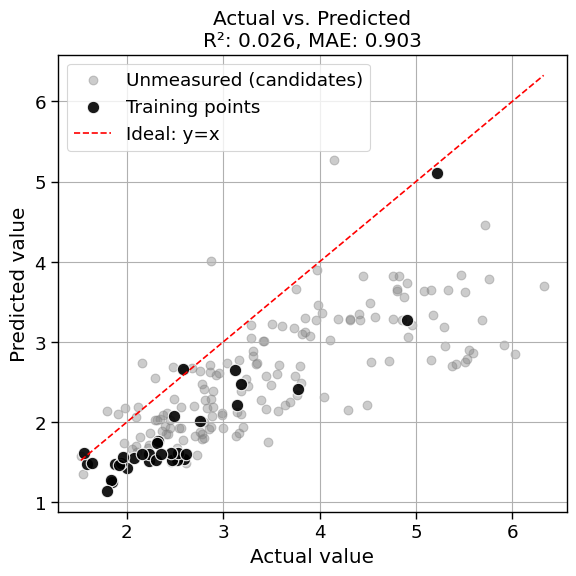

Measurement: 1.2292 (fidelity=0.1)
Cumulative cost: 7.499999999999996, best_so_far: 1.5849

==== Iteration 40 ====
EI-based recommended label: [5, 2, 4]


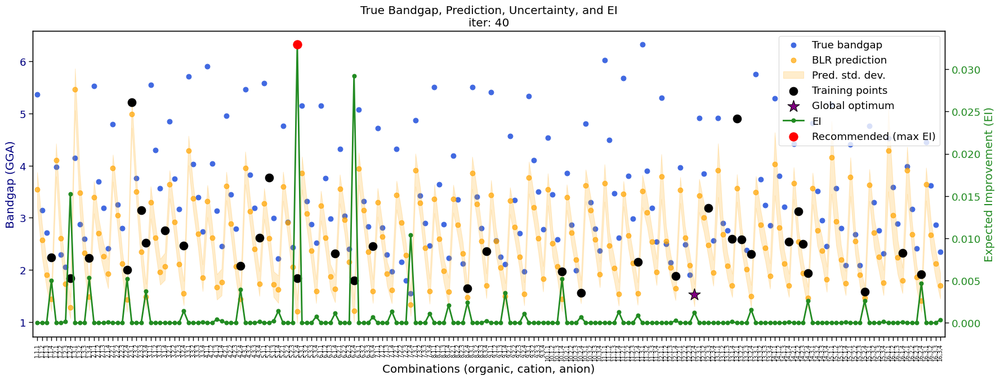

R² score: 0.2813
MAE: 0.7931


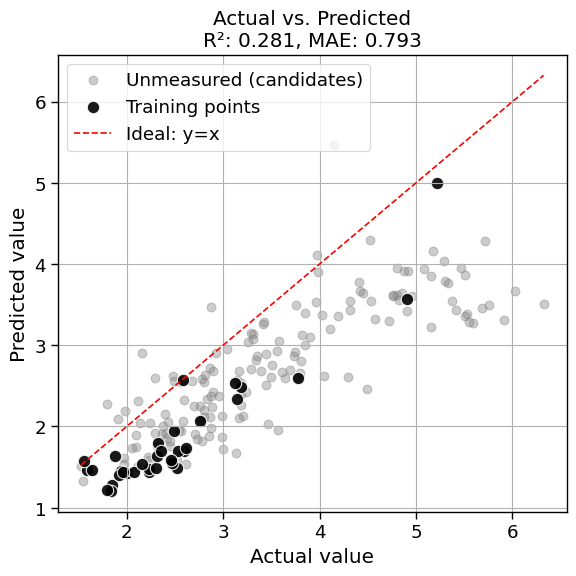

Measurement: 1.8386 (fidelity=1.0)
Cumulative cost: 8.499999999999996, best_so_far: 1.5849

==== Iteration 41 ====
EI-based recommended label: [1, 2, 4]


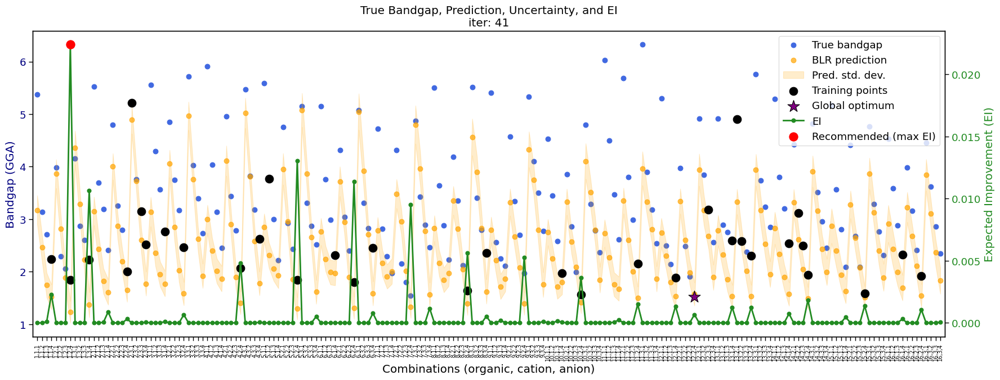

R² score: 0.1564
MAE: 0.8081


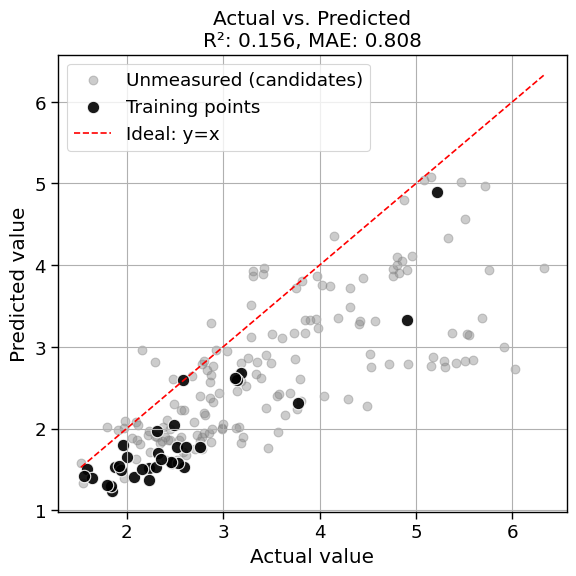

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 8.599999999999996, best_so_far: 1.5849

==== Iteration 42 ====
EI-based recommended label: [7, 2, 4]


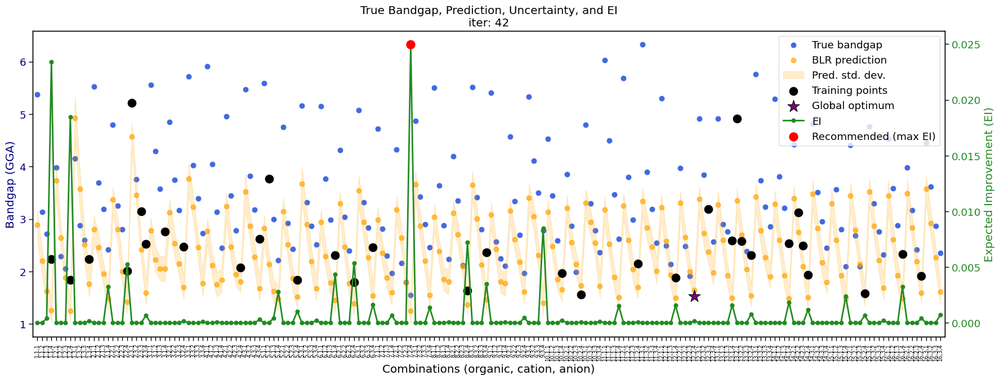

R² score: -0.0174
MAE: 0.9439


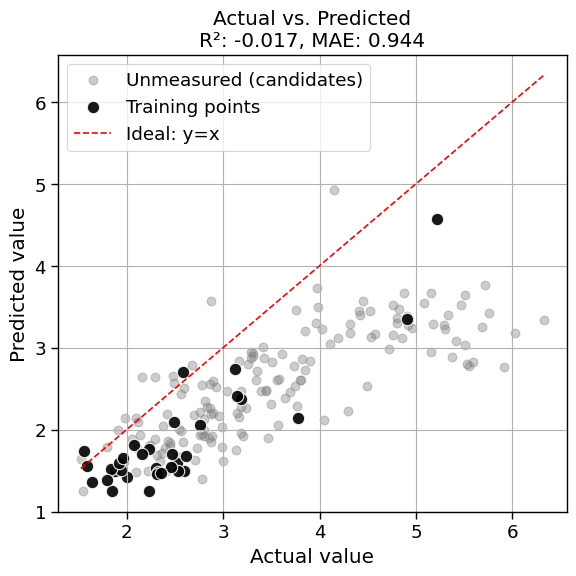

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 8.699999999999996, best_so_far: 1.5849

==== Iteration 43 ====
EI-based recommended label: [1, 2, 4]


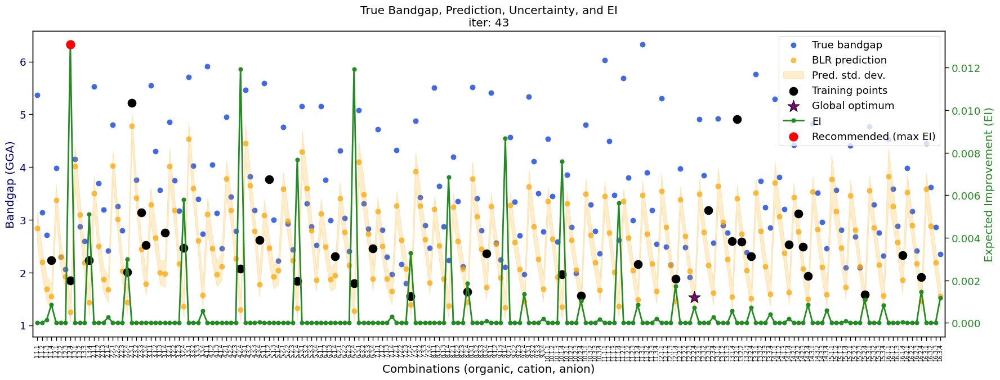

R² score: 0.2201
MAE: 0.8133


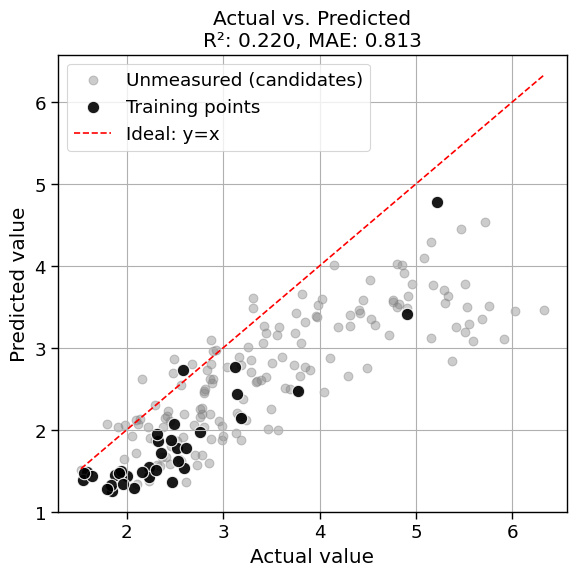

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 8.799999999999995, best_so_far: 1.5849

==== Iteration 44 ====
EI-based recommended label: [6, 2, 4]


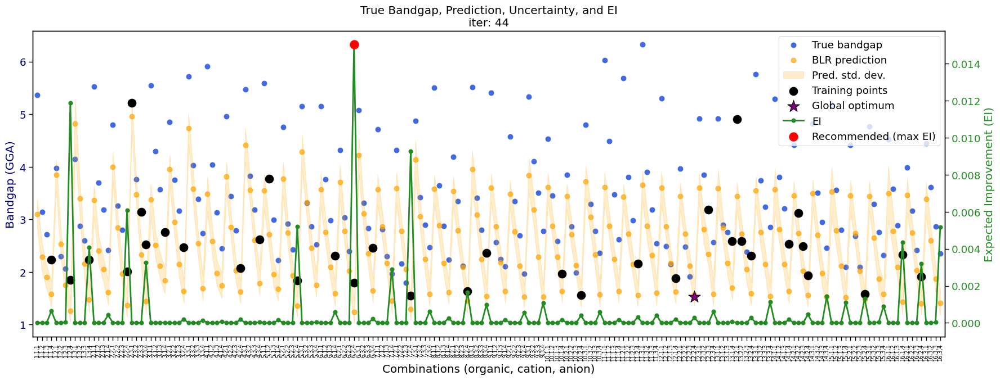

R² score: 0.2839
MAE: 0.8081


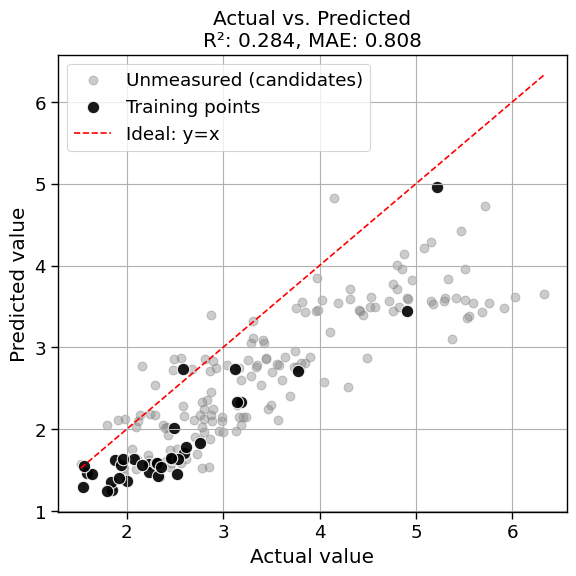

Measurement: 1.2292 (fidelity=0.1)
Cumulative cost: 8.899999999999995, best_so_far: 1.5849

==== Iteration 45 ====
EI-based recommended label: [1, 2, 4]


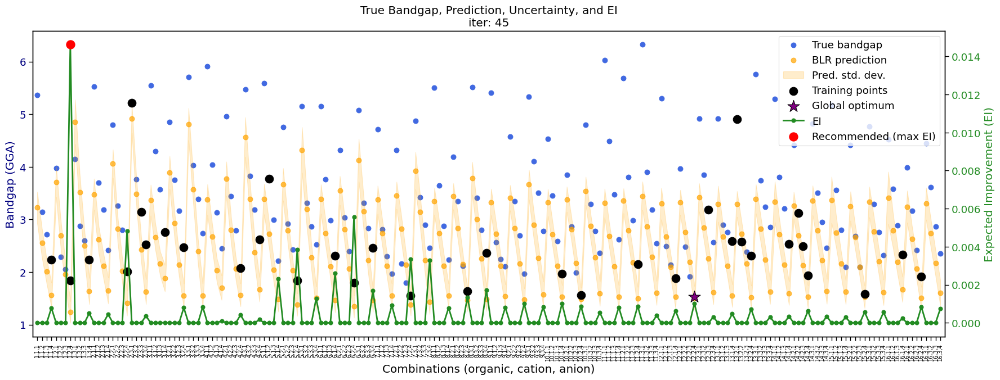

R² score: 0.2161
MAE: 0.8373


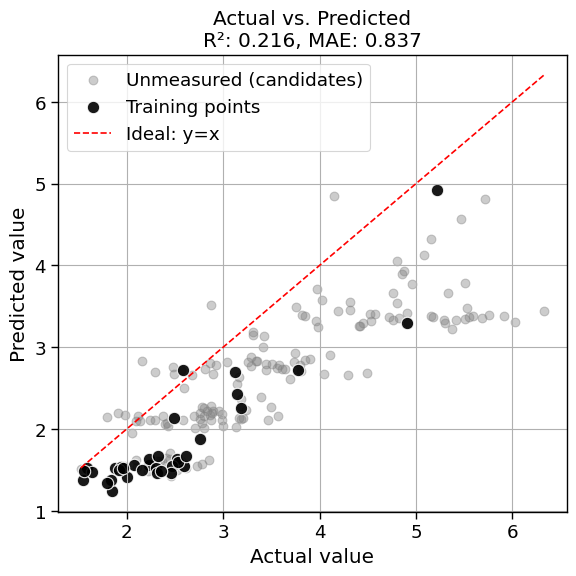

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 8.999999999999995, best_so_far: 1.5849

==== Iteration 46 ====
EI-based recommended label: [3, 2, 4]


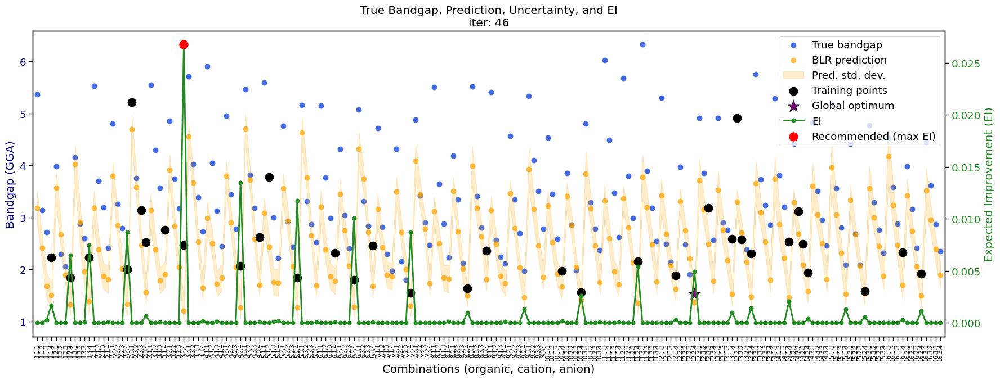

R² score: 0.2478
MAE: 0.7887


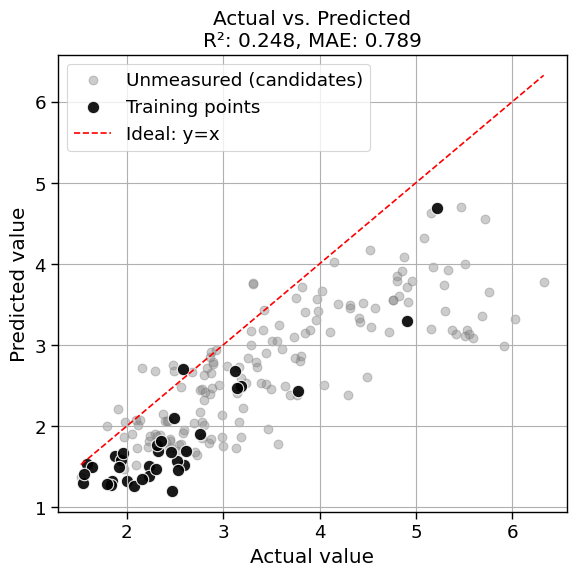

Measurement: 1.7491 (fidelity=0.1)
Cumulative cost: 9.099999999999994, best_so_far: 1.5849

==== Iteration 47 ====
EI-based recommended label: [1, 2, 4]


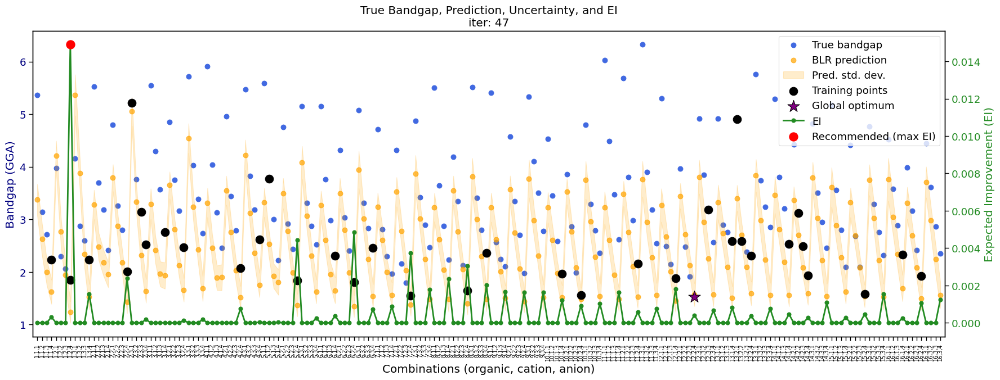

R² score: 0.2182
MAE: 0.8378


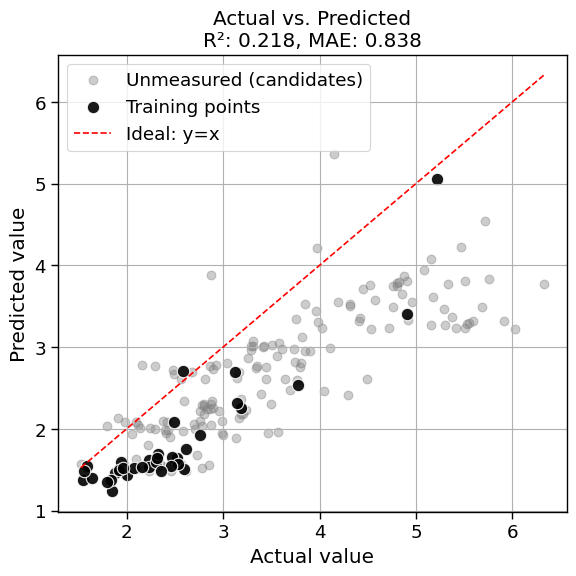

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 9.199999999999994, best_so_far: 1.5849

==== Iteration 48 ====
EI-based recommended label: [1, 2, 4]


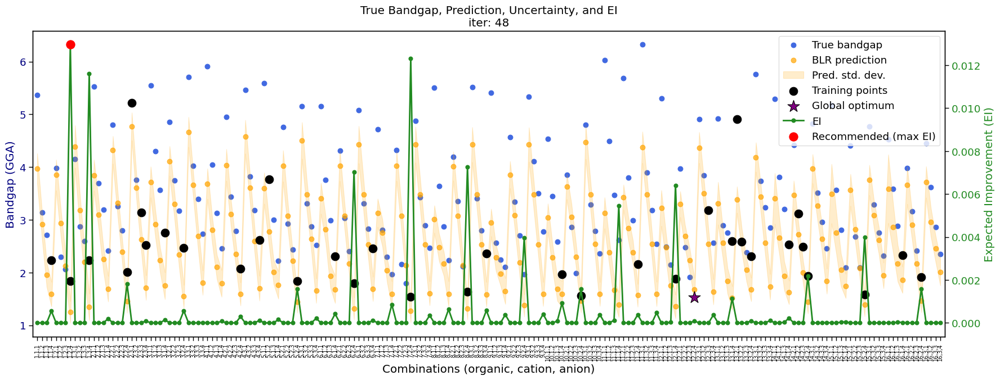

R² score: 0.3897
MAE: 0.7042


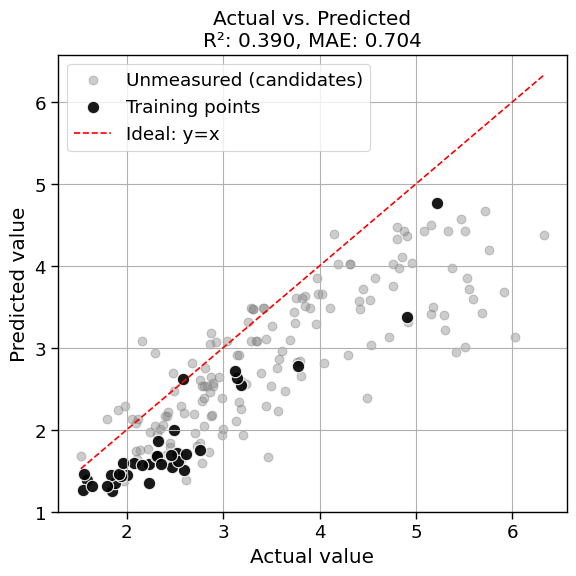

Measurement: 1.8440 (fidelity=1.0)
Cumulative cost: 10.199999999999994, best_so_far: 1.5849

==== Iteration 49 ====
EI-based recommended label: [1, 2, 4]


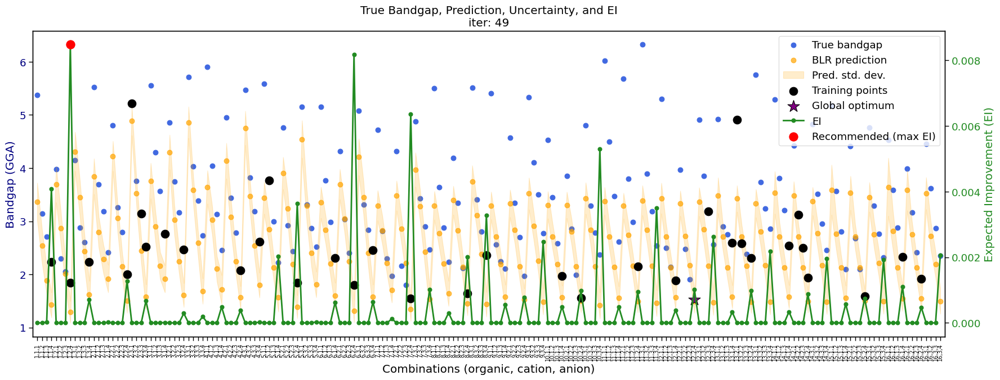

R² score: 0.2851
MAE: 0.7877


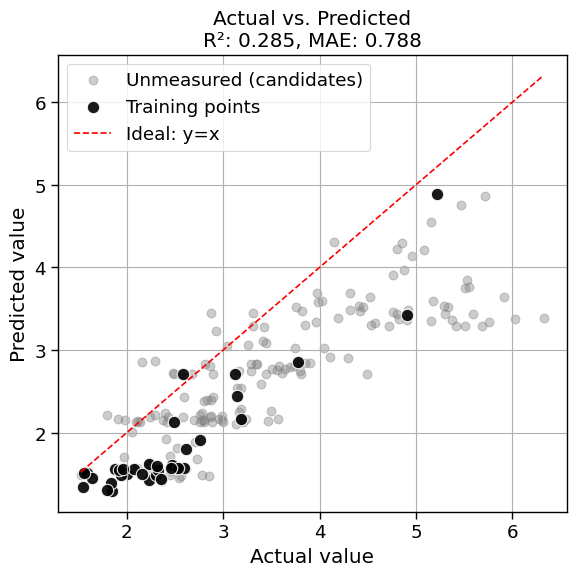

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 10.299999999999994, best_so_far: 1.5849

==== Iteration 50 ====
EI-based recommended label: [2, 1, 4]


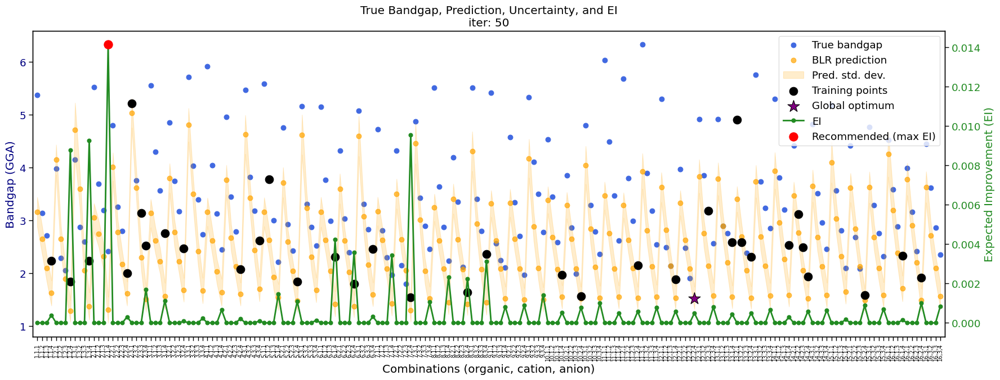

R² score: 0.2666
MAE: 0.8074


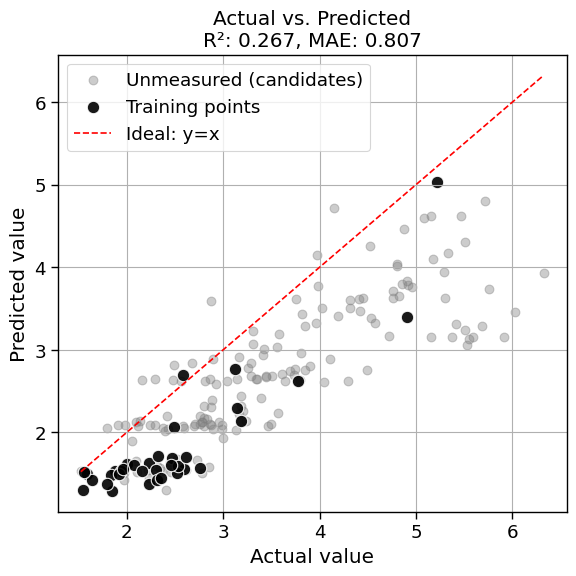

Measurement: 1.6555 (fidelity=0.1)
Cumulative cost: 10.399999999999993, best_so_far: 1.5849

==== Iteration 51 ====
EI-based recommended label: [1, 2, 4]


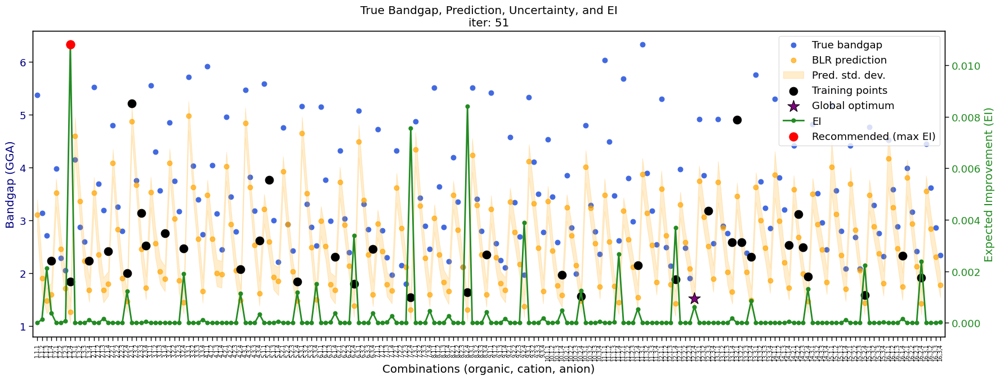

R² score: 0.3012
MAE: 0.7697


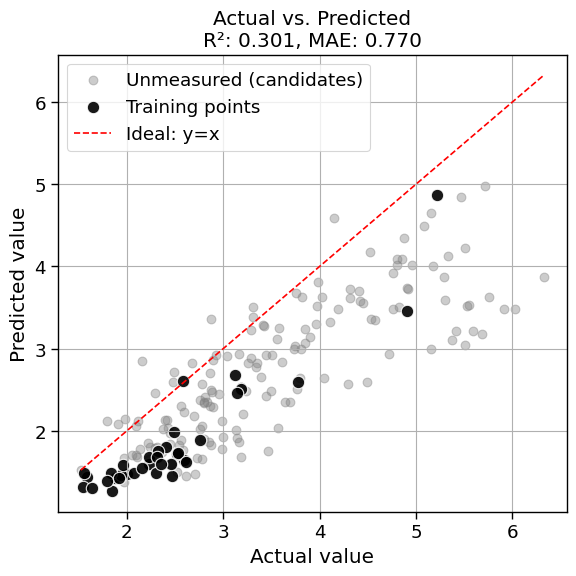

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 10.499999999999993, best_so_far: 1.5849

==== Iteration 52 ====
EI-based recommended label: [1, 2, 4]


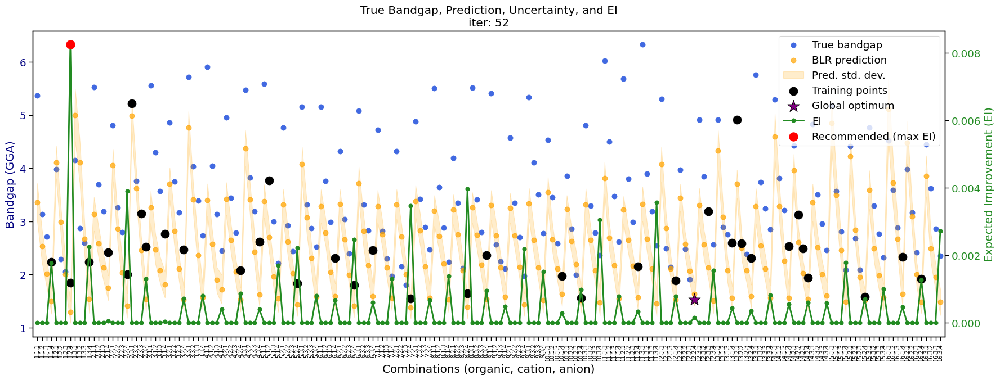

R² score: 0.1983
MAE: 0.8415


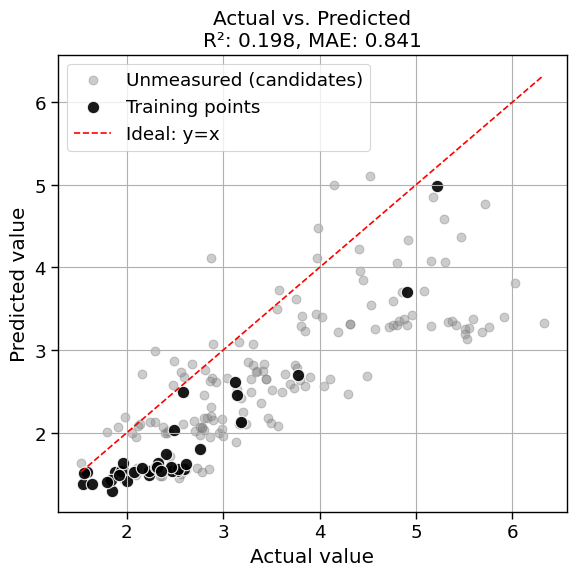

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 10.599999999999993, best_so_far: 1.5849

==== Iteration 53 ====
EI-based recommended label: [16, 2, 4]


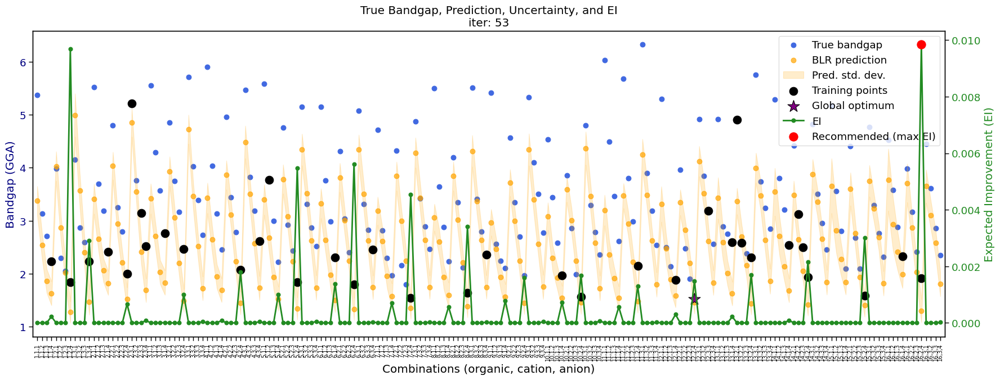

R² score: 0.3495
MAE: 0.7299


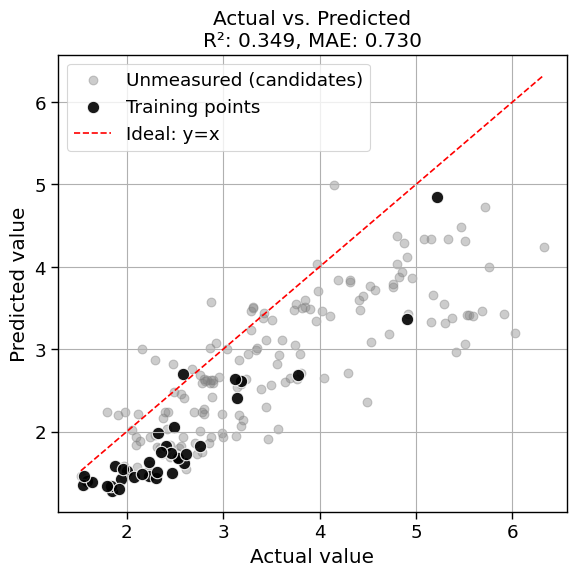

Measurement: 1.3734 (fidelity=0.1)
Cumulative cost: 10.699999999999992, best_so_far: 1.5849

==== Iteration 54 ====
EI-based recommended label: [7, 2, 4]


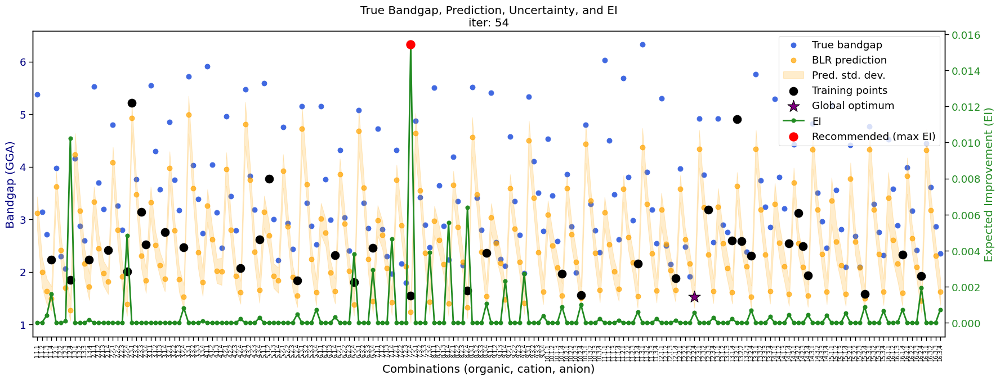

R² score: 0.2962
MAE: 0.7614


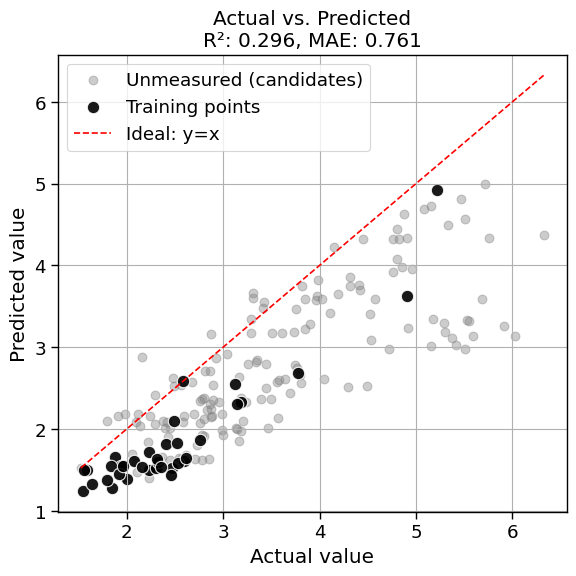

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 10.799999999999992, best_so_far: 1.5849

==== Iteration 55 ====
EI-based recommended label: [1, 2, 4]


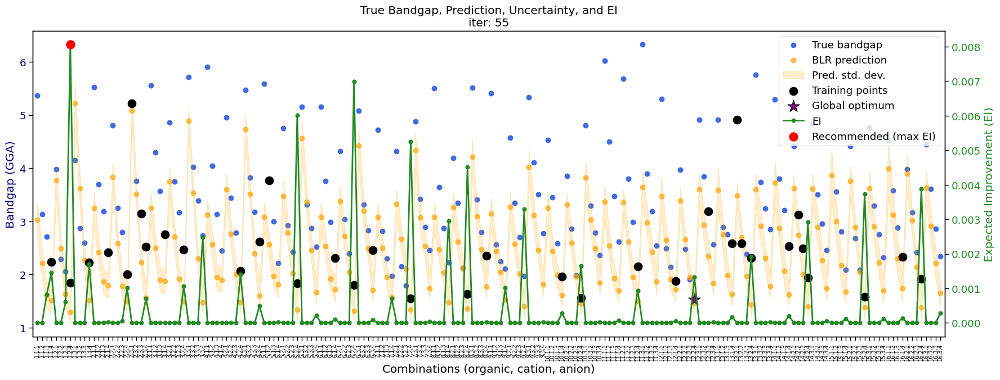

R² score: 0.2295
MAE: 0.8167


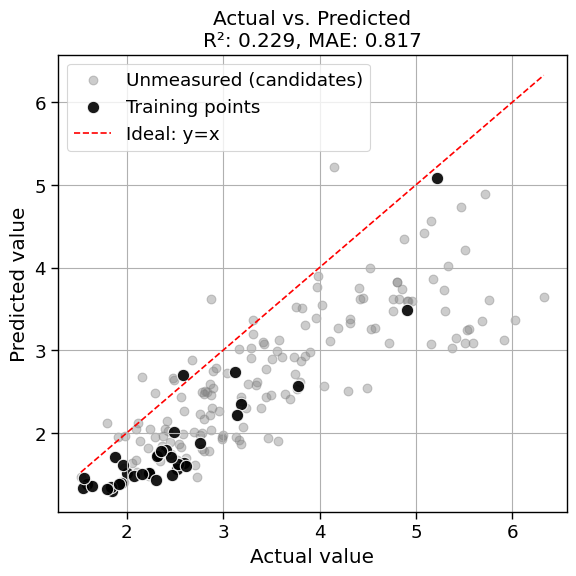

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 10.899999999999991, best_so_far: 1.5849

==== Iteration 56 ====
EI-based recommended label: [8, 1, 4]


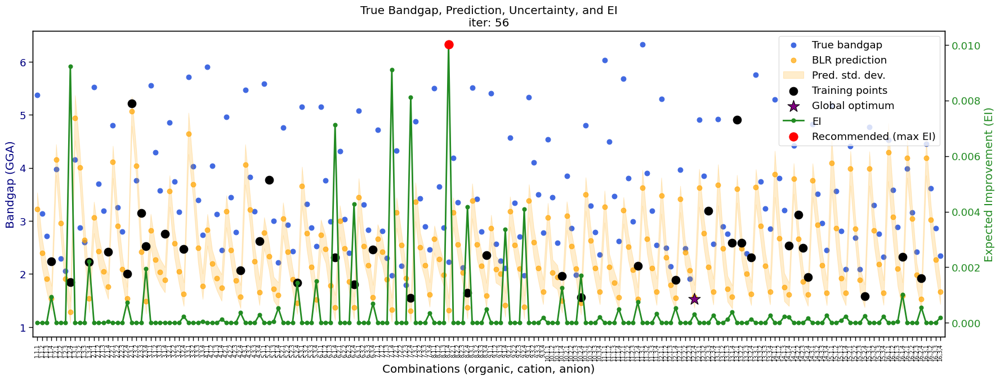

R² score: 0.0254
MAE: 0.9300


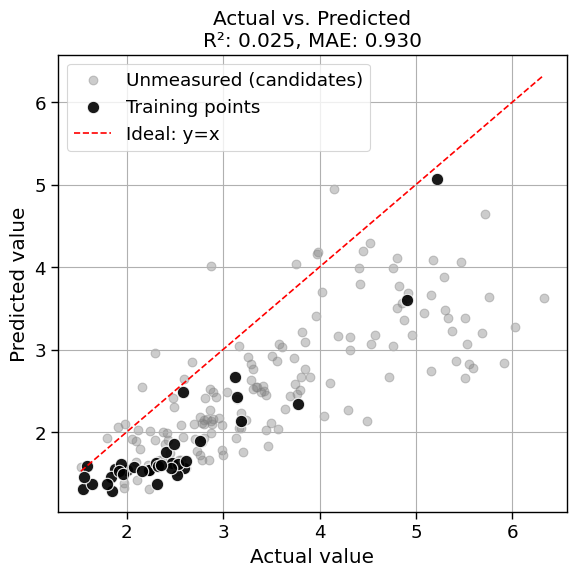

Measurement: 2.2305 (fidelity=1.0)
Cumulative cost: 11.899999999999991, best_so_far: 1.5849

==== Iteration 57 ====
EI-based recommended label: [5, 2, 4]


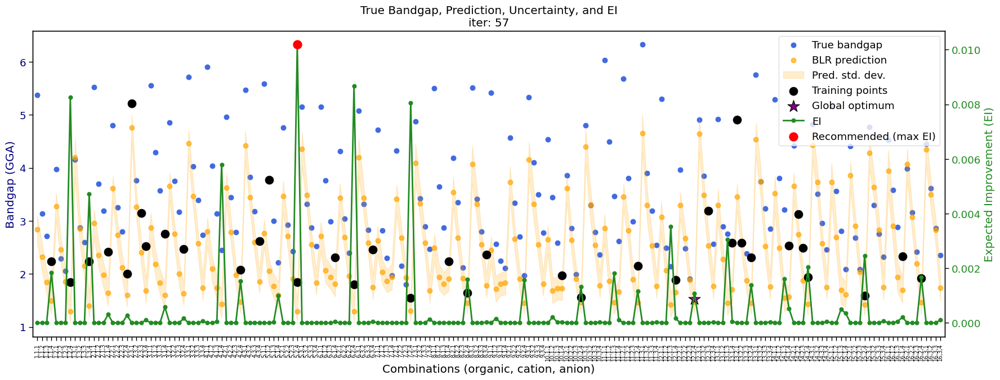

R² score: 0.1141
MAE: 0.8290


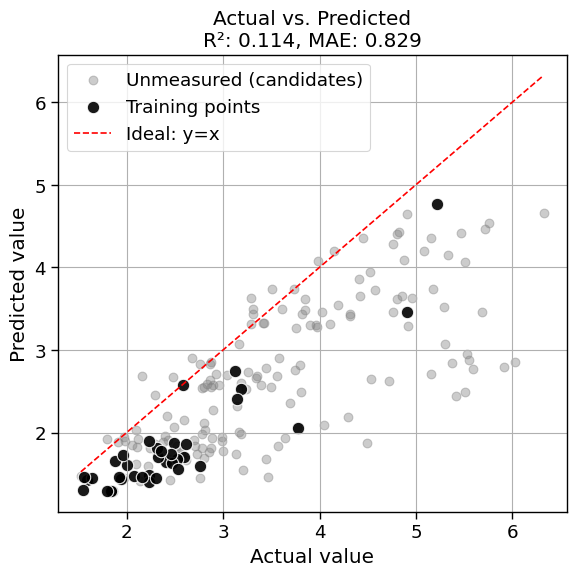

Measurement: 1.2672 (fidelity=0.1)
Cumulative cost: 11.999999999999991, best_so_far: 1.5849

==== Iteration 58 ====
EI-based recommended label: [7, 2, 4]


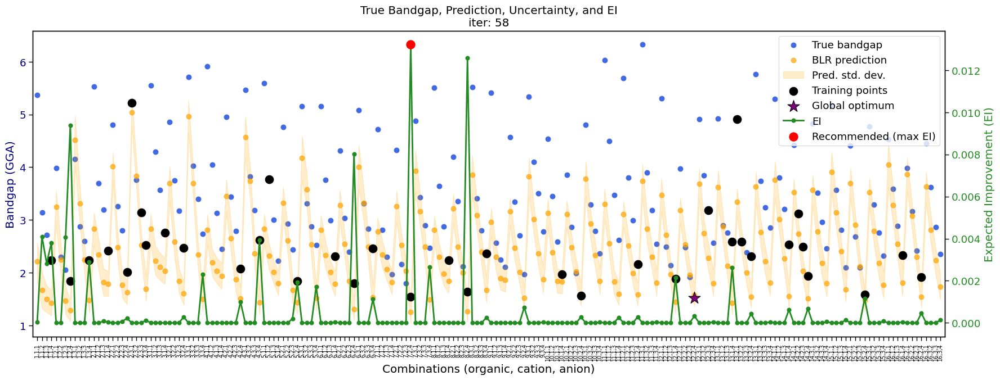

R² score: 0.1026
MAE: 0.8611


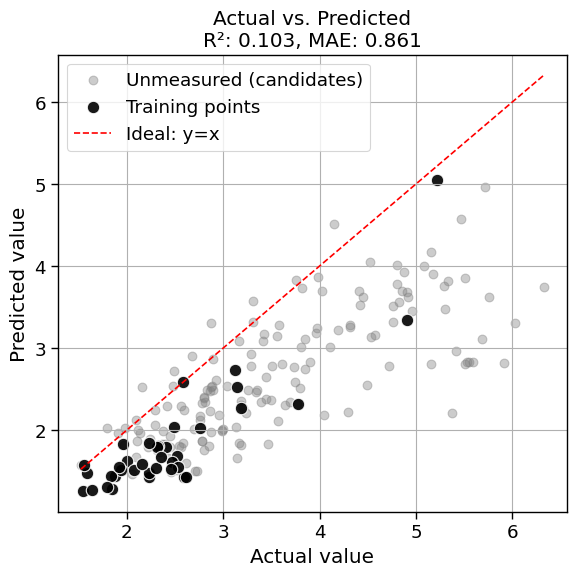

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 12.09999999999999, best_so_far: 1.5849

==== Iteration 59 ====
EI-based recommended label: [7, 3, 4]


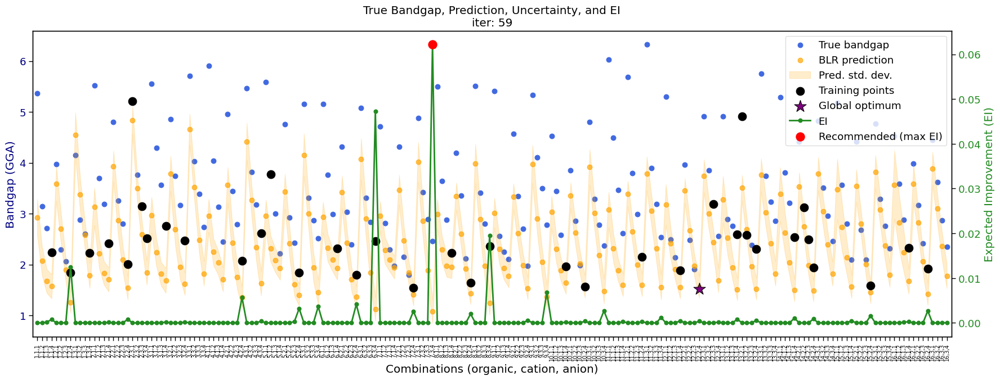

R² score: 0.1150
MAE: 0.8782


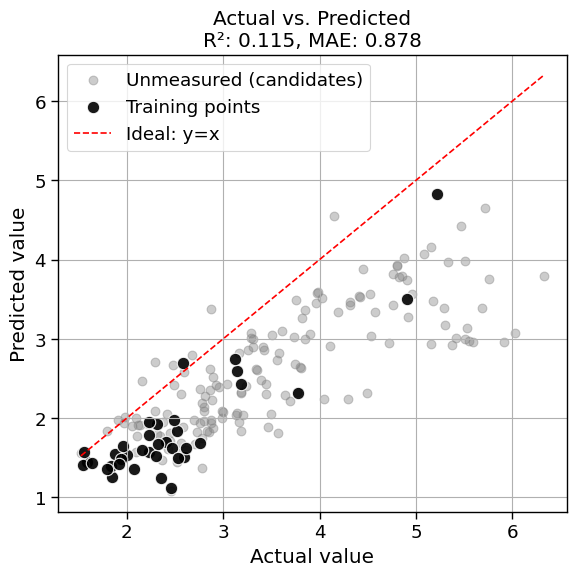

Measurement: 1.7543 (fidelity=0.1)
Cumulative cost: 12.19999999999999, best_so_far: 1.5849

==== Iteration 60 ====
EI-based recommended label: [1, 2, 4]


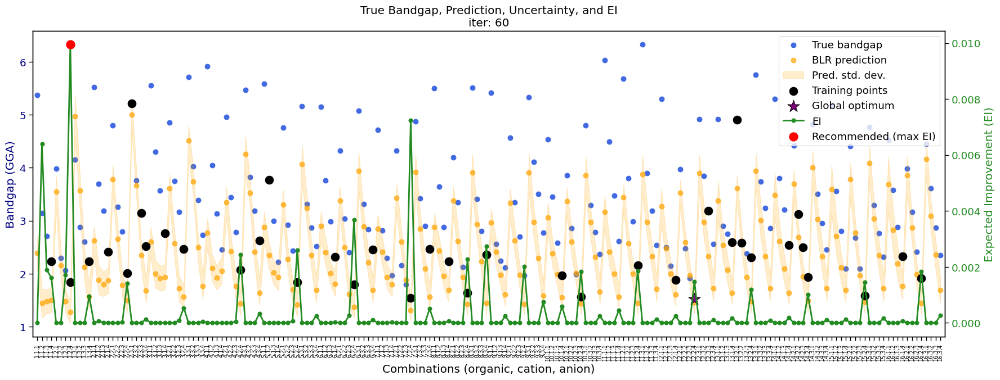

R² score: 0.0832
MAE: 0.8817


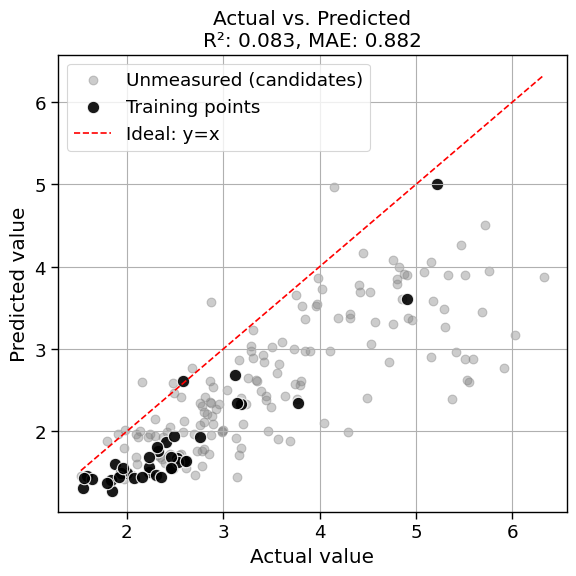

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 12.29999999999999, best_so_far: 1.5849

==== Iteration 61 ====
EI-based recommended label: [1, 2, 4]


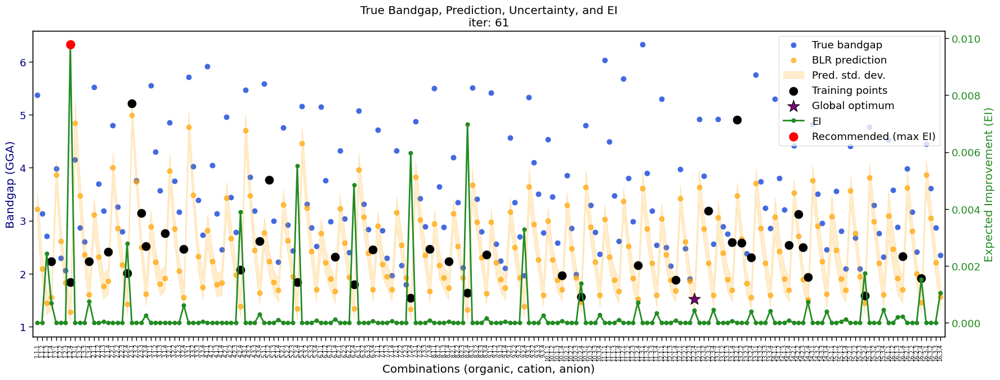

R² score: 0.0514
MAE: 0.9064


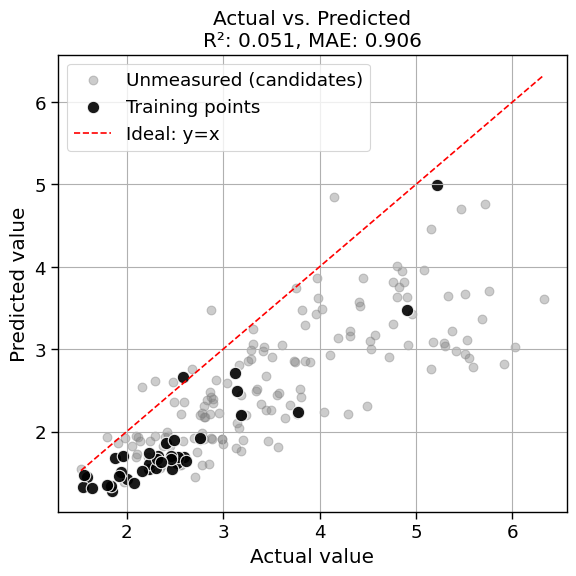

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 12.39999999999999, best_so_far: 1.5849

==== Iteration 62 ====
EI-based recommended label: [2, 2, 4]


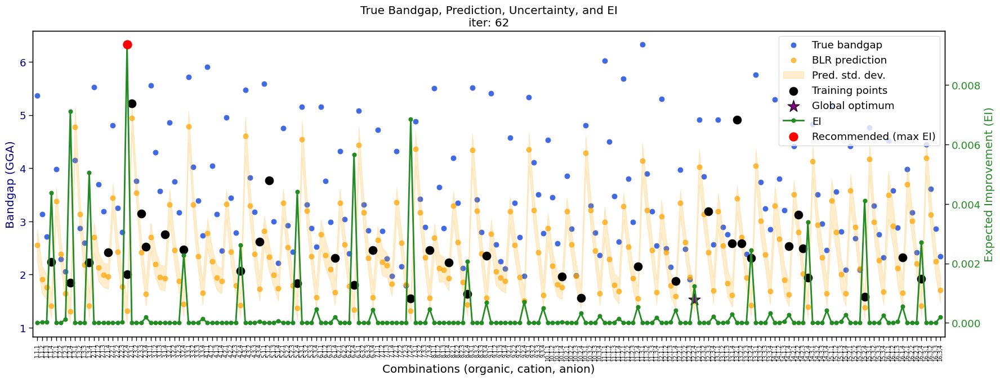

R² score: 0.0855
MAE: 0.8710


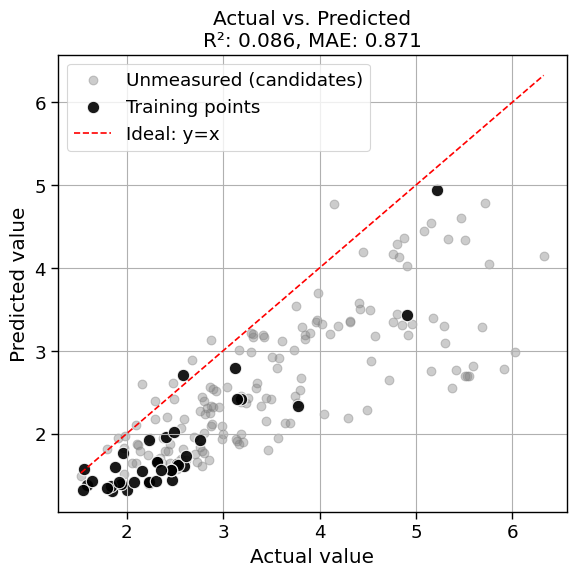

Measurement: 1.3516 (fidelity=0.1)
Cumulative cost: 12.49999999999999, best_so_far: 1.5849

==== Iteration 63 ====
EI-based recommended label: [7, 2, 4]


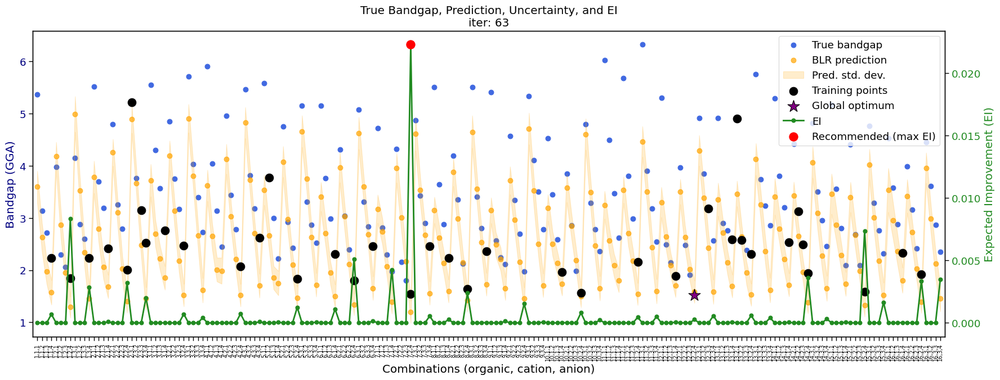

R² score: 0.3975
MAE: 0.7096


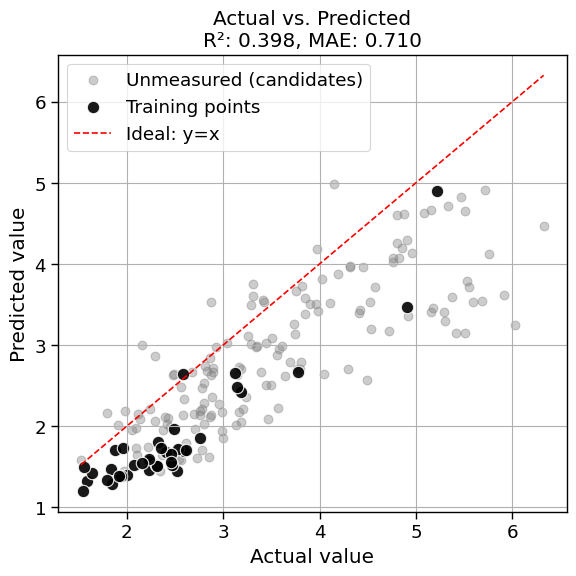

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 12.599999999999989, best_so_far: 1.5849

==== Iteration 64 ====
EI-based recommended label: [7, 2, 4]


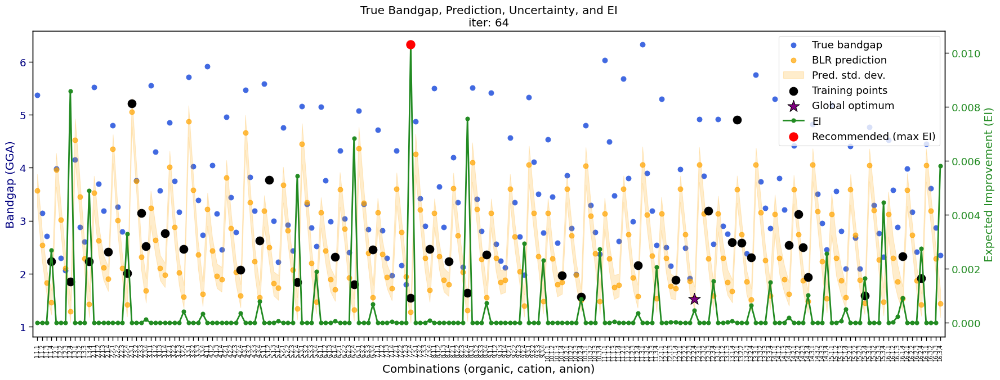

R² score: 0.2225
MAE: 0.8207


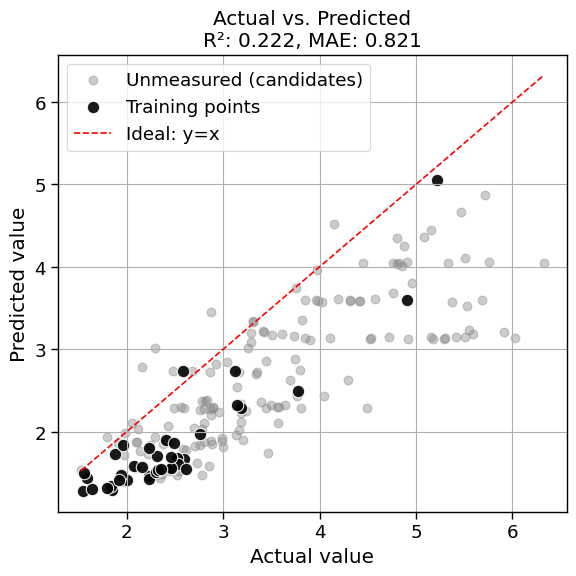

Measurement: 1.5456 (fidelity=1.0)
Cumulative cost: 13.599999999999989, best_so_far: 1.5456

==== Iteration 65 ====
EI-based recommended label: [9, 2, 4]


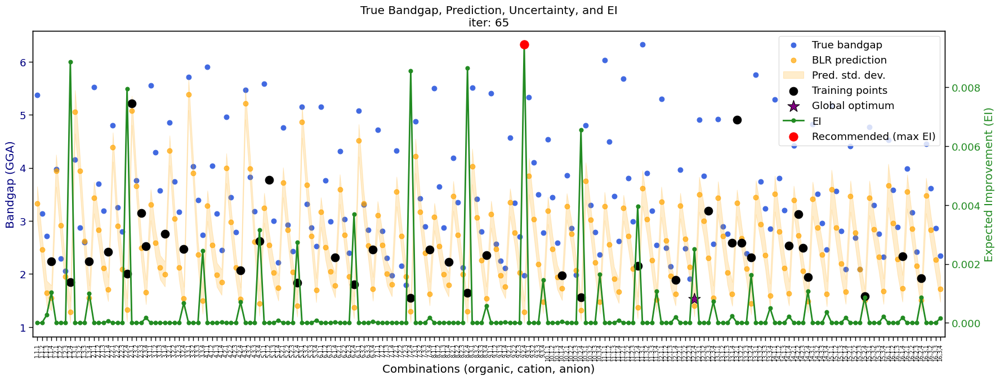

R² score: 0.2434
MAE: 0.7997


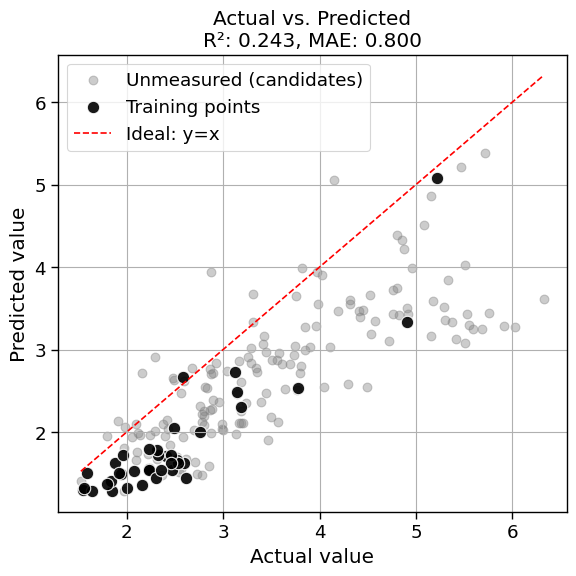

Measurement: 1.4861 (fidelity=0.1)
Cumulative cost: 13.699999999999989, best_so_far: 1.5456

==== Iteration 66 ====
EI-based recommended label: [7, 2, 4]


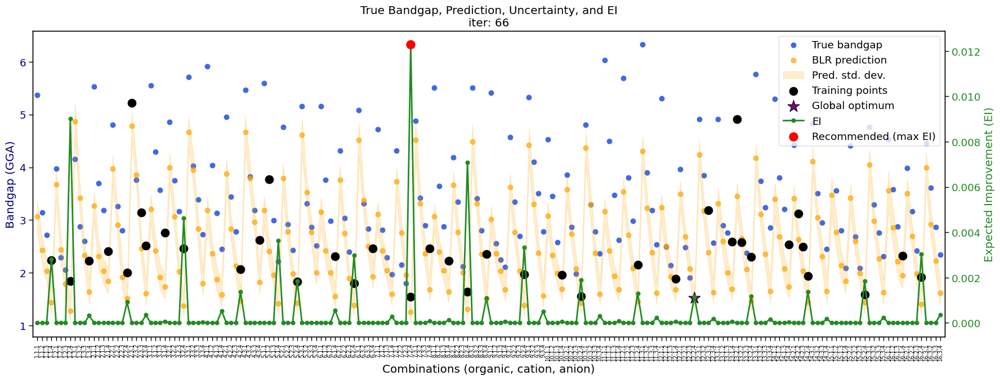

R² score: 0.2834
MAE: 0.7717


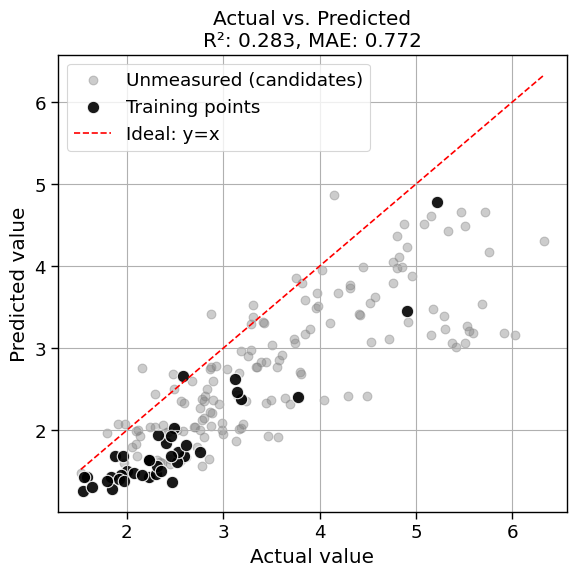

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 13.799999999999988, best_so_far: 1.5456

==== Iteration 67 ====
EI-based recommended label: [7, 2, 4]


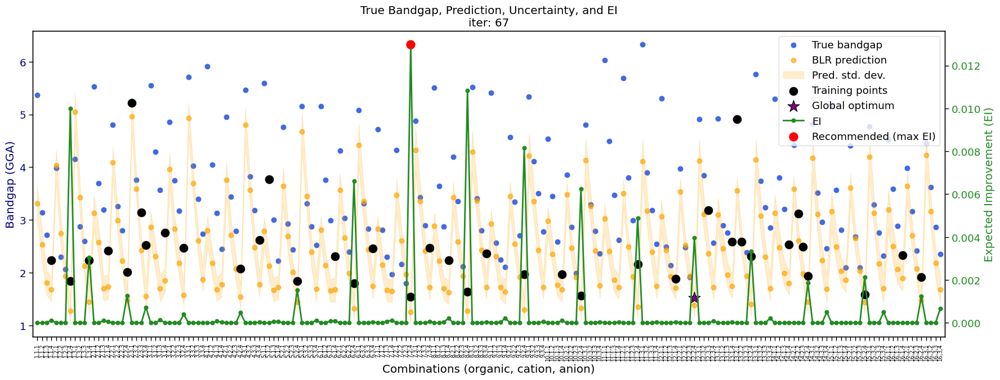

R² score: 0.1650
MAE: 0.8294


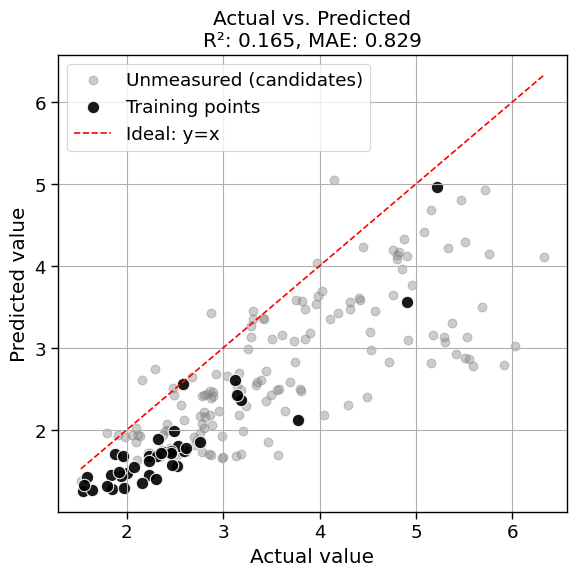

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 13.899999999999988, best_so_far: 1.5456

==== Iteration 68 ====
EI-based recommended label: [6, 2, 4]


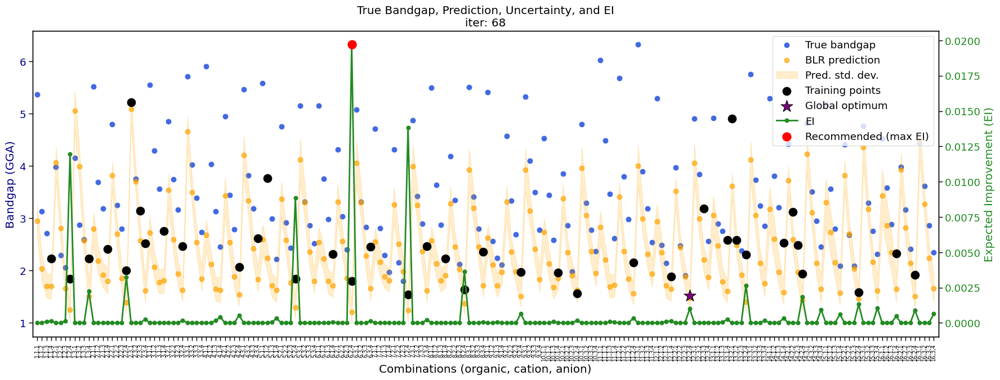

R² score: 0.0407
MAE: 0.8842


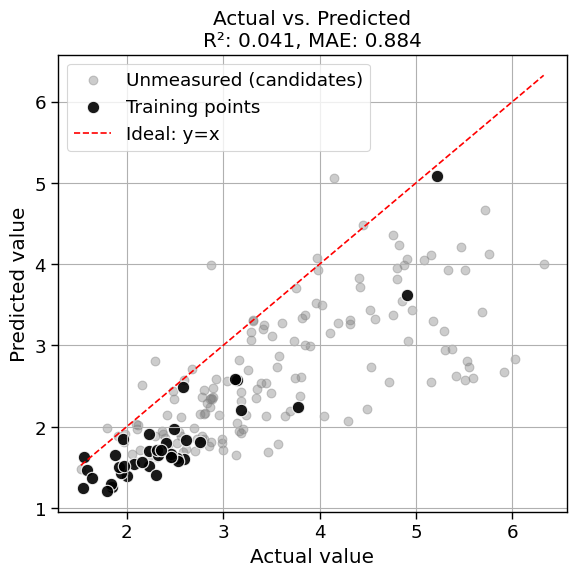

Measurement: 1.2292 (fidelity=0.1)
Cumulative cost: 13.999999999999988, best_so_far: 1.5456

==== Iteration 69 ====
EI-based recommended label: [1, 2, 4]


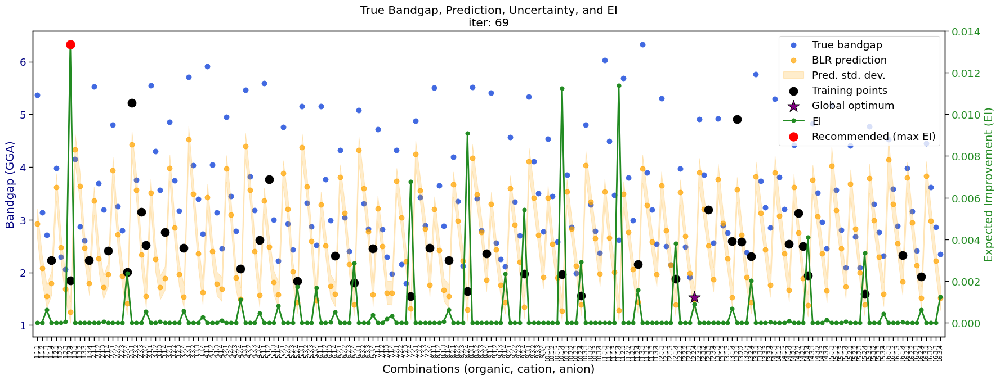

R² score: 0.3098
MAE: 0.7657


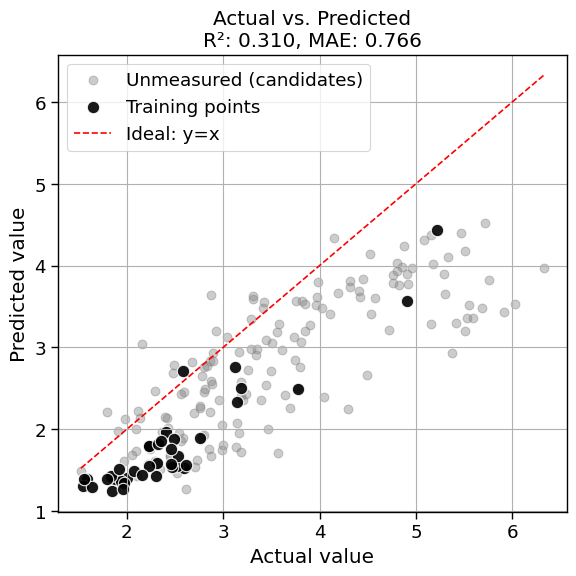

Measurement: 1.2713 (fidelity=0.1)
Cumulative cost: 14.099999999999987, best_so_far: 1.5456

==== Iteration 70 ====
EI-based recommended label: [1, 2, 3]


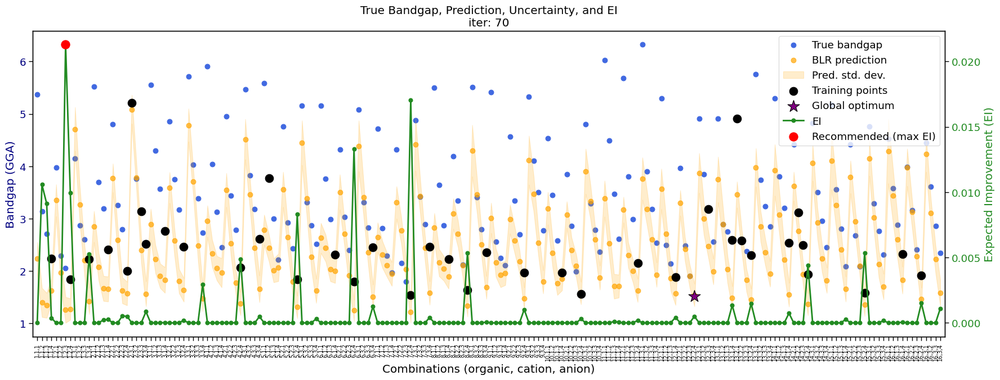

R² score: 0.1589
MAE: 0.8169


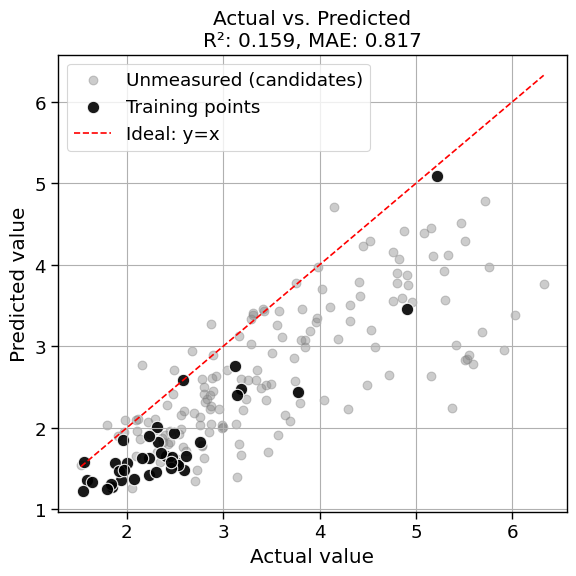

Measurement: 1.3219 (fidelity=0.1)
Cumulative cost: 14.199999999999987, best_so_far: 1.5456

==== Iteration 71 ====
EI-based recommended label: [6, 2, 4]


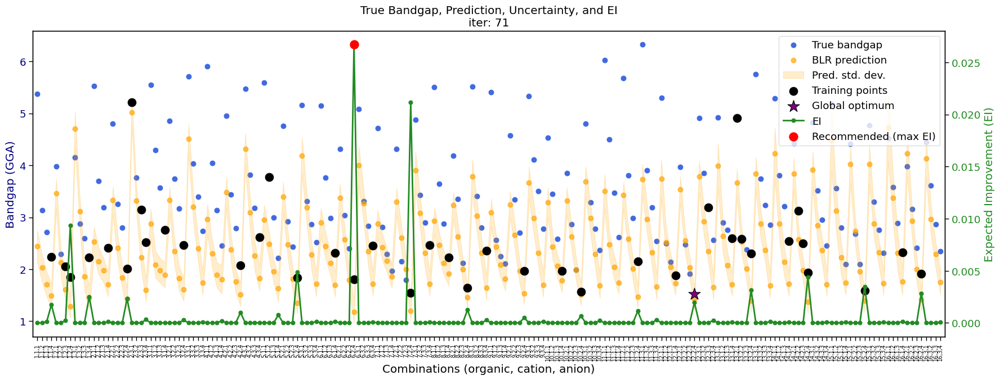

R² score: 0.1576
MAE: 0.8433


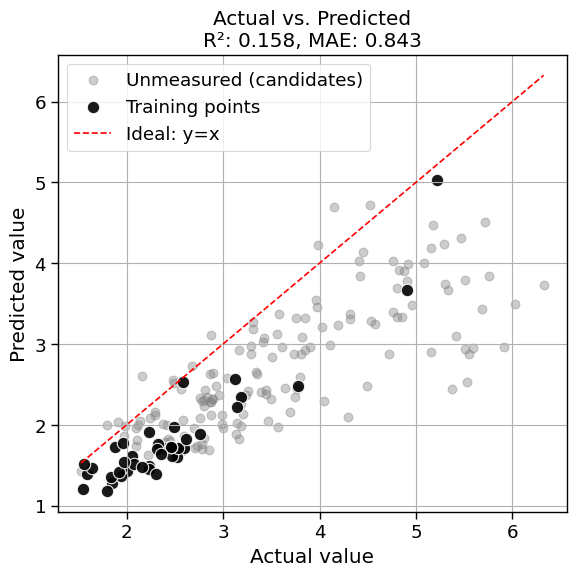

Measurement: 1.2292 (fidelity=0.1)
Cumulative cost: 14.299999999999986, best_so_far: 1.5456

==== Iteration 72 ====
EI-based recommended label: [7, 2, 4]


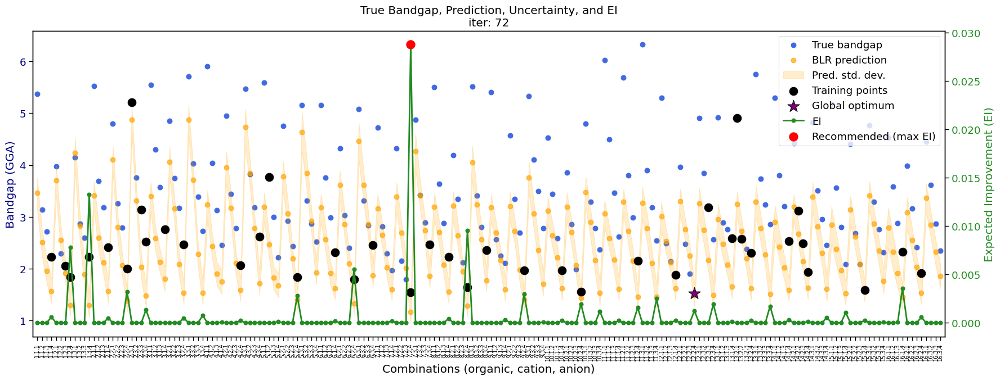

R² score: 0.1482
MAE: 0.8442


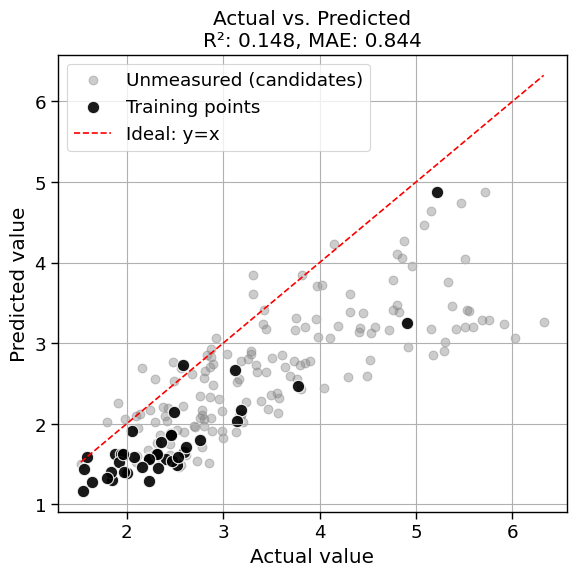

Measurement: 1.5456 (fidelity=1.0)
Cumulative cost: 15.299999999999986, best_so_far: 1.5456

==== Iteration 73 ====
EI-based recommended label: [7, 2, 4]


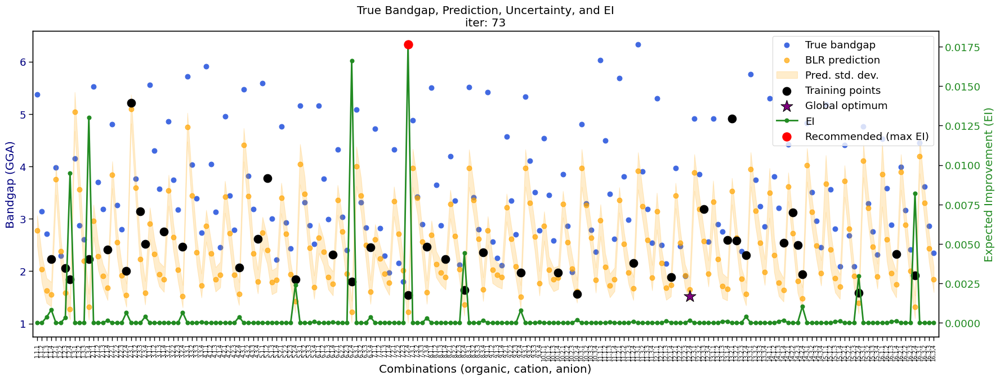

R² score: 0.1117
MAE: 0.8498


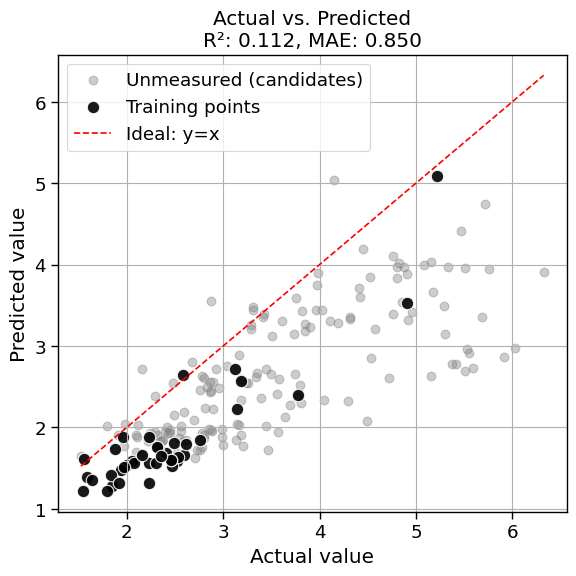

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 15.399999999999986, best_so_far: 1.5456

==== Iteration 74 ====
EI-based recommended label: [7, 2, 4]


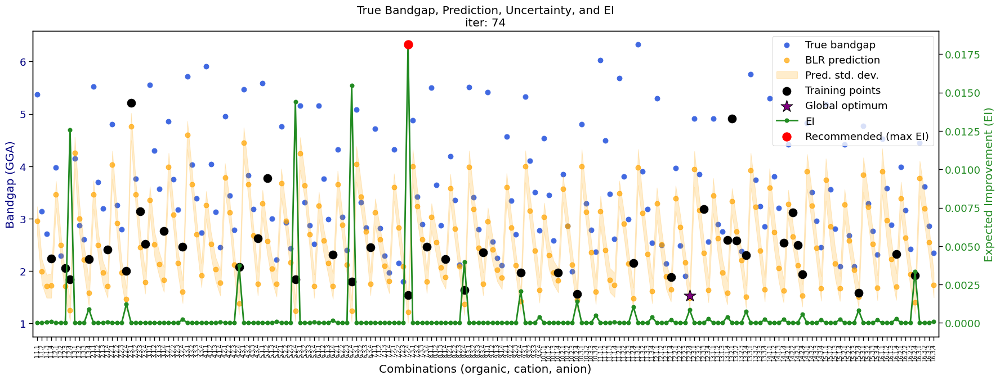

R² score: 0.2804
MAE: 0.7728


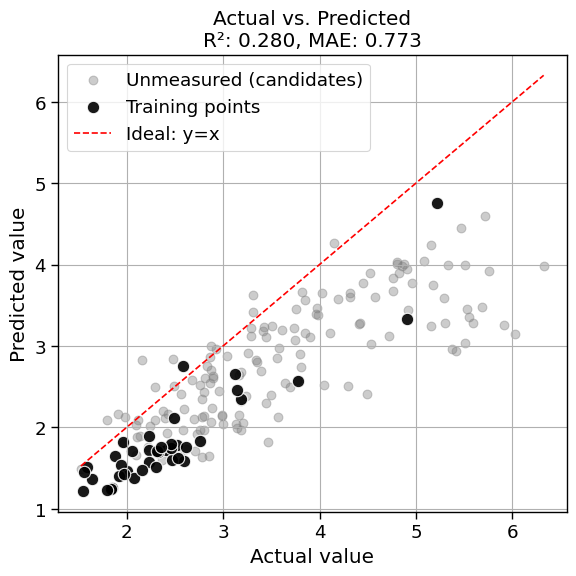

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 15.499999999999986, best_so_far: 1.5456

==== Iteration 75 ====
EI-based recommended label: [7, 2, 4]


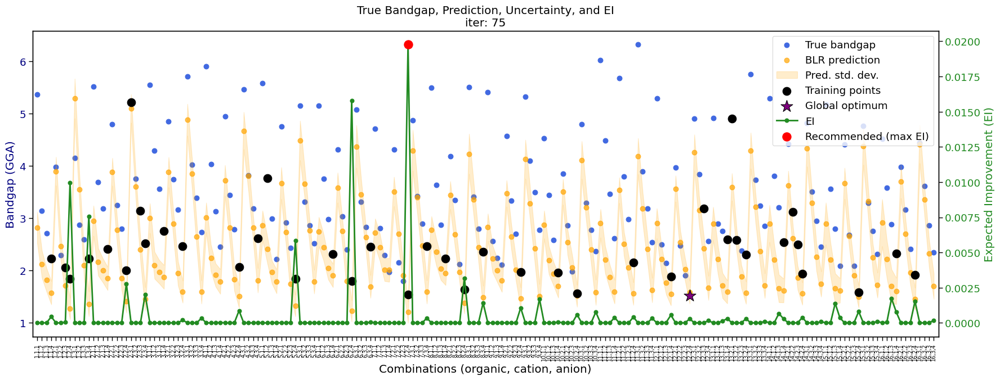

R² score: 0.1233
MAE: 0.8373


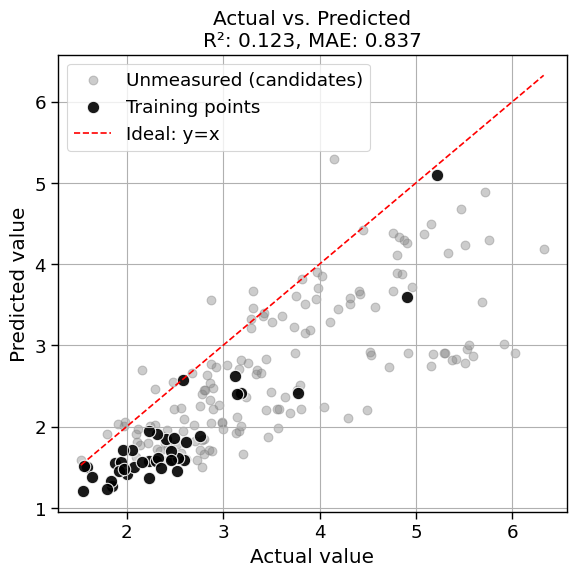

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 15.599999999999985, best_so_far: 1.5456

==== Iteration 76 ====
EI-based recommended label: [7, 2, 4]


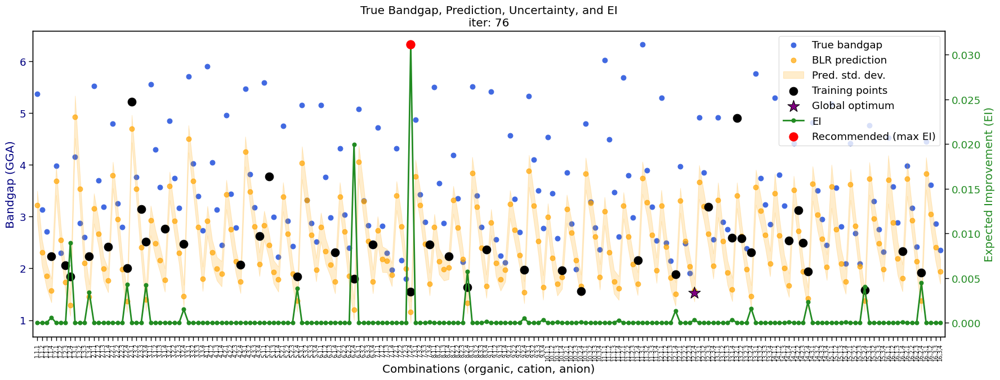

R² score: 0.1695
MAE: 0.8199


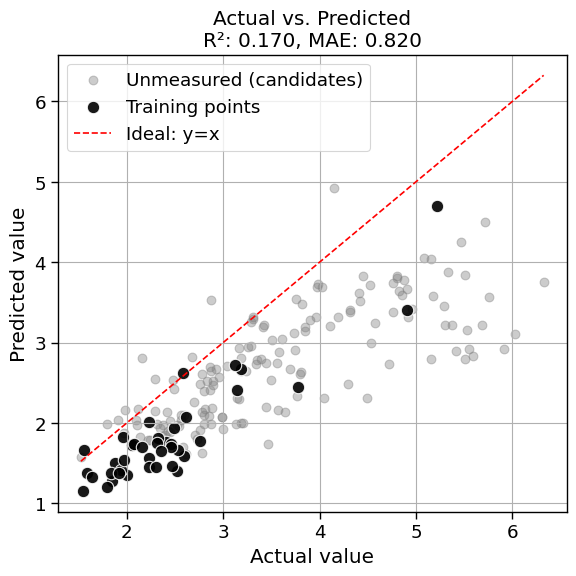

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 15.699999999999985, best_so_far: 1.5456

==== Iteration 77 ====
EI-based recommended label: [7, 2, 4]


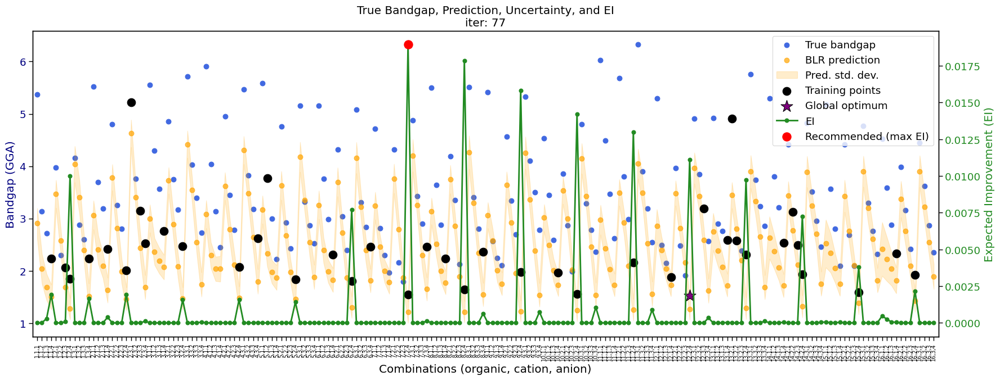

R² score: 0.1728
MAE: 0.8178


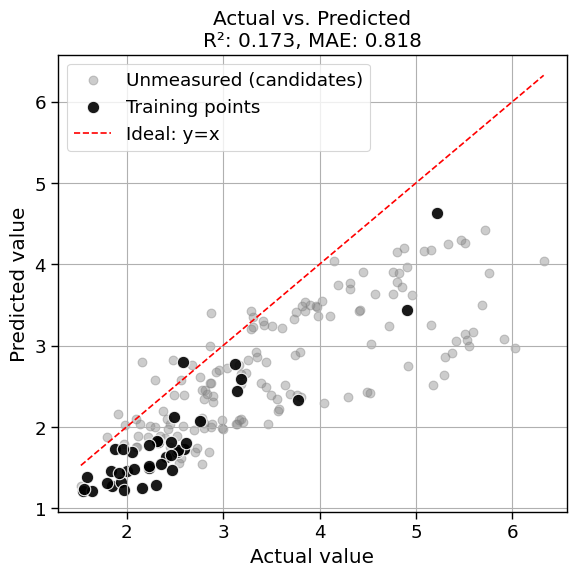

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 15.799999999999985, best_so_far: 1.5456

==== Iteration 78 ====
EI-based recommended label: [7, 2, 4]


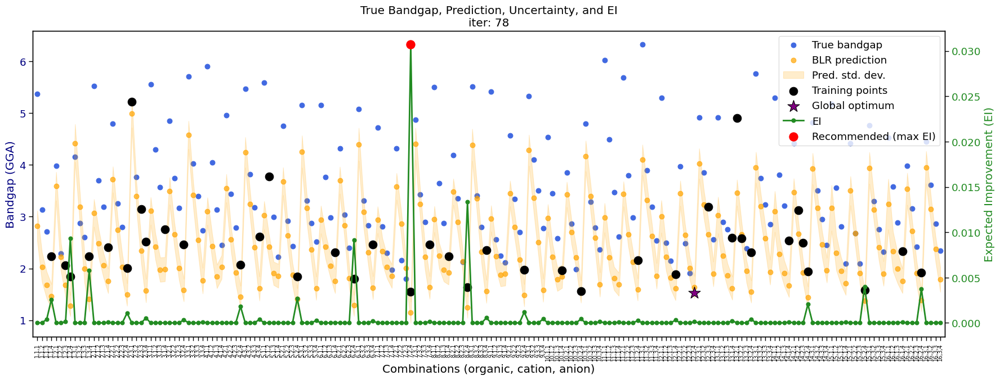

R² score: 0.1708
MAE: 0.8331


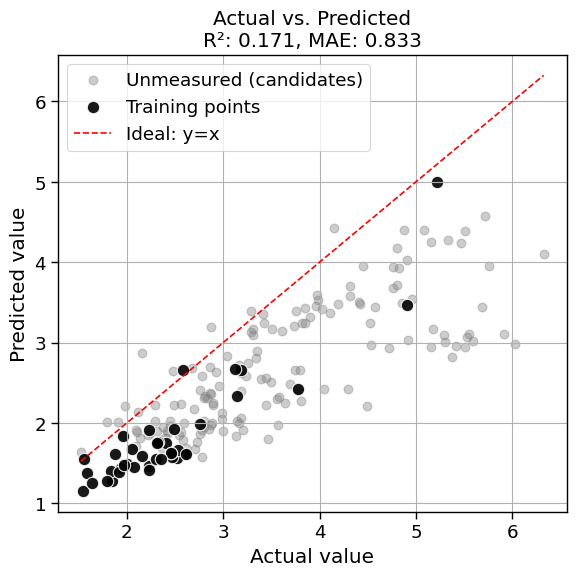

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 15.899999999999984, best_so_far: 1.5456

==== Iteration 79 ====
EI-based recommended label: [7, 2, 4]


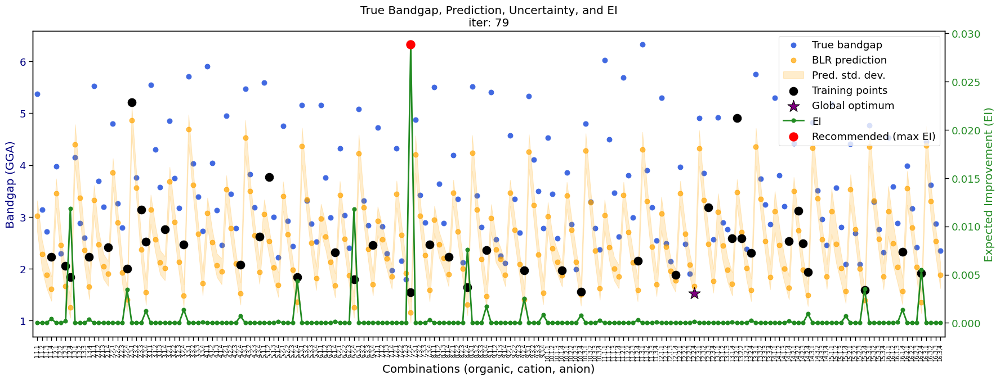

R² score: 0.2426
MAE: 0.7848


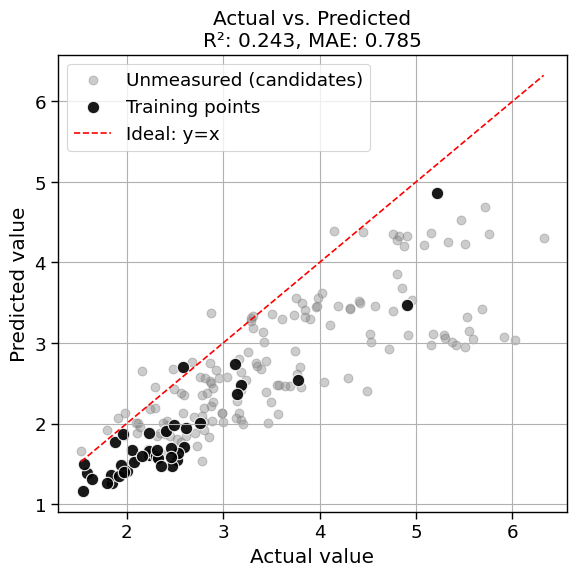

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 15.999999999999984, best_so_far: 1.5456

==== Iteration 80 ====
EI-based recommended label: [7, 2, 4]


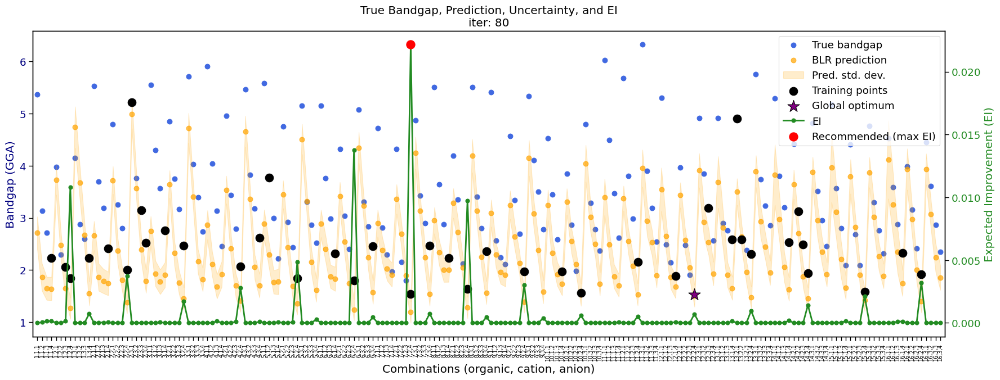

R² score: 0.1548
MAE: 0.8409


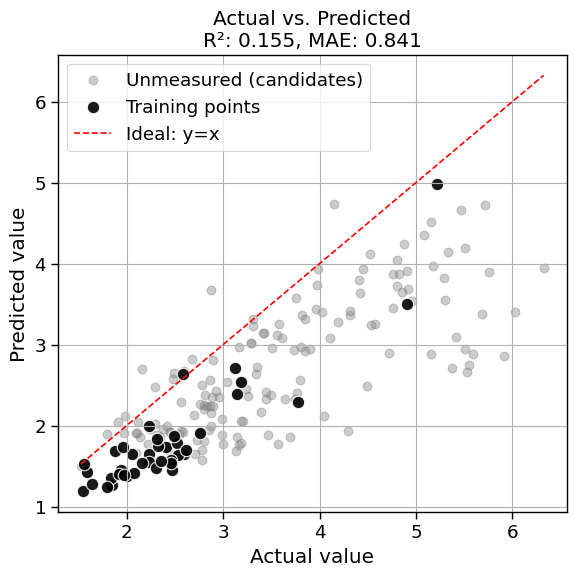

Measurement: 1.5456 (fidelity=1.0)
Cumulative cost: 16.999999999999986, best_so_far: 1.5456

==== Iteration 81 ====
EI-based recommended label: [7, 2, 4]


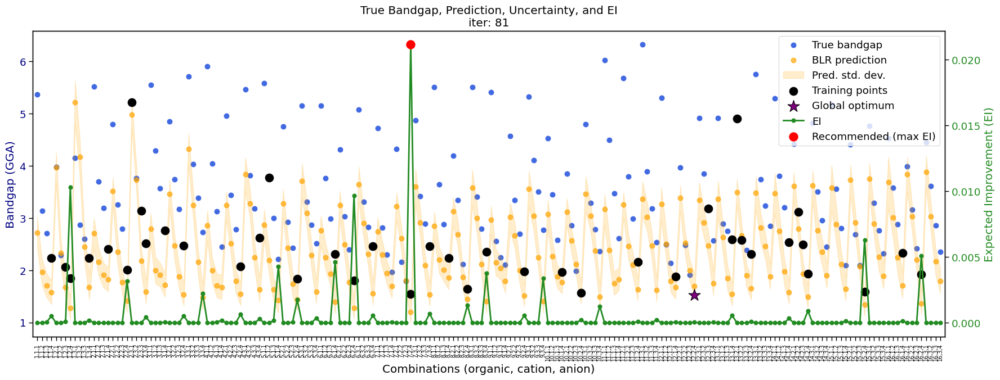

R² score: -0.0131
MAE: 0.9341


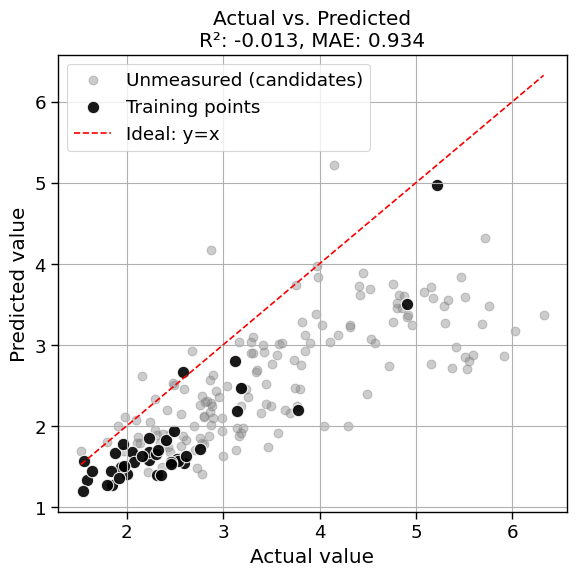

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 17.099999999999987, best_so_far: 1.5456

==== Iteration 82 ====
EI-based recommended label: [7, 2, 4]


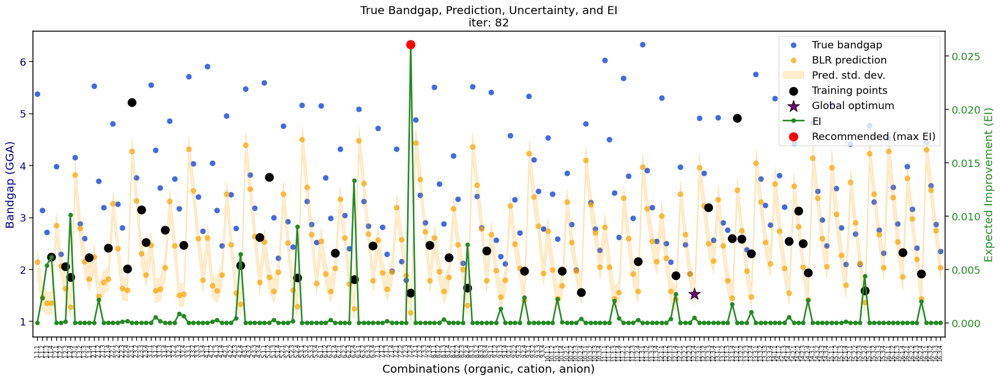

R² score: -0.0210
MAE: 0.8743


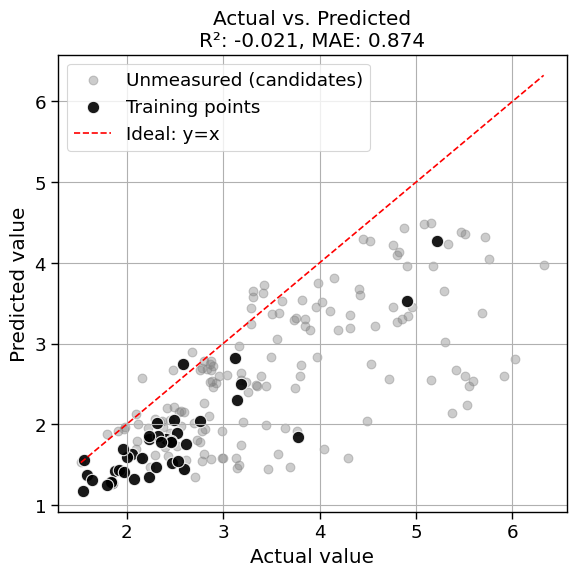

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 17.19999999999999, best_so_far: 1.5456

==== Iteration 83 ====
EI-based recommended label: [6, 2, 4]


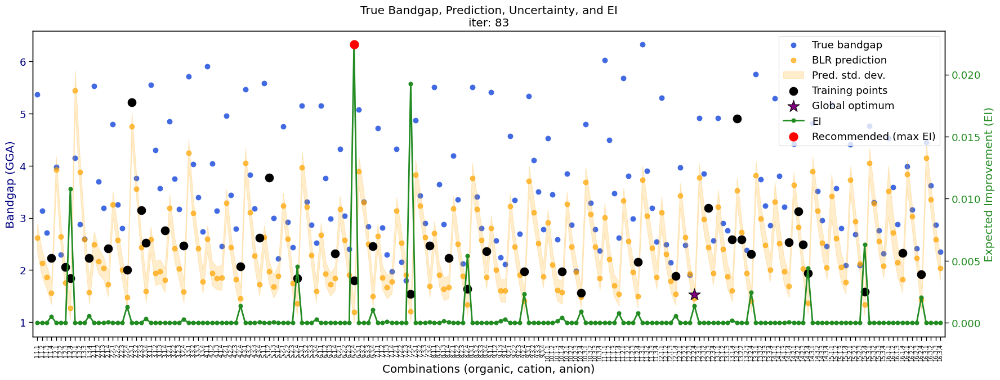

R² score: -0.0184
MAE: 0.9139


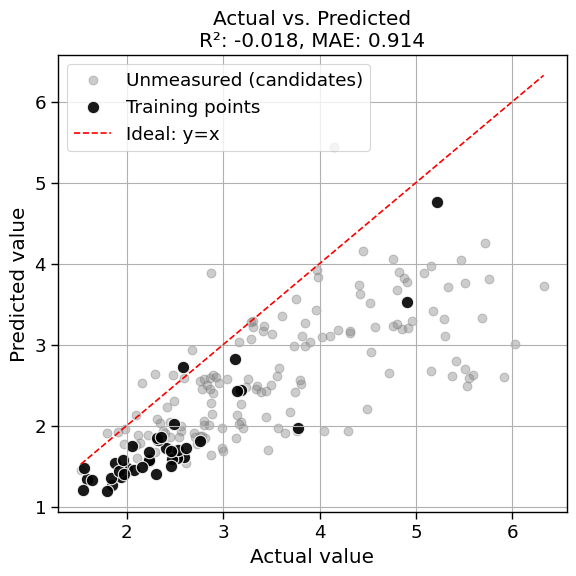

Measurement: 1.2292 (fidelity=0.1)
Cumulative cost: 17.29999999999999, best_so_far: 1.5456

==== Iteration 84 ====
EI-based recommended label: [7, 2, 4]


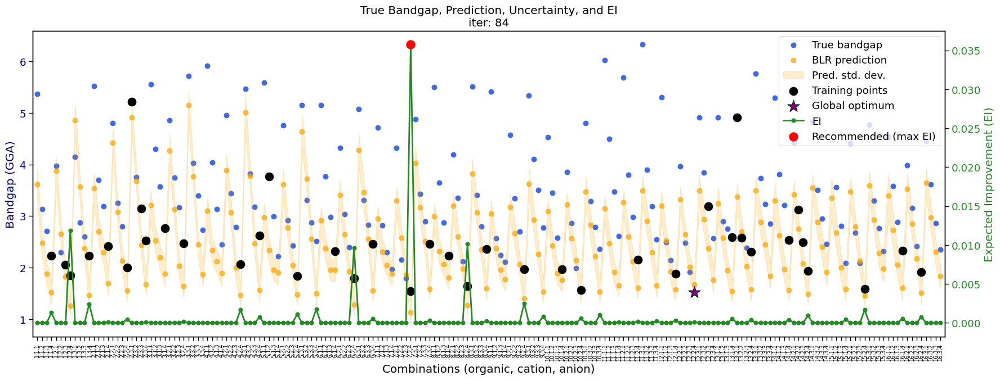

R² score: 0.1921
MAE: 0.8236


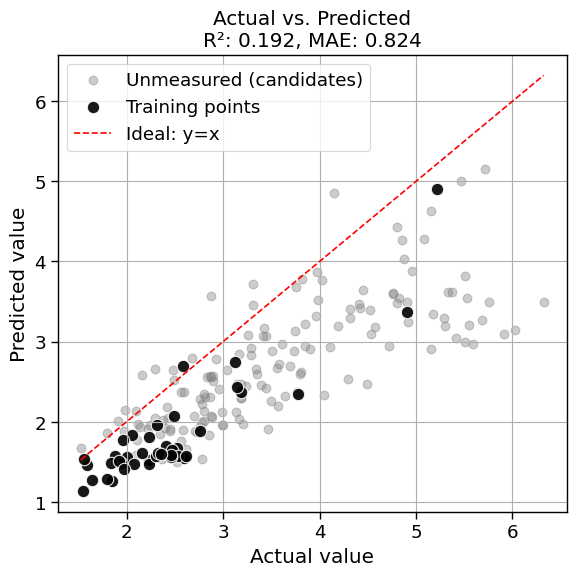

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 17.39999999999999, best_so_far: 1.5456

==== Iteration 85 ====
EI-based recommended label: [7, 2, 4]


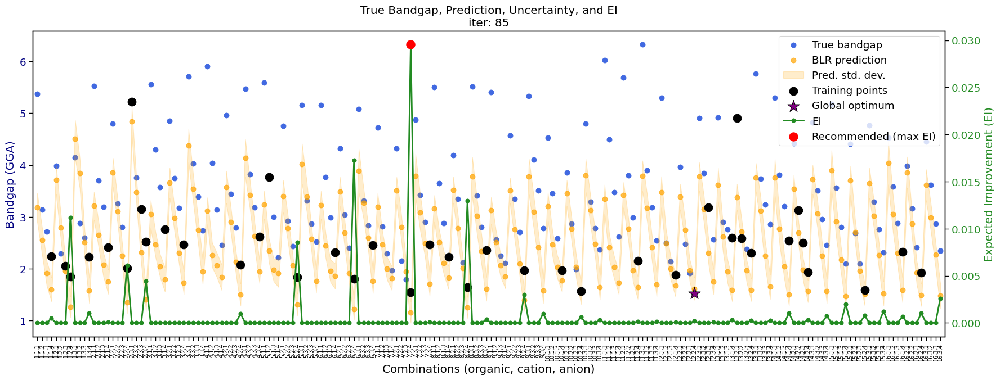

R² score: 0.2435
MAE: 0.8006


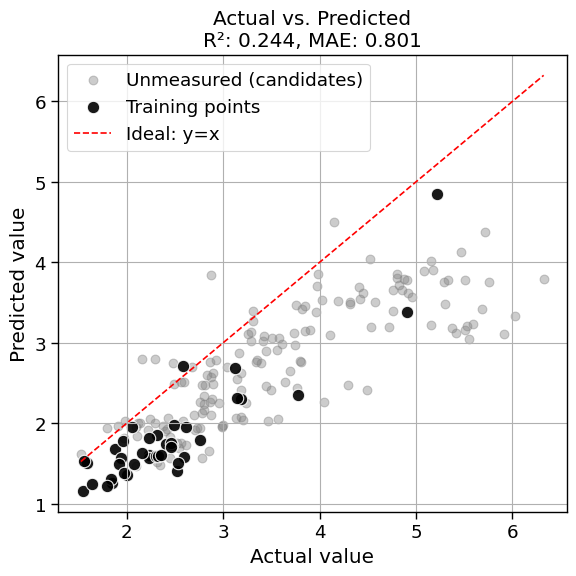

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 17.499999999999993, best_so_far: 1.5456

==== Iteration 86 ====
EI-based recommended label: [7, 2, 4]


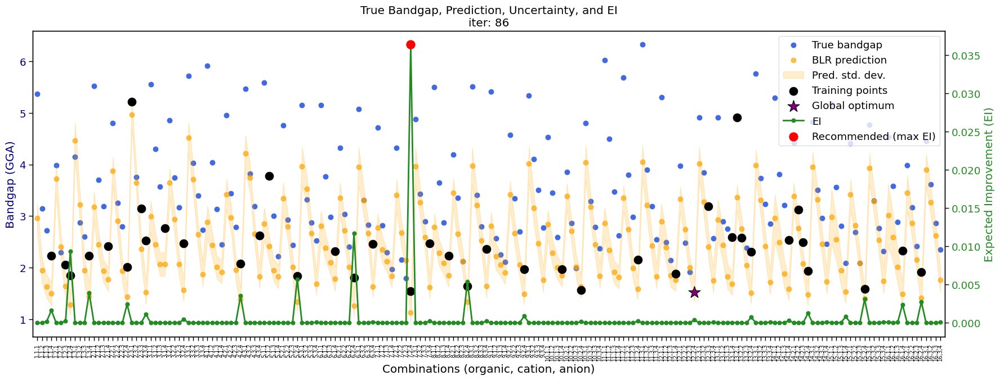

R² score: 0.1323
MAE: 0.8331


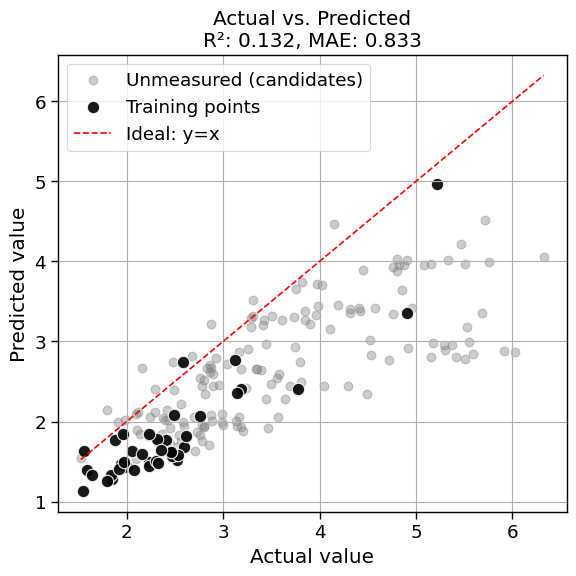

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 17.599999999999994, best_so_far: 1.5456

==== Iteration 87 ====
EI-based recommended label: [7, 2, 4]


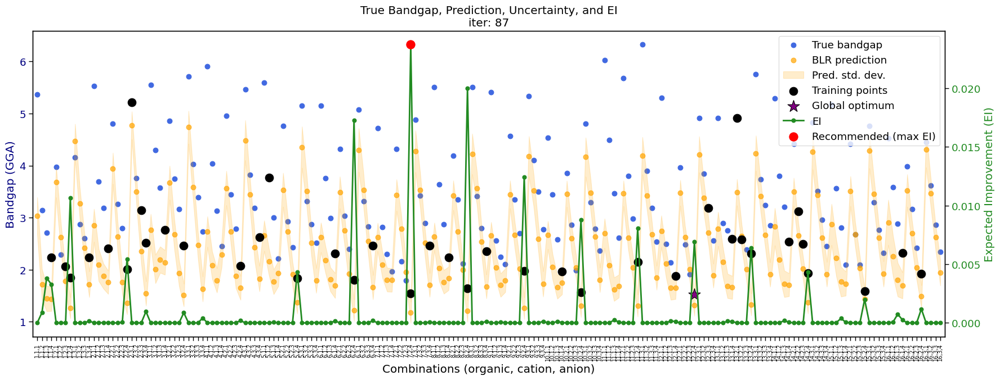

R² score: 0.0546
MAE: 0.8608


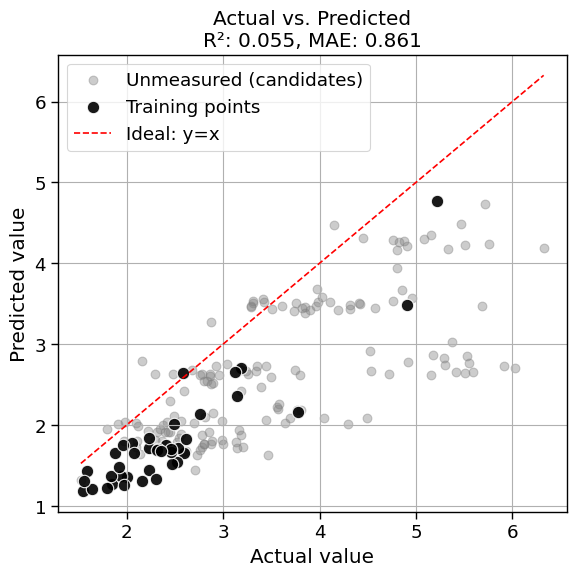

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 17.699999999999996, best_so_far: 1.5456

==== Iteration 88 ====
EI-based recommended label: [6, 2, 4]


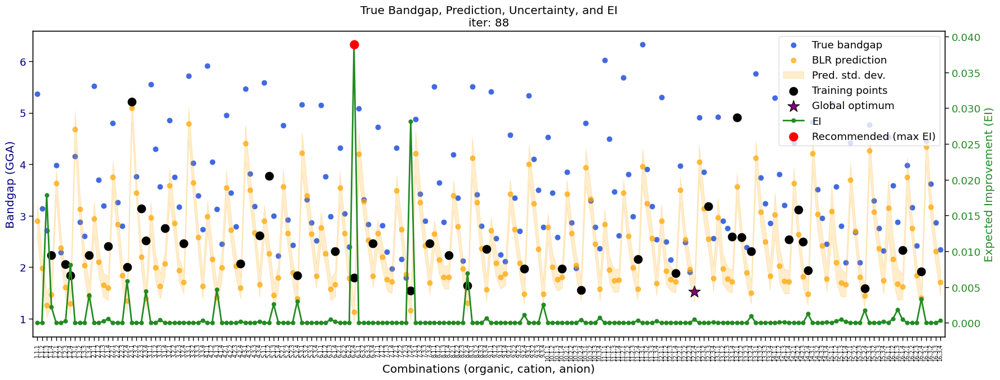

R² score: 0.0432
MAE: 0.8852


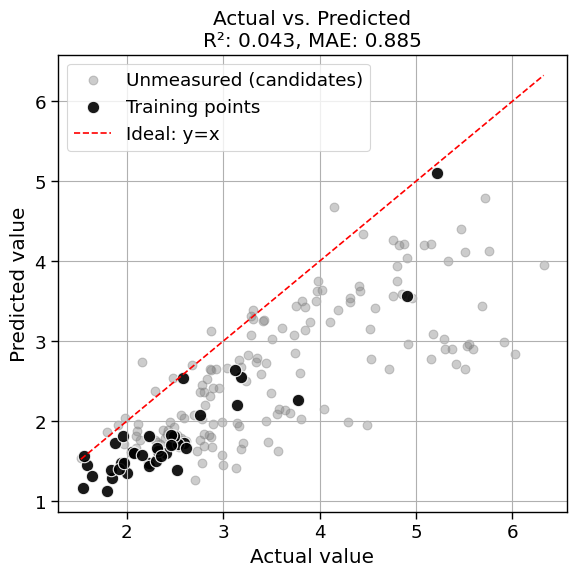

Measurement: 1.7999 (fidelity=1.0)
Cumulative cost: 18.699999999999996, best_so_far: 1.5456

==== Iteration 89 ====
EI-based recommended label: [7, 2, 4]


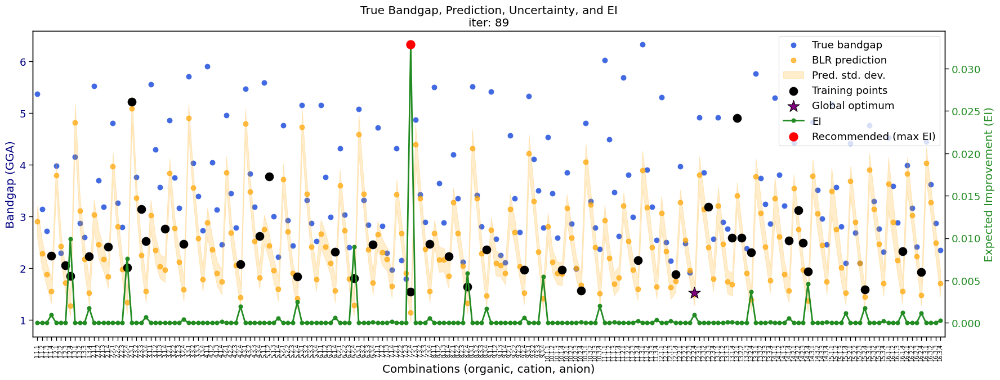

R² score: 0.1475
MAE: 0.8296


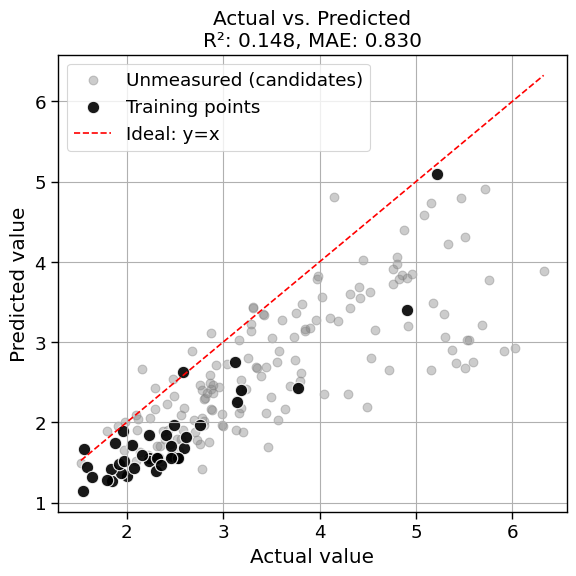

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 18.799999999999997, best_so_far: 1.5456

==== Iteration 90 ====
EI-based recommended label: [7, 2, 4]


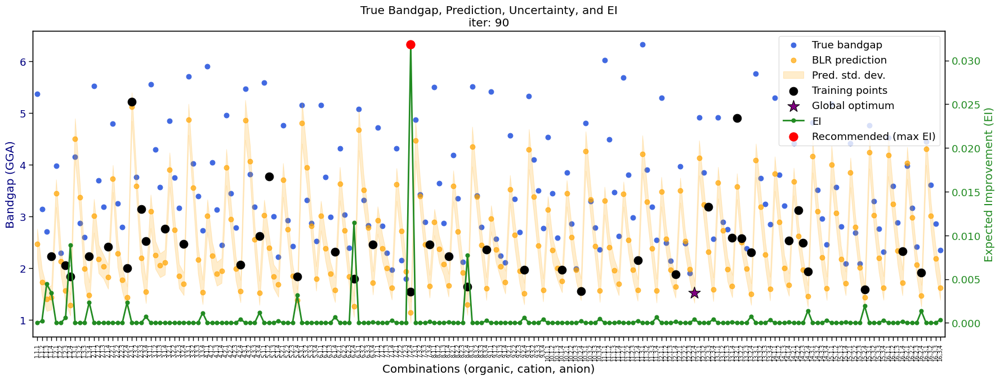

R² score: 0.2368
MAE: 0.7890


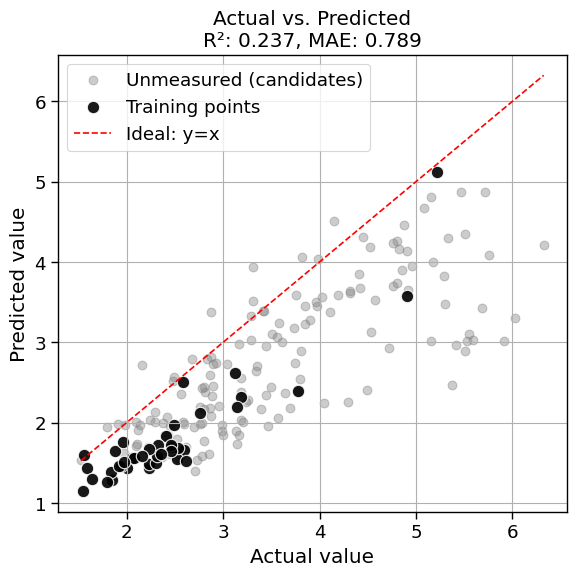

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 18.9, best_so_far: 1.5456

==== Iteration 91 ====
EI-based recommended label: [7, 2, 4]


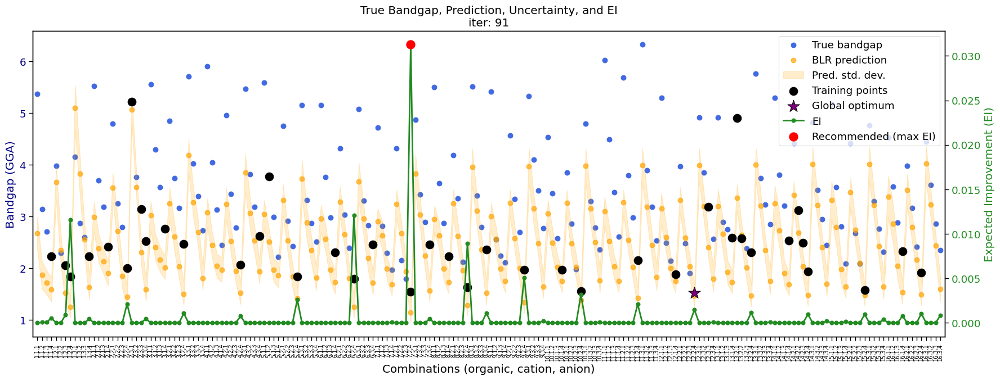

R² score: 0.1405
MAE: 0.8561


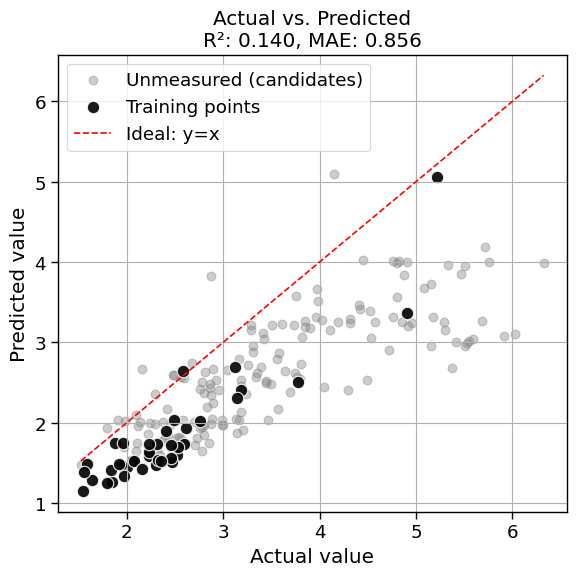

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 19.0, best_so_far: 1.5456

==== Iteration 92 ====
EI-based recommended label: [7, 2, 4]


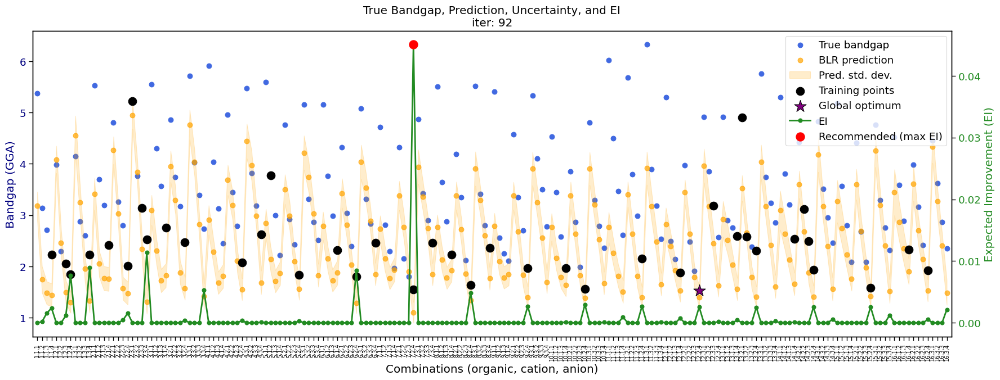

R² score: 0.1168
MAE: 0.8385


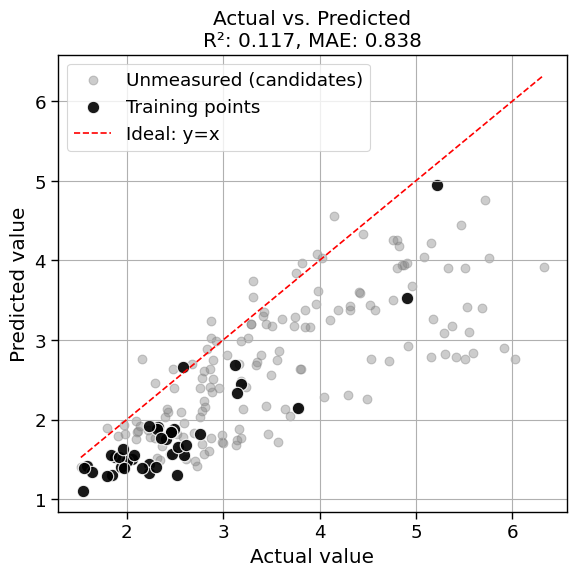

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 19.1, best_so_far: 1.5456

==== Iteration 93 ====
EI-based recommended label: [7, 2, 4]


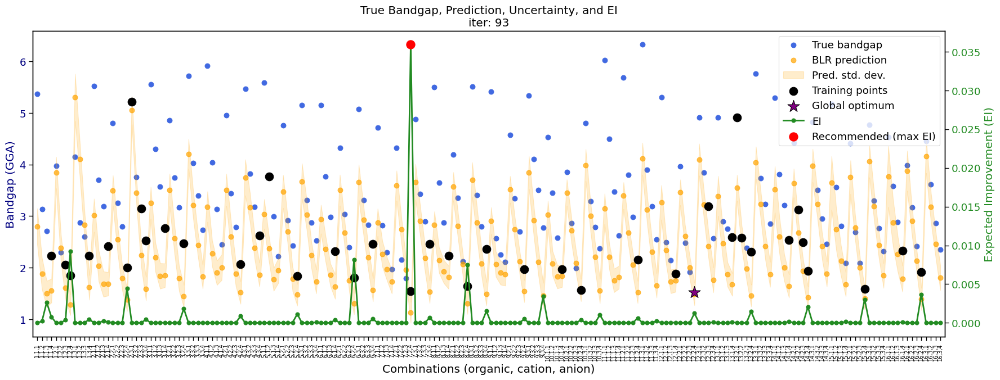

R² score: 0.1108
MAE: 0.8758


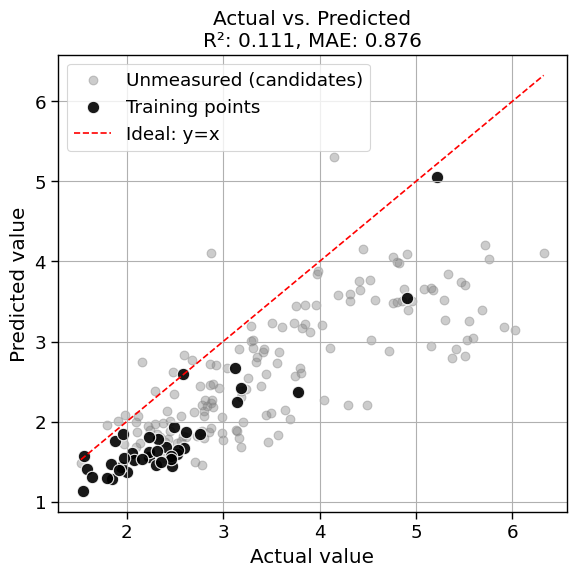

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 19.200000000000003, best_so_far: 1.5456

==== Iteration 94 ====
EI-based recommended label: [7, 2, 4]


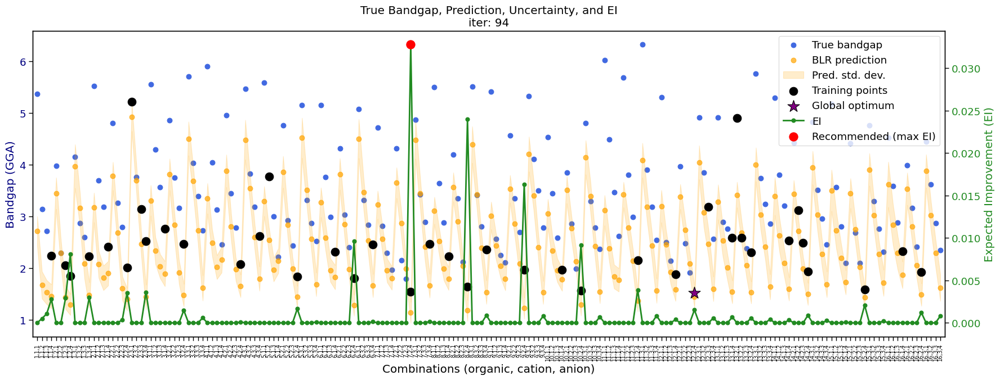

R² score: 0.2431
MAE: 0.7960


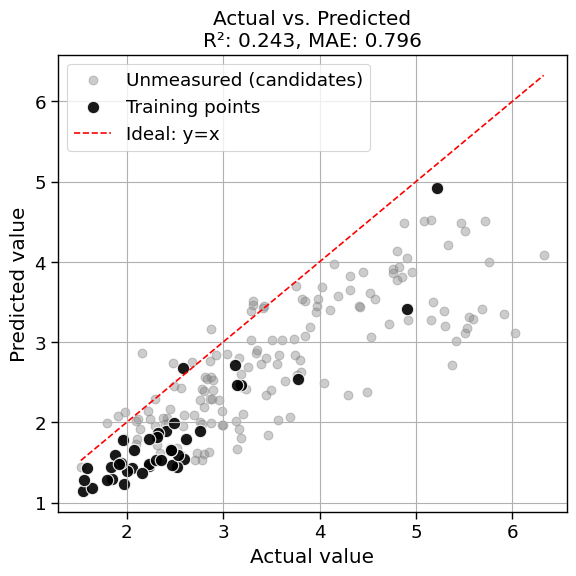

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 19.300000000000004, best_so_far: 1.5456

==== Iteration 95 ====
EI-based recommended label: [7, 2, 4]


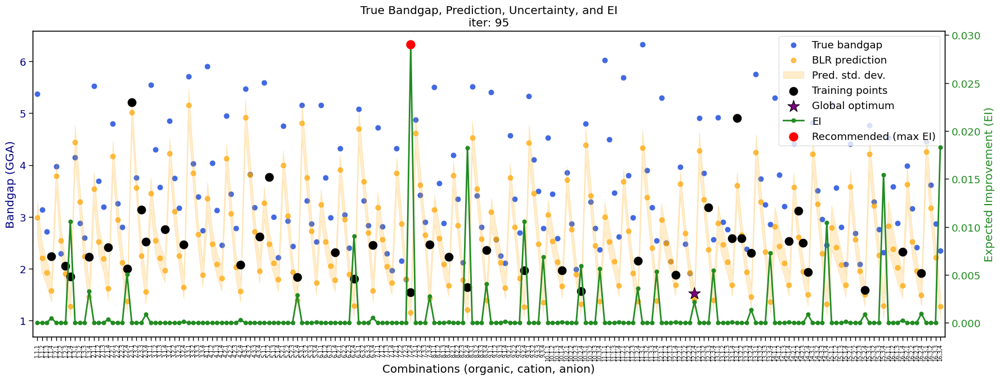

R² score: 0.2774
MAE: 0.7617


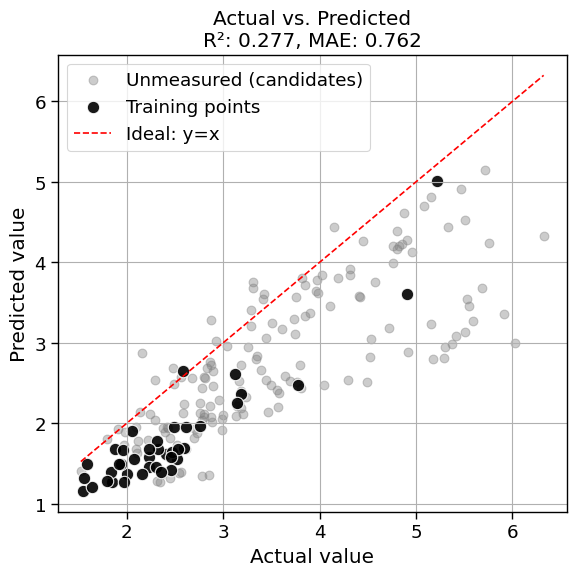

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 19.400000000000006, best_so_far: 1.5456

==== Iteration 96 ====
EI-based recommended label: [7, 2, 4]


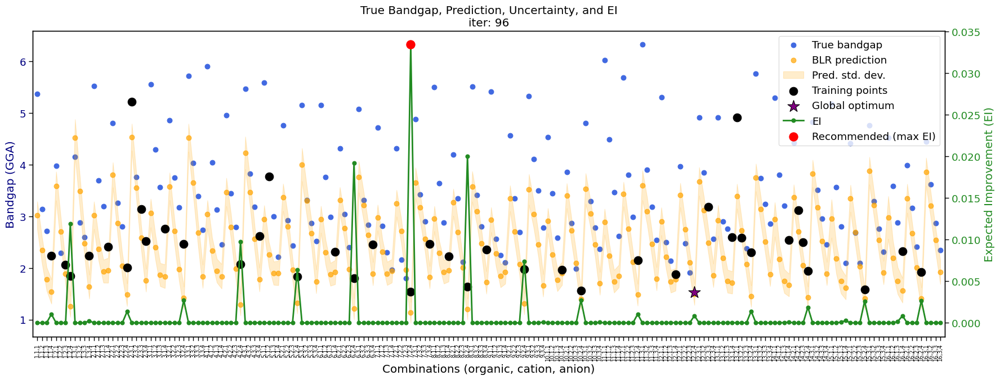

R² score: 0.0779
MAE: 0.8716


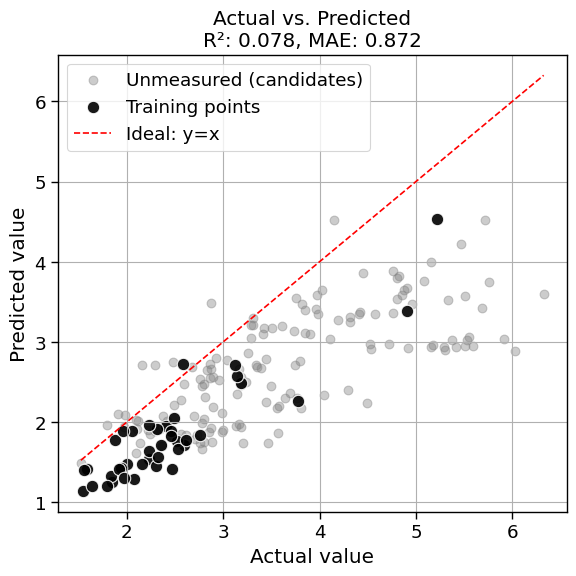

Measurement: 1.5456 (fidelity=1.0)
Cumulative cost: 20.400000000000006, best_so_far: 1.5456

==== Iteration 97 ====
EI-based recommended label: [8, 2, 4]


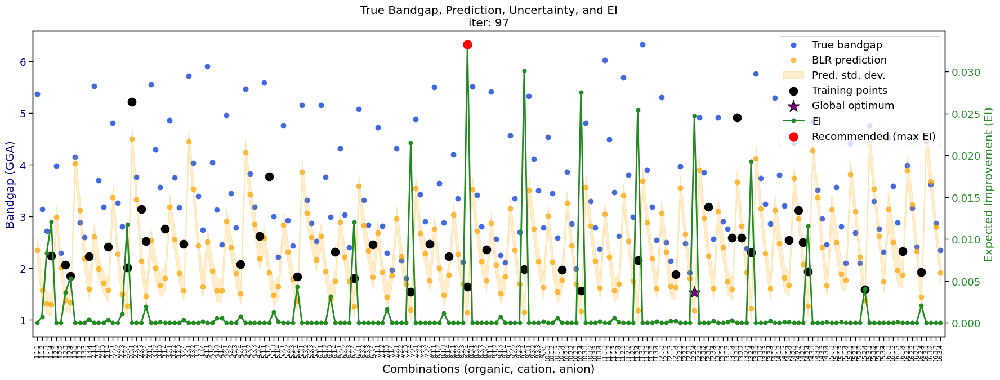

R² score: -0.1401
MAE: 0.9884


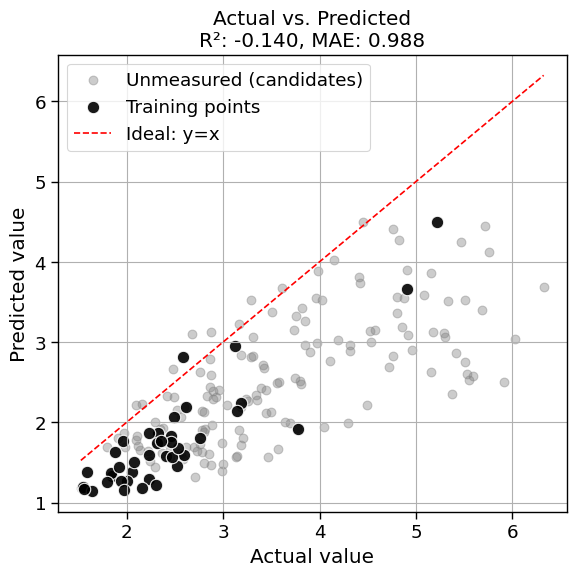

Measurement: 1.0856 (fidelity=0.1)
Cumulative cost: 20.500000000000007, best_so_far: 1.5456

==== Iteration 98 ====
EI-based recommended label: [7, 2, 4]


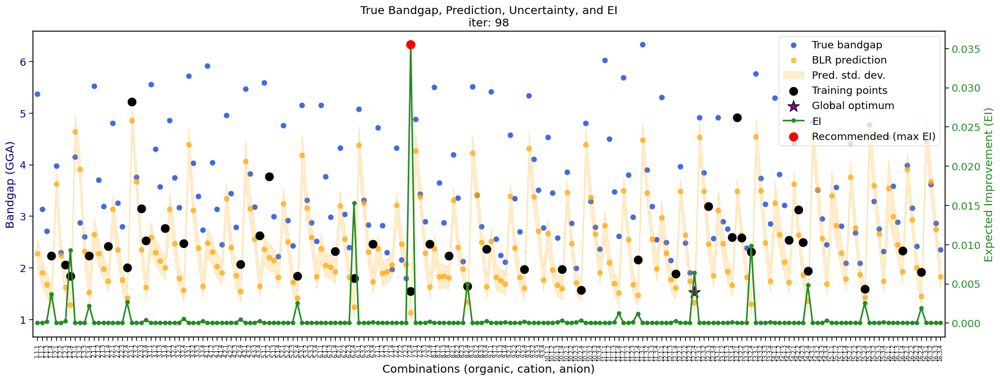

R² score: 0.0285
MAE: 0.8659


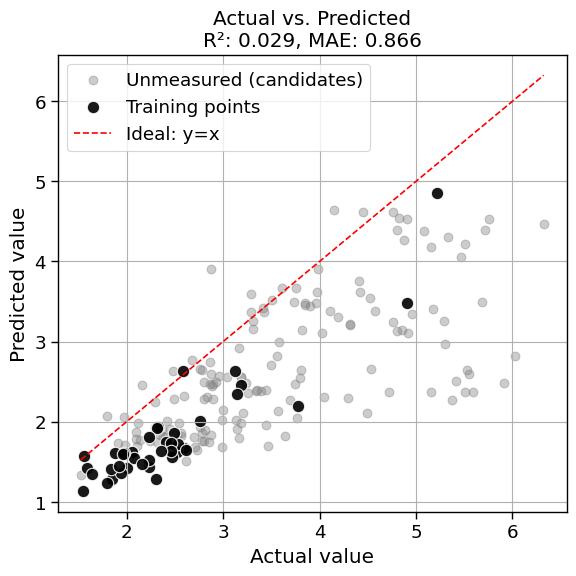

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 20.60000000000001, best_so_far: 1.5456

==== Iteration 99 ====
EI-based recommended label: [7, 2, 4]


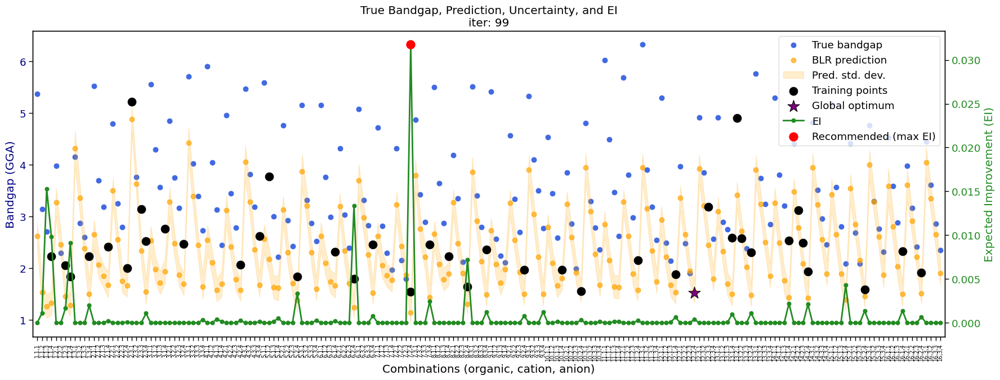

R² score: -0.0547
MAE: 0.9412


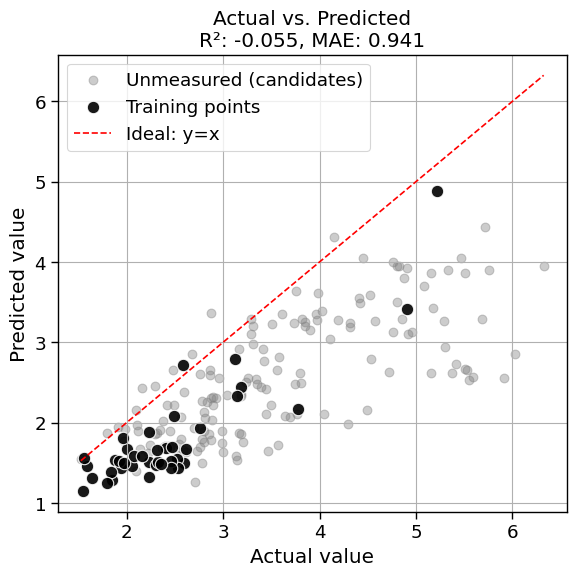

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 20.70000000000001, best_so_far: 1.5456

==== Iteration 100 ====
EI-based recommended label: [7, 2, 4]


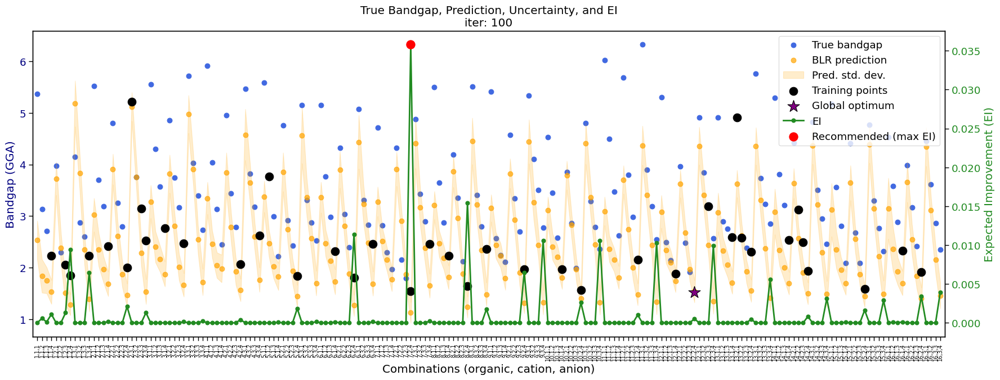

R² score: 0.2486
MAE: 0.7856


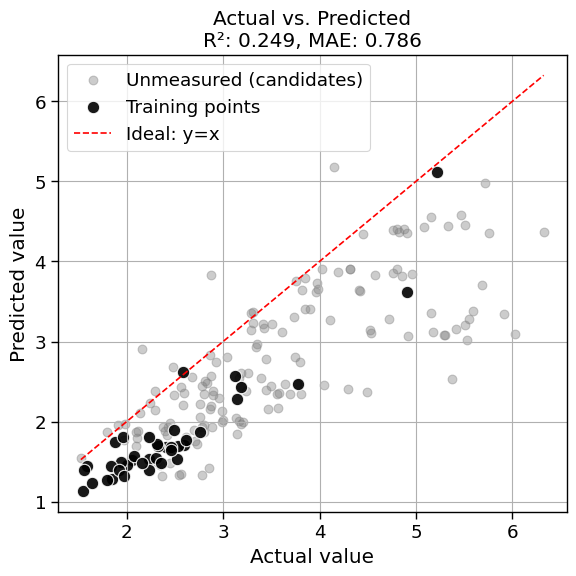

Measurement: 1.0257 (fidelity=0.1)
Cumulative cost: 20.80000000000001, best_so_far: 1.5456


In [68]:
from scipy.stats import norm
import time

import matplotlib.pyplot as plt
init_samples = sample_param_space(param_space, NUM_INIT_DESIGN, random_state=42)
init_fids = assign_fidelities(NUM_INIT_DESIGN, high_ratio=0.2, random_state=42)
measurements = []
for params, s in zip(init_samples, init_fids):
    measurement = measure_from_label(
        [label_maps['organic'][params['organic']],
         label_maps['cation'][params['cation']],
         label_maps['anion'][params['anion']]],
        s, label_maps, LOOKUP
    )
    measurements.append({"params": params, "s": s, "measurement": measurement})

# 데이터프레임 변환 및 라벨 적용
df = pd.DataFrame([
    {**obs['params'], 's': obs['s'], 'measurement': obs['measurement']}
    for obs in measurements
])
for col in ['organic', 'cation', 'anion']:
    df[col + '_label'] = df[col].map(label_maps[col])

ini_X = df[['organic_label', 'cation_label', 'anion_label', 's']].values
ini_y = df['measurement'].values

# s 값에 따라 분할 (X에서 s를 제거)
ini_X_low = ini_X[df['s'] == 0.1][:, :3]
ini_y_low = ini_y[df['s'] == 0.1]
ini_X_high = ini_X[df['s'] == 1.0][:, :3]
ini_y_high = ini_y[df['s'] == 1.0]

param_ranges = [
    range(1, 17),  # organic_label: 1~16
    range(1, 4),   # cation_label: 1~3
    range(1, 5),   # anion_label: 1~4
]

min_hse06_bandgap = 1.5249
COST_BUDGET = 50


timing_data = []
cost_data = []
best_so_far_curve = []
total_cost = 0.0
best_so_far = np.inf
# N_ITER = 10 # 원하는 반복 횟수
iter_ = 0
all_results = []

cumulative_cost_list = []
for _ in range(100):
    while total_cost < COST_BUDGET:
    # for iter_ in range(N_ITER):
        iter_ += 1
        print(f"\n==== Iteration {iter_} ====")
        iter_start = time.time()   # ★★★ 타이밍 시작
        
        model = TransferLearningDNN(input_dim=3, hidden_dim=64, device='cpu')
        if len(ini_X_low) > 0:
            model.pretrain(ini_X_low, ini_y_low, epochs=100, lr=1e-3, verbose=False)
        if len(ini_X_high) > 0:
            model.finetune(ini_X_high, ini_y_high, epochs=50, lr=1e-3, verbose=False)
        
        # BLR 학습
        X_all = np.vstack([ini_X_low, ini_X_high])
        y_all = np.concatenate([ini_y_low, ini_y_high])
        features_all = model.extract_features(X_all)
        blr = BayesianLinearRegression(alpha=1.0, beta=25.0)
        blr.fit(features_all, y_all)
        
        # (2) 전체 조합 생성 (192개)
        all_combinations = list(itertools.product(*param_ranges))  # shape=(192, 3)
        X_grid = np.array(all_combinations, dtype=np.float32)
        features_grid = model.extract_features(X_grid)


        # (3) BLR 예측 및 EI 계산
        y_pred = []
        y_std = []
        for phi in features_grid:
            mu, var = blr.predict(phi)
            y_pred.append(mu)
            y_std.append(np.sqrt(var))
        y_pred = np.array(y_pred)
        y_std = np.array(y_std)
        
        y_best = np.min(y_all)
        
        ei = penalized_expected_improvement(y_pred, y_std, y_best)
        best_idx = np.argmax(ei)
        next_x_label = list(X_grid[best_idx].astype(int))
        print("EI-based recommended label:", next_x_label)

        ori_gga_data['y_pred'] = y_pred
        ori_gga_data['y_std'] = y_std   # 분산도 마찬가지로 추가!
        
        # 학습에 사용된 조합 set 만들기 (int 변환!)
        train_combo_set = set(tuple(map(int, row)) for row in np.vstack([ini_X_low, ini_X_high]))

        # 전체 192개 조합 중 학습에 쓰인 인덱스 찾기
        train_indices = [i for i, combo in enumerate(X_grid.astype(int)) if tuple(combo) in train_combo_set]


        # ori_gga_data, y_pred, y_std, ei 등 위에서처럼 준비됐다고 가정

        fig, ax1 = plt.subplots(figsize=(18, 7))
        x_idx = range(len(ori_gga_data))

        # True / 예측 / Uncertainty
        ax1.scatter(x_idx, ori_gga_data['bandgap'], s=40, label='True bandgap', color='royalblue')
        ax1.scatter(x_idx, ori_gga_data['y_pred'], s=40, label='BLR prediction', color='orange', alpha=0.7)
        ax1.fill_between(
            x_idx,
            ori_gga_data['y_pred'] - ori_gga_data['y_std'],
            ori_gga_data['y_pred'] + ori_gga_data['y_std'],
            color='orange', alpha=0.2, label='Pred. std. dev.'
        )
        # 학습 포인트(누적) 검정색으로!
        ax1.scatter(
            train_indices, ori_gga_data['bandgap'].iloc[train_indices],
            s=110, color='black', label='Training points', zorder=10, marker='o'
        )

        # === Global optimal 별표 ===
        optimal_combo = '12,2,4'
        optimal_idx = ori_gga_data.index[ori_gga_data['combo'] == optimal_combo].tolist()[0]
        optimal_bandgap = ori_gga_data.loc[optimal_idx, 'bandgap']
        ax1.scatter(
            optimal_idx, optimal_bandgap,
            marker='*', color='purple', s=250, edgecolor='black',
            label='Global optimum', zorder=20
        )

        ax1.set_ylabel('Bandgap (GGA)', color='navy')
        ax1.set_xlabel('Combinations (organic, cation, anion)')
        ax1.set_xticks(x_idx)
        ax1.set_xticklabels(ori_gga_data['combo'], rotation=90, fontsize=7)
        ax1.set_title(f'True Bandgap, Prediction, Uncertainty, and EI\niter: {iter_}')
        ax1.tick_params(axis='y', labelcolor='navy')

        # EI 오른쪽축
        ax2 = ax1.twinx()
        ax2.plot(x_idx, ei, marker='o', color='forestgreen', label='EI', linewidth=2)
        ax2.scatter(best_idx, ei[best_idx], color='red', s=120, zorder=15, label='Recommended (max EI)')
        ax2.set_ylabel('Expected Improvement (EI)', color='forestgreen')
        ax2.tick_params(axis='y', labelcolor='forestgreen')

        # 범례
        h1, l1 = ax1.get_legend_handles_labels()
        h2, l2 = ax2.get_legend_handles_labels()
        ax1.legend(h1+h2, l1+l2, loc='upper right')

        plt.xlim(-1, len(ori_gga_data))
        plt.tight_layout()
        plt.show()


        # 실제값과 예측값
        # y_true = ori_gga_data['bandgap'].values
        # y_pred = ori_gga_data['y_pred'].values

        # # R², MAE 계산
        # r2 = r2_score(y_true, y_pred)
        # mae = mean_absolute_error(y_true, y_pred)

        # print(f"R² score: {r2:.4f}")
        # print(f"MAE: {mae:.4f}")
        
        # y_true = ori_gga_data['bandgap'].values
        # y_pred = ori_gga_data['y_pred'].values

        # # 2. 학습 데이터 인덱스
        # train_indices = set([i for i, combo in enumerate(X_grid.astype(int)) if tuple(combo) in train_combo_set])
        # all_indices = set(range(len(y_true)))
        # non_train_indices = all_indices - train_indices

        # # 3. 산점도
        # plt.figure(figsize=(6, 6))
        # # (1) 비학습 데이터 (연한색)
        # plt.scatter(
        #     y_true[list(non_train_indices)], y_pred[list(non_train_indices)],
        #     alpha=0.4, s=40, color='grey', label='Unmeasured (candidates)'
        # )
        # # (2) 학습 데이터 (진한색)
        # plt.scatter(
        #     y_true[list(train_indices)], y_pred[list(train_indices)],
        #     alpha=0.9, s=80, color='black', label='Training points', edgecolor='w'
        # )
        # # (3) 기준선
        # plt.plot([min(y_true), max(y_true)], [min(y_true), max(y_true)], 'r--', label='Ideal: y=x')

        # plt.xlabel('Actual value')
        # plt.ylabel('Predicted value')
        # plt.title(f'Actual vs. Predicted\nR²: {r2:.3f}, MAE: {mae:.3f}')
        # plt.legend()
        # plt.grid(True)
        # plt.tight_layout()
        # plt.show()



        # (4) Fidelity 할당 (예시: 8:1)
        s = 0.1 if (iter_ % 8 != 0) else 1.0
        # (5) 측정 및 데이터 추가
        measurement = measure_from_label(next_x_label, s, label_maps, LOOKUP)
        ini_X_low, ini_y_low, ini_X_high, ini_y_high = append_measurement_to_data(
            ini_X_low, ini_y_low, ini_X_high, ini_y_high,
            next_x_label, s, label_maps, LOOKUP
        )
        print(f"Measurement: {measurement:.4f} (fidelity={s})")
        
        iter_end = time.time()
        time_taken = iter_end - iter_start
        timing_data.append([0, iter_, time_taken])
        total_cost += s
        cost_data.append([0, iter_, total_cost])
        
        # best-so-far 기록
        if s == 1:
            if measurement < best_so_far:
                best_so_far = measurement
        best_so_far_curve.append([0, iter_, s, best_so_far])
        print(f"Cumulative cost: {total_cost}, best_so_far: {best_so_far}")
        if s == 1.0 and np.isclose(measurement, min_hse06_bandgap, atol=1e-6):
            print('found the min hse06 bandgap!')
            break

        break
    cumulative_cost_list.append(total_cost)


# 전체 타이밍 데이터 저장
# timing_df = pd.DataFrame(timing_data, columns=['run_ix', 'iter', 'time_taken'])
# timing_df.to_csv('TL_timing_results.csv', index=False)

# # 누적 실험비용 저장
# cost_df = pd.DataFrame(cost_data, columns=['run_ix', 'iter', 'cumulative_cost'])
# cost_df.to_csv('TL_cumulative_cost.csv', index=False)

# # best-so-far curve 저장 (regret curve)
# best_so_far_df = pd.DataFrame(best_so_far_curve, columns=['run_ix', 'iter', 's', 'best_so_far'])
# best_so_far_df.to_csv('TL_best_so_far_curve.csv', index=False)

# df_results = pd.DataFrame(all_results)
# df_results.to_csv("TL_all_iter_results.csv", index=False)

## Model analysis

[Pretrain] Epoch 50: Loss 2.7092
[Pretrain] Epoch 100: Loss 1.7838
[Pretrain] Epoch 150: Loss 1.1602
[Pretrain] Epoch 200: Loss 0.6228
[Pretrain] Epoch 250: Loss 0.3240
[Pretrain] Epoch 300: Loss 0.2160


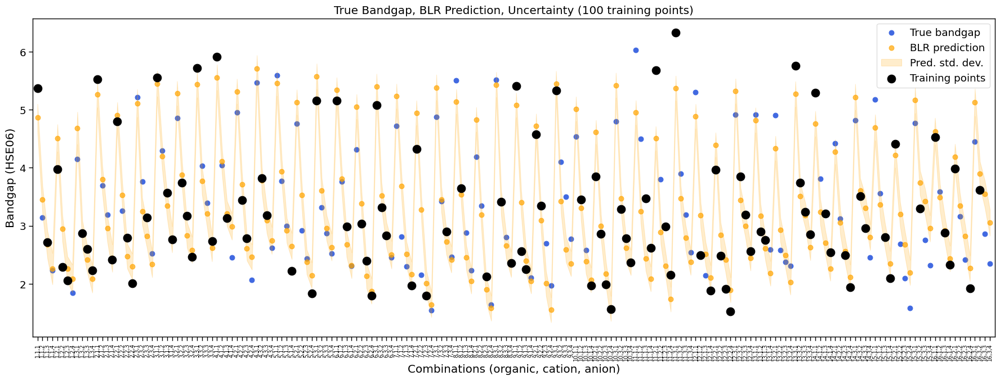

R² score: 0.8731
MAE: 0.3170


In [41]:
import numpy as np

# ori_gga_data: combo, bandgap가 있는 DataFrame
np.random.seed(42)  # 재현성

# 전체 조합 (192, 3)
all_combinations = list(itertools.product(*param_ranges))  # param_ranges는 [range(1,17), range(1,4), range(1,5)]
X_grid = np.array(all_combinations, dtype=np.float32)

# 랜덤 100개 추출
idx_sample = np.random.choice(len(ori_gga_data), size=100, replace=False)
ori_sample = ori_gga_data.iloc[idx_sample]

# (추출된 조합을 array 형태로 만들기)
X_train = np.array([list(map(int, combo.split(','))) for combo in ori_sample['combo']])
y_train = ori_sample['bandgap'].values
# DNN+BLR
model = TransferLearningDNN(input_dim=3, hidden_dim=64, device='cpu')
model.pretrain(X_train, y_train, epochs=300, lr=1e-3, verbose=True)
# high-fidelity 데이터만 쓸 경우 finetune 생략 가능

features_train = model.extract_features(X_train)
blr = BayesianLinearRegression(alpha=1.0, beta=25.0)
blr.fit(features_train, y_train)
features_grid = model.extract_features(X_grid)

y_pred = []
y_std = []
for phi in features_grid:
    mu, var = blr.predict(phi)
    y_pred.append(mu)
    y_std.append(np.sqrt(var))
y_pred = np.array(y_pred)
y_std = np.array(y_std)
features_grid = model.extract_features(X_grid)

y_pred = []
y_std = []
for phi in features_grid:
    mu, var = blr.predict(phi)
    y_pred.append(mu)
    y_std.append(np.sqrt(var))
y_pred = np.array(y_pred)
y_std = np.array(y_std)

ori_gga_data['y_pred'] = y_pred
ori_gga_data['y_std'] = y_std

plt.figure(figsize=(18, 7))
x_idx = range(len(ori_gga_data))

# True bandgap
plt.scatter(x_idx, ori_gga_data['bandgap'], s=40, label='True bandgap', color='royalblue')
# 예측값
plt.scatter(x_idx, ori_gga_data['y_pred'], s=40, label='BLR prediction', color='orange', alpha=0.7)
# 불확실성 범위
plt.fill_between(
    x_idx,
    ori_gga_data['y_pred'] - ori_gga_data['y_std'],
    ori_gga_data['y_pred'] + ori_gga_data['y_std'],
    color='orange', alpha=0.2, label='Pred. std. dev.'
)

# 학습에 사용된 100개 포인트 인덱스 (검정색)
train_indices = sorted(idx_sample)
plt.scatter(
    train_indices, ori_gga_data['bandgap'].iloc[train_indices],
    s=110, color='black', label='Training points', zorder=10, marker='o'
)

plt.ylabel('Bandgap (HSE06)')
plt.xlabel('Combinations (organic, cation, anion)')
plt.xticks(x_idx, ori_gga_data['combo'], rotation=90, fontsize=7)
plt.title('True Bandgap, BLR Prediction, Uncertainty (100 training points)')
plt.legend()
plt.xlim(-1, len(ori_gga_data))
plt.tight_layout()
plt.show()
from sklearn.metrics import r2_score, mean_absolute_error

# 실제값과 예측값
y_true = ori_gga_data['bandgap'].values
y_pred = ori_gga_data['y_pred'].values

# R², MAE 계산
r2 = r2_score(y_true, y_pred)
mae = mean_absolute_error(y_true, y_pred)

print(f"R² score: {r2:.4f}")
print(f"MAE: {mae:.4f}")


In [28]:
ini_X_low

array([[ 2.,  3.,  3.],
       [ 8.,  2.,  4.],
       [ 2.,  2.,  4.],
       [12.,  3.,  3.],
       [13.,  2.,  1.],
       [14.,  2.,  3.],
       [ 6.,  1.,  4.],
       [14.,  2.,  2.],
       [11.,  2.,  4.],
       [16.,  1.,  4.],
       [ 1.,  1.,  4.],
       [10.,  1.,  4.],
       [ 4.,  1.,  2.],
       [14.,  2.,  4.],
       [14.,  2.,  4.],
       [ 4.,  2.,  4.],
       [ 4.,  3.,  4.],
       [16.,  2.,  4.],
       [16.,  2.,  4.],
       [10.,  2.,  4.],
       [ 9.,  1.,  4.],
       [ 8.,  3.,  4.],
       [16.,  3.,  4.],
       [ 5.,  2.,  4.],
       [ 5.,  3.,  4.],
       [ 1.,  2.,  4.],
       [ 6.,  2.,  4.],
       [ 2.,  2.,  4.],
       [ 5.,  2.,  4.],
       [ 8.,  2.,  4.],
       [10.,  2.,  4.],
       [ 9.,  2.,  4.],
       [ 7.,  2.,  4.],
       [10.,  2.,  4.],
       [ 1.,  1.,  3.],
       [ 7.,  2.,  4.],
       [11.,  2.,  4.],
       [ 6.,  2.,  4.],
       [ 6.,  2.,  4.],
       [ 7.,  2.,  4.],
       [ 9.,  2.,  4.],
       [ 8.,  2.

In [38]:
import itertools
import numpy as np

# 파라미터 스페이스 정의
organics = param_space['organic']
cations = param_space['cation']
anions = param_space['anion']

all_combinations = list(itertools.product(organics, cations, anions))
print("총 경우의 수:", len(all_combinations))
X_full = []
for o, c, a in all_combinations:
    o_label = label_maps['organic'][o]
    c_label = label_maps['cation'][c]
    a_label = label_maps['anion'][a]
    X_full.append([o_label, c_label, a_label])
X_full = np.array(X_full, dtype=np.float32)
X_full


총 경우의 수: 192


array([[ 1.,  1.,  1.],
       [ 1.,  1.,  2.],
       [ 1.,  1.,  3.],
       [ 1.,  1.,  4.],
       [ 1.,  2.,  1.],
       [ 1.,  2.,  2.],
       [ 1.,  2.,  3.],
       [ 1.,  2.,  4.],
       [ 1.,  3.,  1.],
       [ 1.,  3.,  2.],
       [ 1.,  3.,  3.],
       [ 1.,  3.,  4.],
       [ 2.,  1.,  1.],
       [ 2.,  1.,  2.],
       [ 2.,  1.,  3.],
       [ 2.,  1.,  4.],
       [ 2.,  2.,  1.],
       [ 2.,  2.,  2.],
       [ 2.,  2.,  3.],
       [ 2.,  2.,  4.],
       [ 2.,  3.,  1.],
       [ 2.,  3.,  2.],
       [ 2.,  3.,  3.],
       [ 2.,  3.,  4.],
       [ 3.,  1.,  1.],
       [ 3.,  1.,  2.],
       [ 3.,  1.,  3.],
       [ 3.,  1.,  4.],
       [ 3.,  2.,  1.],
       [ 3.,  2.,  2.],
       [ 3.,  2.,  3.],
       [ 3.,  2.,  4.],
       [ 3.,  3.,  1.],
       [ 3.,  3.,  2.],
       [ 3.,  3.,  3.],
       [ 3.,  3.,  4.],
       [ 4.,  1.,  1.],
       [ 4.,  1.,  2.],
       [ 4.,  1.,  3.],
       [ 4.,  1.,  4.],
       [ 4.,  2.,  1.],
       [ 4.,  2.

In [43]:
reverse_label_maps = {
    key: {v: k for k, v in value.items()}
    for key, value in label_maps.items()
}
import pandas as pd

rows = []
for row in X_full:
    o_label, c_label, a_label = [int(x) for x in row]
    organic = reverse_label_maps['organic'][o_label]
    cation = reverse_label_maps['cation'][c_label]
    anion = reverse_label_maps['anion'][a_label]
    rows.append({
        'organic': organic,
        'cation': cation,
        'anion': anion,
        'organic_label': o_label,
        'cation_label': c_label,
        'anion_label': a_label
    })
df_X_full = pd.DataFrame(rows)
df_X_full.to_csv("X_full_with_labels.csv", index=False)
